# Wasserstein GAN with Gradient Penalty (WGAN-GP)

### Goals
In this notebook, you're going to build a Wasserstein GAN with Gradient Penalty (WGAN-GP) that solves some of the stability issues with the GANs that you have been using up until this point. Specifically, you'll use a special kind of loss function known as the W-loss, where W stands for Wasserstein, and gradient penalties to prevent mode collapse.

*Fun Fact: Wasserstein is named after a mathematician at Penn State, Leonid Vaseršteĭn. You'll see it abbreviated to W (e.g. WGAN, W-loss, W-distance).*

### Learning Objectives
1.   Get hands-on experience building a more stable GAN: Wasserstein GAN with Gradient Penalty (WGAN-GP).
2.   Train the more advanced WGAN-GP model.



## Generator and Critic

You will begin by importing some useful packages, defining visualization functions, building the generator, and building the critic. Since the changes for WGAN-GP are done to the loss function during training, you can simply reuse your previous GAN code for the generator and critic class. Remember that in WGAN-GP, you no longer use a discriminator that classifies fake and real as 0 and 1 but rather a critic that scores images with real numbers.

#### Packages and Visualizations

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0)

In [2]:
def show_tensor_images(image_tensor, num_images = 25, size = (1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of imagens, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''

    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrows = 5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

    return

In [3]:
def make_grad_hook():
    '''
    Function to keep track of gradients for visualization purposes,
    wich fills the grads list when using model.apply(grad_hook). 
    '''

    grads = []
    
    def grad_hook(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            grads.append(m.weight.grad)
    
    return grads, grad_hook

#### Generator and Noise

In [4]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels of the output image, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''

    def __init__(self, z_dim = 10, im_chan = 1, hidden_dim = 64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size = 4, stride = 1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size = 4, final_layer = True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size = 3, stride = 2, final_layer = False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''

        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, z_dim, device = 'cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    
    return torch.randn(n_samples, z_dim, device=device)

#### Critic

In [5]:
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels of the output image, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''

    def __init__(self, im_chan=1, hidden_dim=64):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer = True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size = 4, stride = 2, final_layer = False):
        '''
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''

        if not final_layer:
            return nn.Sequential(
                nn.utils.spectral_norm(nn.Conv2d(input_channels, output_channels, kernel_size, stride)),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace = True))
        else:
            return nn.Sequential(
                nn.utils.spectral_norm(nn.Conv2d(input_channels, output_channels, kernel_size, stride)))

    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

## Training Initializations
Now you can start putting it all together.
As usual, you will start by setting the parameters:
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   beta_1, beta_2: the momentum terms
  *   c_lambda: weight of the gradient penalty
  *   crit_repeats: number of times to update the critic per generator update - there are more details about this in the *Putting It All Together* section
  *   device: the device type

You will also load and transform the MNIST dataset to tensors.




In [6]:
n_epochs = 100
z_dim = 64
display_step = 50
batch_size = 128
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 5
device = 'cuda'

transform = transforms.Compose([transforms.ToTensor(), transforms.Normalize((0.5,), (0.5,))])

dataloader = DataLoader(
    MNIST('.', download = True, transform = transform),
    batch_size = batch_size,
    shuffle = True)

  0%|          | 0/9912422 [00:00<?, ?it/s]

Extracting ./MNIST/raw/train-images-idx3-ubyte.gz to ./MNIST/raw



  0%|          | 0/28881 [00:00<?, ?it/s]

Extracting ./MNIST/raw/train-labels-idx1-ubyte.gz to ./MNIST/raw



  0%|          | 0/1648877 [00:00<?, ?it/s]

Extracting ./MNIST/raw/t10k-images-idx3-ubyte.gz to ./MNIST/raw



  0%|          | 0/4542 [00:00<?, ?it/s]

Extracting ./MNIST/raw/t10k-labels-idx1-ubyte.gz to ./MNIST/raw



Then, you can initialize your generator, critic, and optimizers.

In [7]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr = lr, betas = (beta_1, beta_2))
crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr = lr, betas = (beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)


## Gradient Penalty
Calculating the gradient penalty can be broken into two functions: (1) compute the gradient with respect to the images and (2) compute the gradient penalty given the gradient.

You can start by getting the gradient. The gradient is computed by first creating a mixed image. This is done by weighing the fake and real image using epsilon and then adding them together. Once you have the intermediate image, you can get the critic's output on the image. Finally, you compute the gradient of the critic score's on the mixed images (output) with respect to the pixels of the mixed images (input). You will need to fill in the code to get the gradient wherever you see *None*. There is a test function in the next block for you to test your solution.

In [8]:
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''

    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs = mixed_images,
        outputs = mixed_scores,
        # These other parameters have to do with the pytorch autograd engine works
        grad_outputs = torch.ones_like(mixed_scores), 
        create_graph = True,
        retain_graph = True)[0]
    
    return gradient


The second function you need to complete is to compute the gradient penalty given the gradient. First, you calculate the magnitude of each image's gradient. The magnitude of a gradient is also called the norm. Then, you calculate the penalty by squaring the distance between each magnitude and the ideal norm of 1 and taking the mean of all the squared distances.

Again, you will need to fill in the code wherever you see *None*. There are hints below that you can view if you need help and there is a test function in the next block for you to test your solution.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">gradient_penalty</font></code></b>
</font>
</summary>


1.   Make sure you take the mean at the end.
2.   Note that the magnitude of each gradient has already been calculated for you.

</details>


In [9]:
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    
    # Penalize the mean squared distance of the gradient norms from 1
    penalty = torch.mean((gradient_norm - 1) ** 2)
   
    return penalty

## Losses
Next, you need to calculate the loss for the generator and the critic.

For the generator, the loss is calculated by maximizing the critic's prediction on the generator's fake images. The argument has the scores for all fake images in the batch, but you will use the mean of them.

There are optional hints below and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_gen_loss</font></code></b></font></summary>

1. This can be written in one line.
2. This is the negative of the mean of the critic's scores.

</details>

In [10]:
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    '''
    
    gen_loss = -1. * torch.mean(crit_fake_pred)
   
    return gen_loss

For the critic, the loss is calculated by maximizing the distance between the critic's predictions on the real images and the predictions on the fake images while also adding a gradient penalty. The gradient penalty is weighed according to lambda. The arguments are the scores for all the images in the batch, and you will use the mean of them.

There are hints below if you get stuck and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_crit_loss</font></code></b></font></summary>

1. The higher the mean fake score, the higher the critic's loss is.
2. What does this suggest about the mean real score?
3. The higher the gradient penalty, the higher the critic's loss is, proportional to lambda.


</details>


In [11]:
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''

    crit_loss = torch.mean(crit_fake_pred) - torch.mean(crit_real_pred) + c_lambda * gp

    return crit_loss

## Putting It All Together
Before you put everything together, there are a few things to note.
1.   Even on GPU, the **training will run more slowly** than previous labs because the gradient penalty requires you to compute the gradient of a gradient -- this means potentially a few minutes per epoch! For best results, run this for as long as you can while on GPU.
2.   One important difference from earlier versions is that you will **update the critic multiple times** every time you update the generator This helps prevent the generator from overpowering the critic. Sometimes, you might see the reverse, with the generator updated more times than the critic. This depends on architectural (e.g. the depth and width of the network) and algorithmic choices (e.g. which loss you're using). 
3.   WGAN-GP isn't necessarily meant to improve overall performance of a GAN, but just **increases stability** and avoids mode collapse. In general, a WGAN will be able to train in a much more stable way than the vanilla DCGAN from last assignment, though it will generally run a bit slower. You should also be able to train your model for more epochs without it collapsing.


<!-- Once again, be warned that this runs very slowly on a CPU. One way to run this more quickly is to download the .ipynb and upload it to Google Drive, then open it with Google Colab and make the runtime type GPU and replace
`device = "cpu"`
with
`device = "cuda"`
and make sure that your `get_noise` function uses the right device.  -->

Here is a snapshot of what your WGAN-GP outputs should resemble:
![MNIST Digits Progression](Images/mnist-wgan-progression.png)

  0%|          | 0/469 [00:00<?, ?it/s]

Step 50: Generator loss: -0.3663202252984047, critic loss: 1.947695321321487


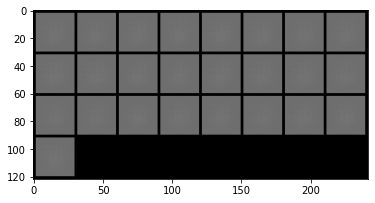

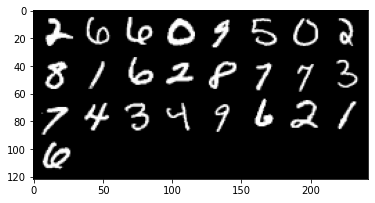

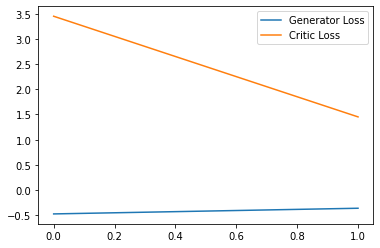

Step 100: Generator loss: 0.8700402654334902, critic loss: -1.2990152243375777


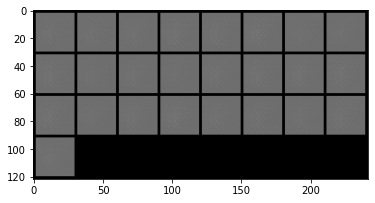

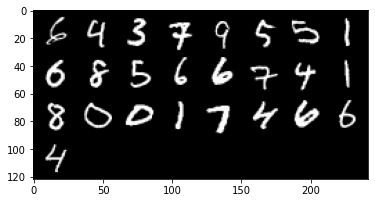

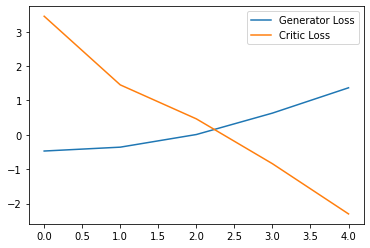

Step 150: Generator loss: 1.2864146876335143, critic loss: -3.3804806032180785


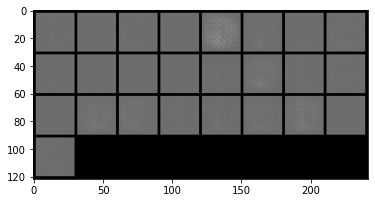

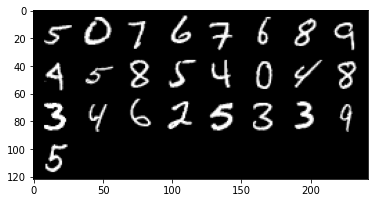

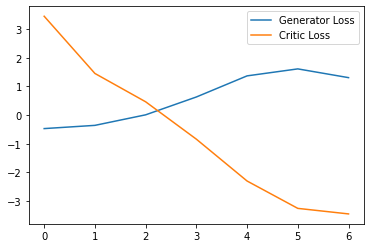

Step 200: Generator loss: -0.012104750610888004, critic loss: -3.7538050556182867


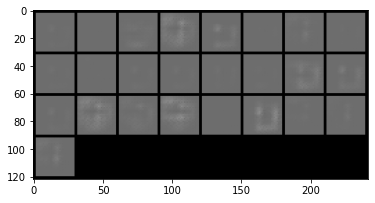

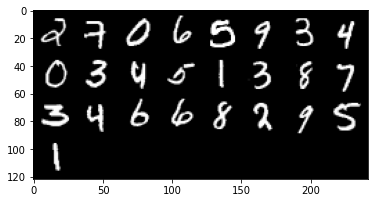

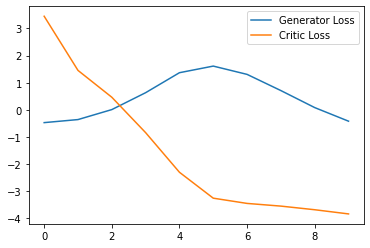

Step 250: Generator loss: -0.2003113403916359, critic loss: -4.775707000732422


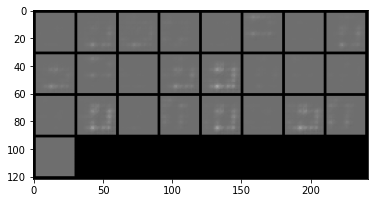

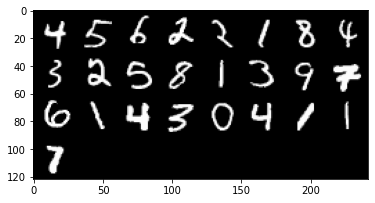

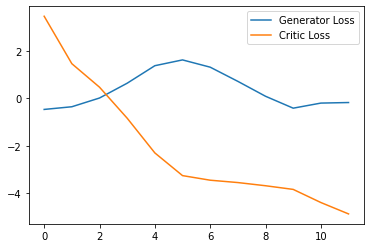

Step 300: Generator loss: -0.3952126106619835, critic loss: -6.109083917617798


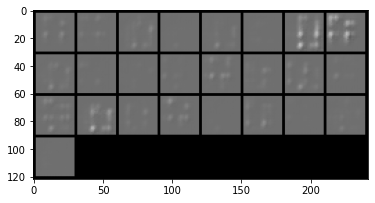

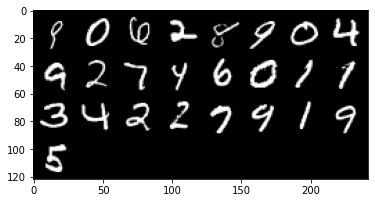

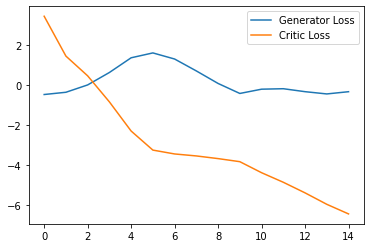

Step 350: Generator loss: 0.03145495142787695, critic loss: -7.679061624526977


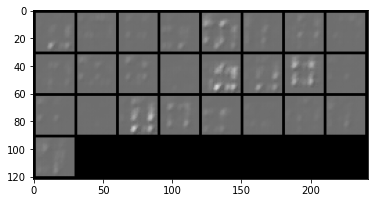

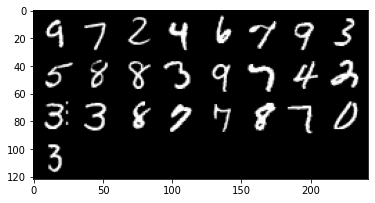

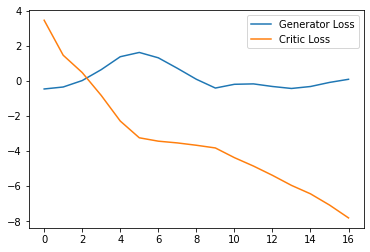

Step 400: Generator loss: 0.1808906512707472, critic loss: -9.49275380706787


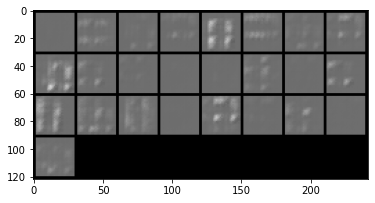

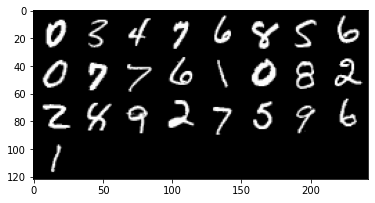

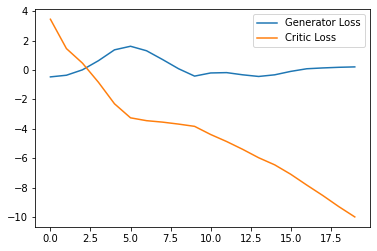

Step 450: Generator loss: 0.30983446031808853, critic loss: -11.207677173614503


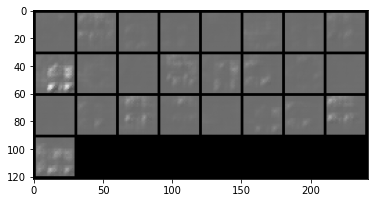

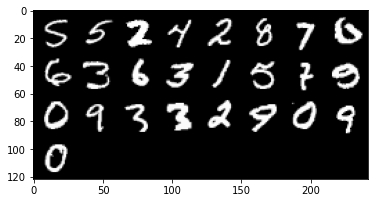

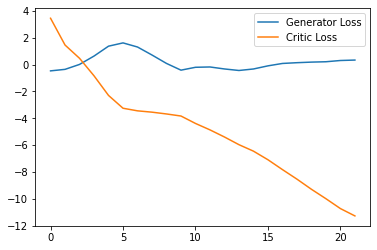

  0%|          | 0/469 [00:00<?, ?it/s]

Step 500: Generator loss: 0.32213917165994643, critic loss: -12.975445568084716


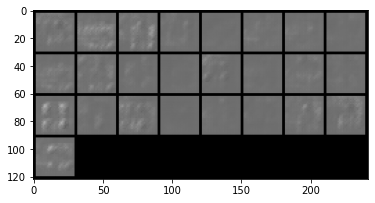

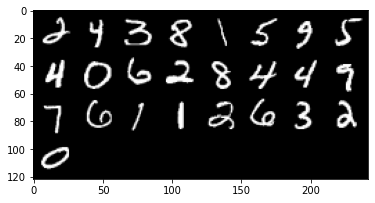

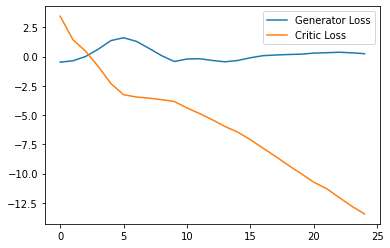

Step 550: Generator loss: 0.43692298293113707, critic loss: -14.706655490875242


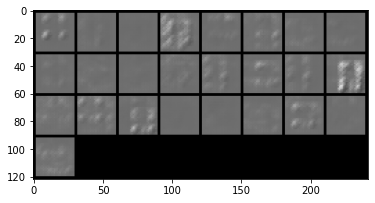

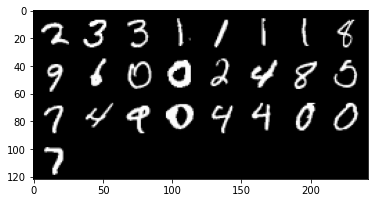

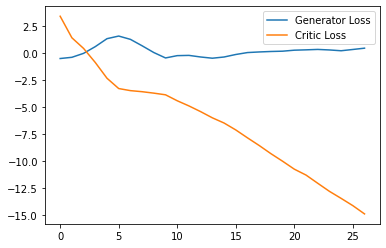

Step 600: Generator loss: 0.4806610497832298, critic loss: -16.55443553161621


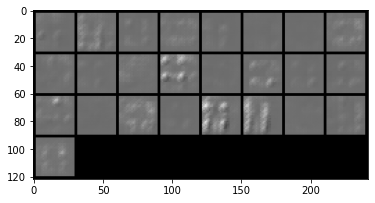

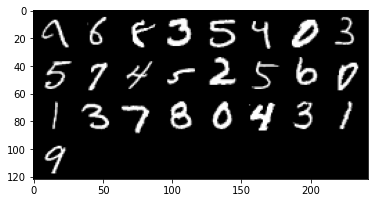

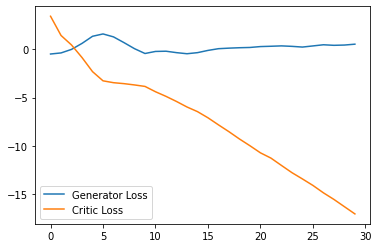

Step 650: Generator loss: 0.4571563291549683, critic loss: -18.413735588073724


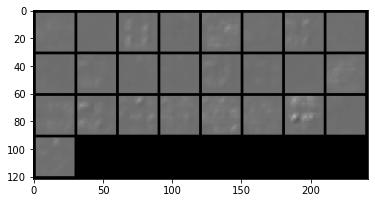

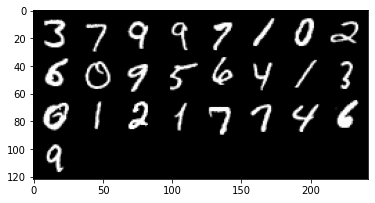

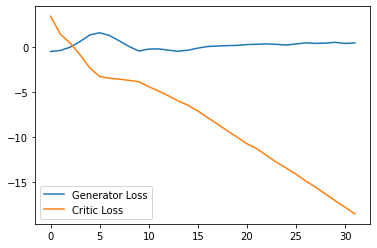

Step 700: Generator loss: 0.4728198862075806, critic loss: -20.188790473937992


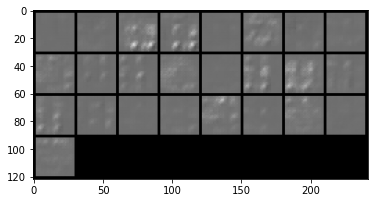

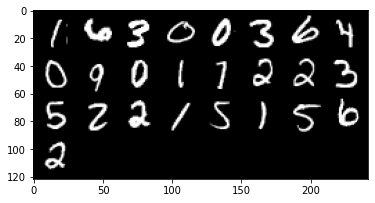

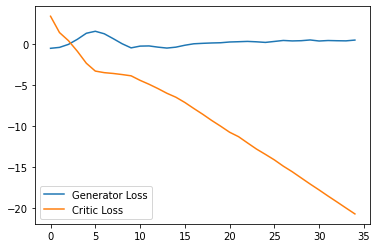

Step 750: Generator loss: 0.5994582140445709, critic loss: -22.131071517944328


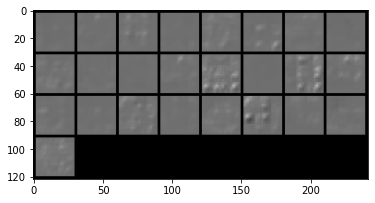

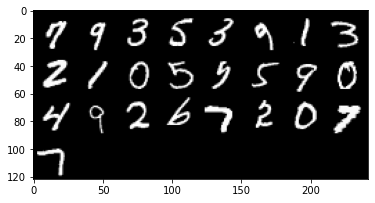

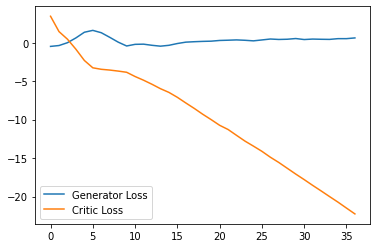

Step 800: Generator loss: 0.7053578615188598, critic loss: -23.87882099914551


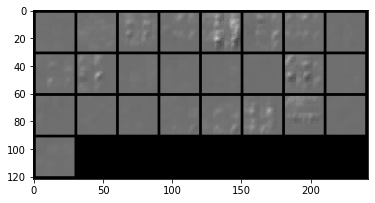

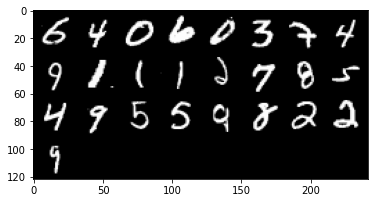

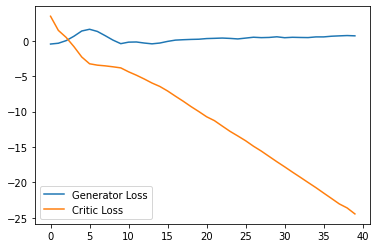

Step 850: Generator loss: 0.7660678714513779, critic loss: -25.74336972808838


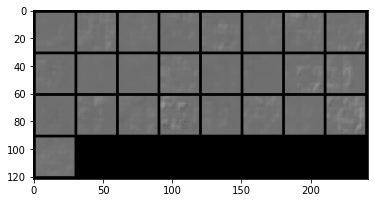

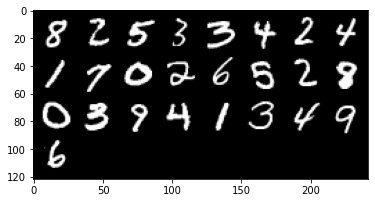

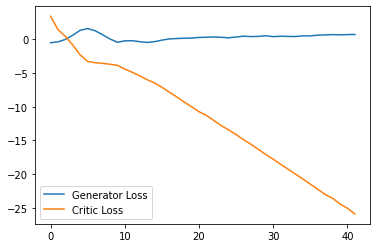

Step 900: Generator loss: 1.1004699957370758, critic loss: -27.537564865112305


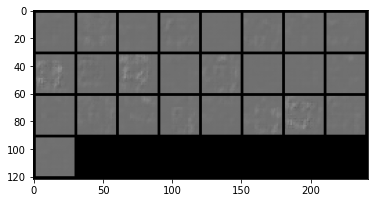

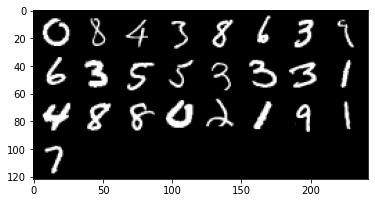

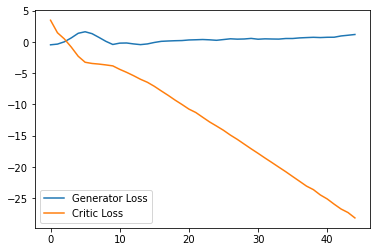

  0%|          | 0/469 [00:00<?, ?it/s]

Step 950: Generator loss: 1.3014225125312806, critic loss: -29.48541468811035


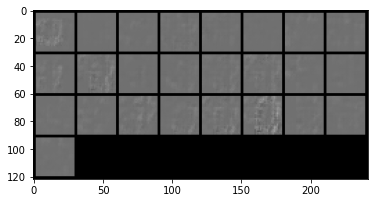

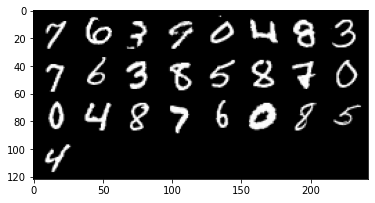

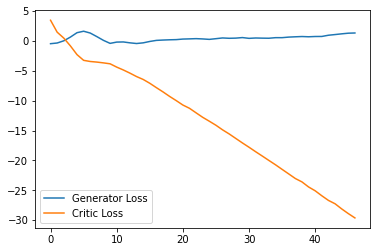

Step 1000: Generator loss: 1.3006186628341674, critic loss: -31.407708999633797


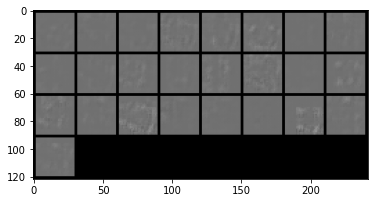

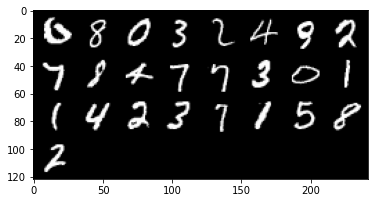

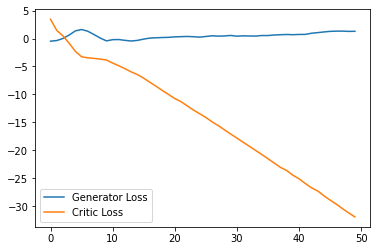

Step 1050: Generator loss: 1.3947051453590393, critic loss: -33.347583297729486


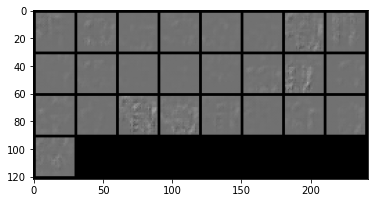

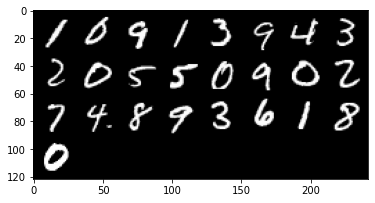

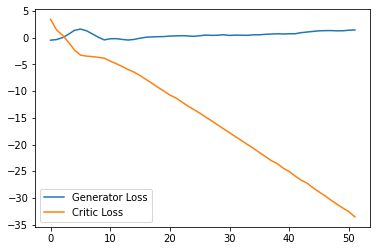

Step 1100: Generator loss: 1.3068657767772676, critic loss: -35.15414556884766


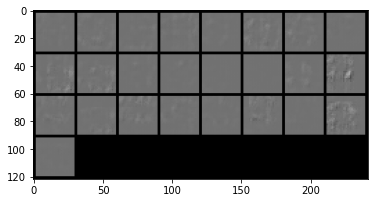

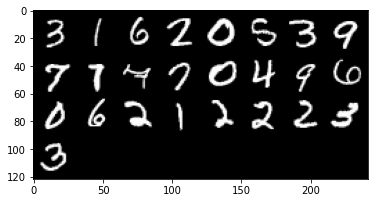

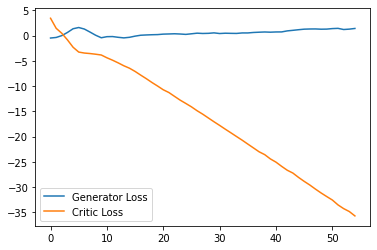

Step 1150: Generator loss: 1.4678572154045104, critic loss: -36.80119358062745


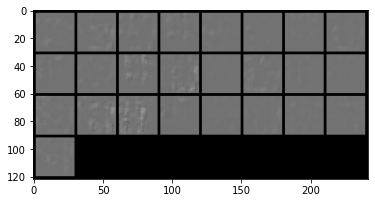

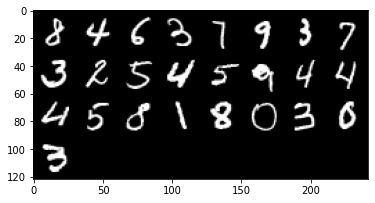

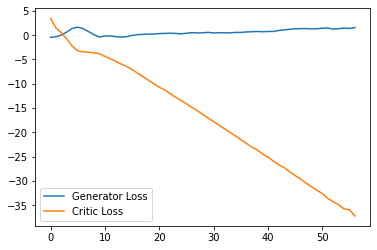

Step 1200: Generator loss: 1.613395745754242, critic loss: -39.165986587524415


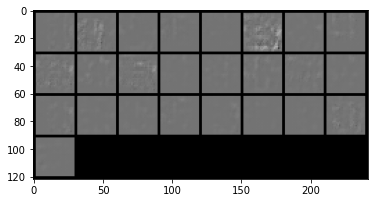

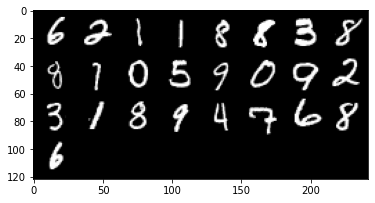

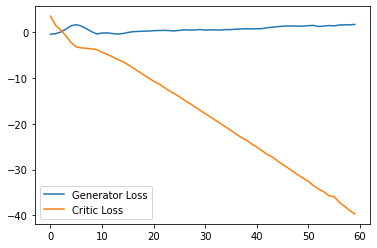

Step 1250: Generator loss: 1.6817229533195495, critic loss: -40.94481431579589


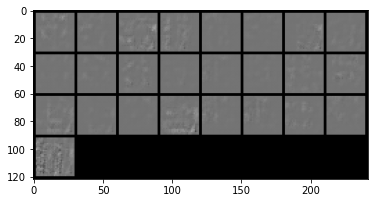

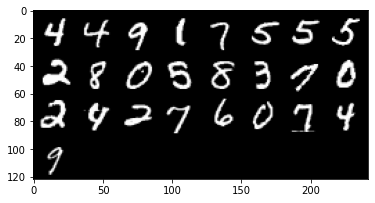

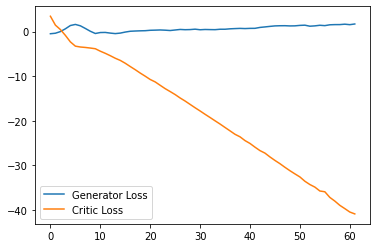

Step 1300: Generator loss: 1.750216670036316, critic loss: -42.93559036254882


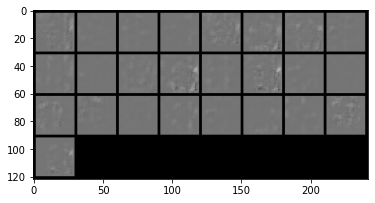

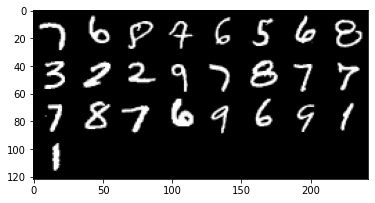

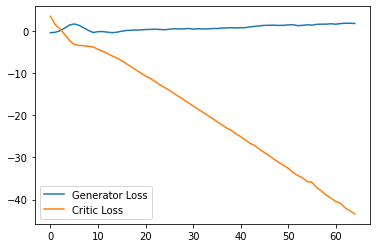

Step 1350: Generator loss: 1.6593259930610658, critic loss: -44.98002316284179


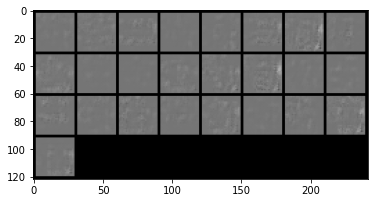

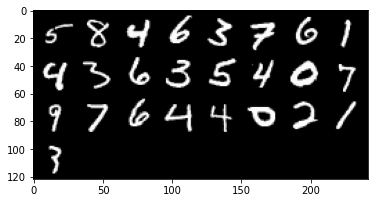

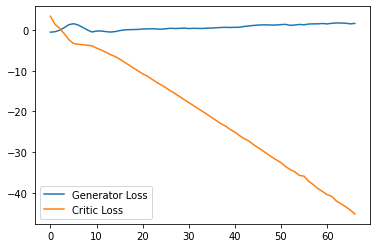

Step 1400: Generator loss: 1.6989619207382203, critic loss: -46.6272791595459


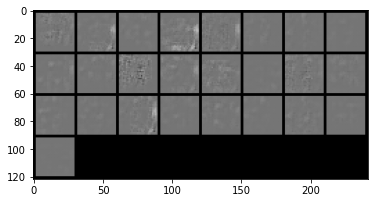

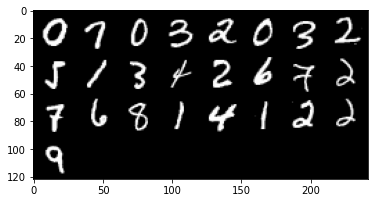

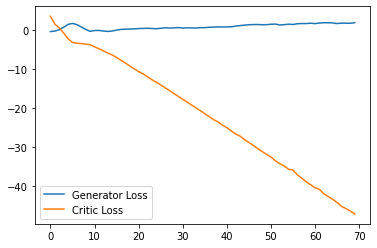

  0%|          | 0/469 [00:00<?, ?it/s]

Step 1450: Generator loss: 1.7994839644432068, critic loss: -48.56885426330567


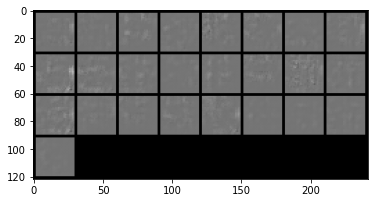

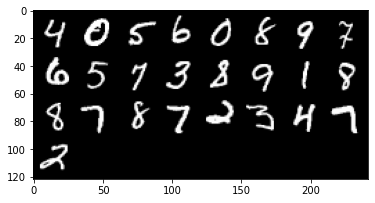

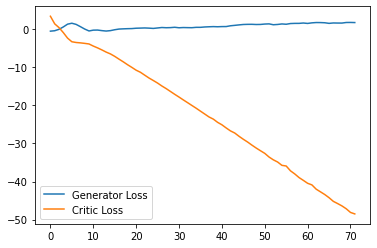

Step 1500: Generator loss: 1.964335148334503, critic loss: -50.266513610839844


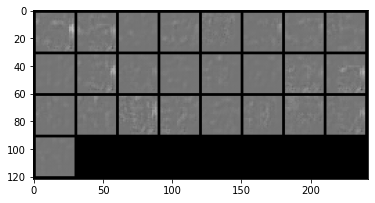

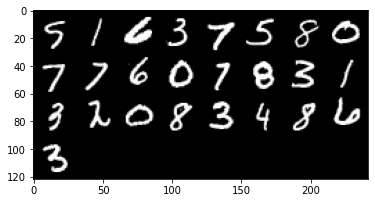

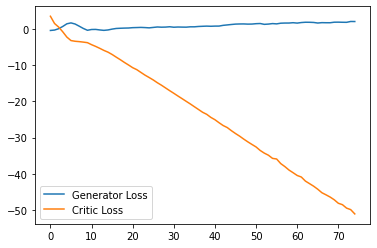

Step 1550: Generator loss: 1.978634169101715, critic loss: -51.889073608398434


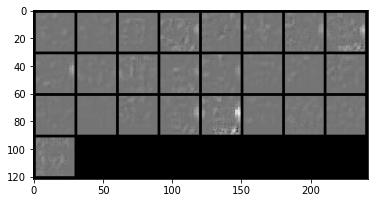

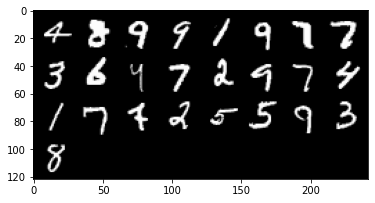

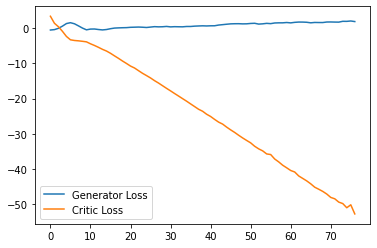

Step 1600: Generator loss: 2.070277814865112, critic loss: -54.2138065338135


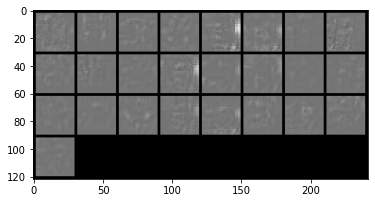

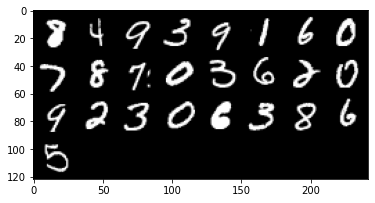

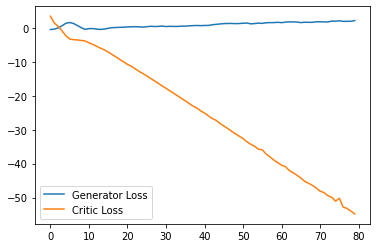

Step 1650: Generator loss: 2.1094014644622803, critic loss: -55.81309092712403


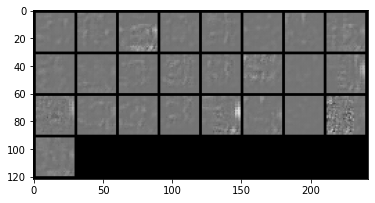

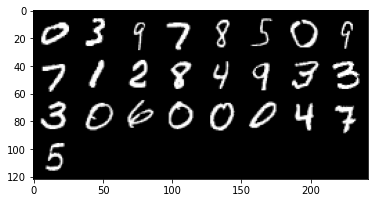

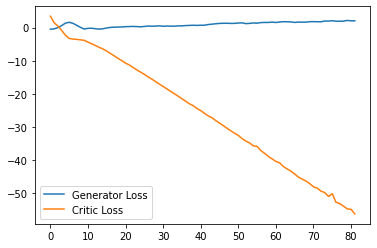

Step 1700: Generator loss: 2.1457436418533327, critic loss: -57.62586067199706


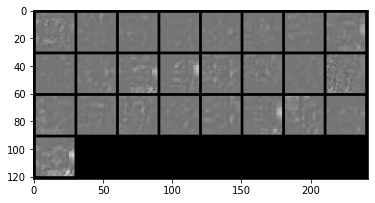

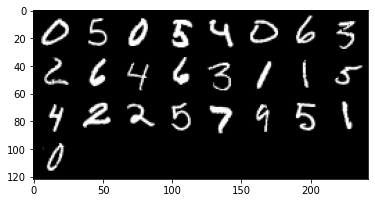

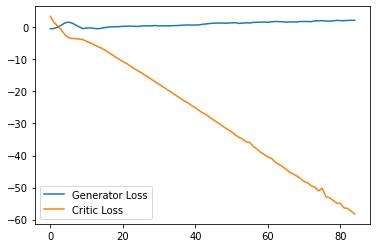

Step 1750: Generator loss: 2.2144184708595276, critic loss: -59.384234802246084


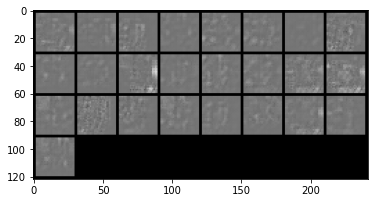

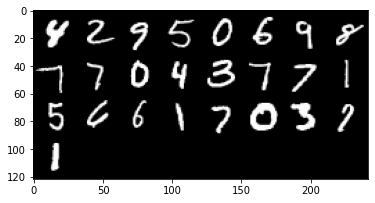

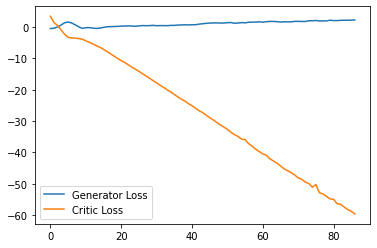

Step 1800: Generator loss: 2.316844816207886, critic loss: -61.25833175659178


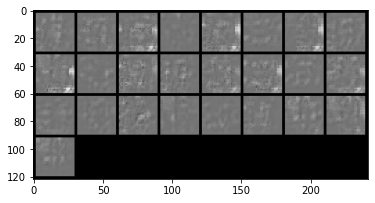

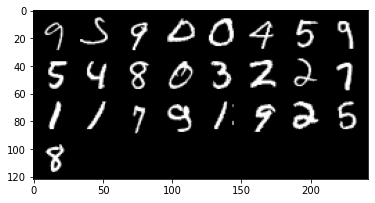

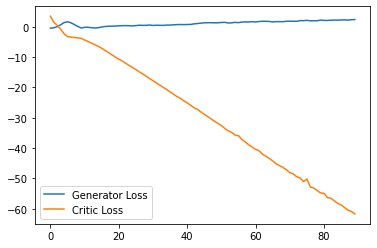

Step 1850: Generator loss: 2.3685750150680542, critic loss: -63.222448654174805


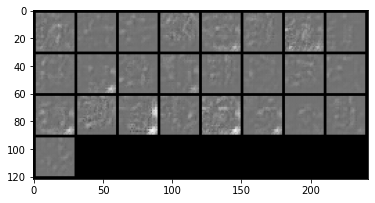

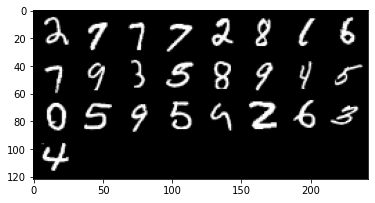

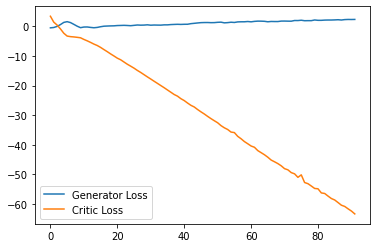

  0%|          | 0/469 [00:00<?, ?it/s]

Step 1900: Generator loss: 2.022760360240936, critic loss: -64.71693423461915


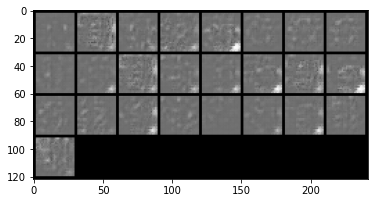

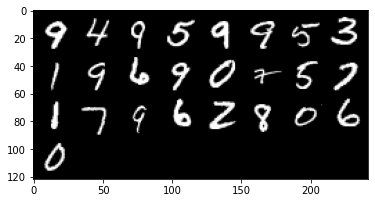

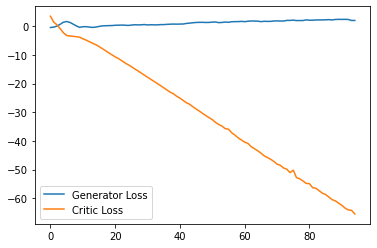

Step 1950: Generator loss: 2.1742657375335694, critic loss: -66.42211590576171


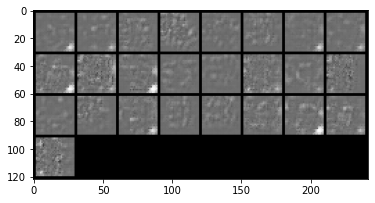

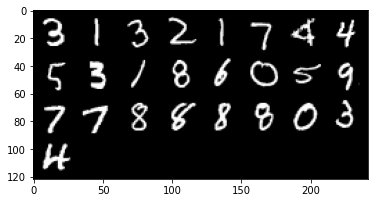

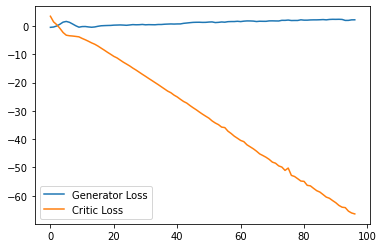

Step 2000: Generator loss: 2.3860395979881286, critic loss: -68.13014065551758


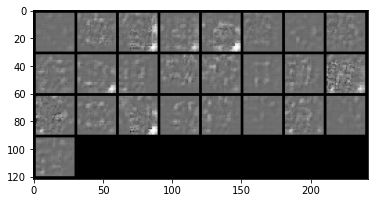

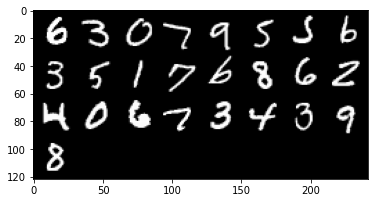

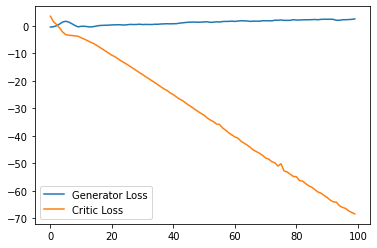

Step 2050: Generator loss: 2.454675064086914, critic loss: -69.85564138793944


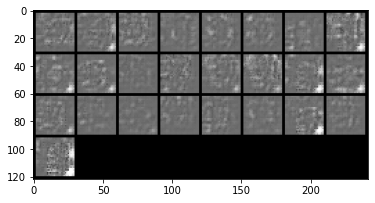

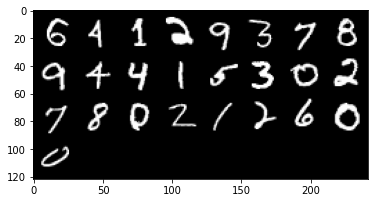

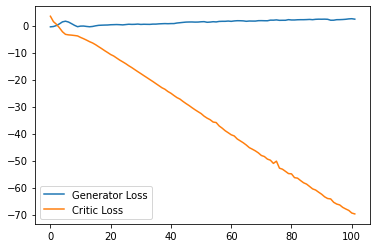

Step 2100: Generator loss: 2.507542386054993, critic loss: -71.38911222839356


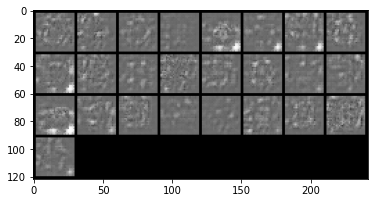

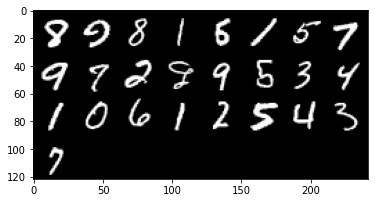

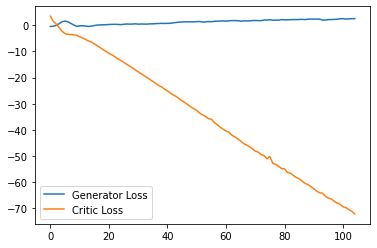

Step 2150: Generator loss: 2.591059756278992, critic loss: -72.9999859466553


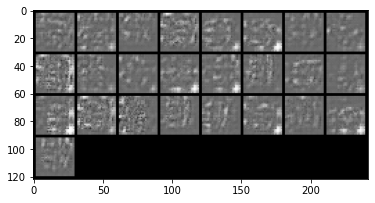

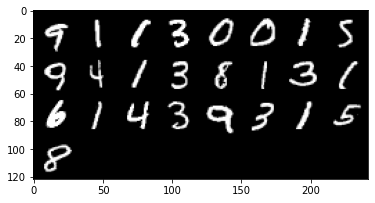

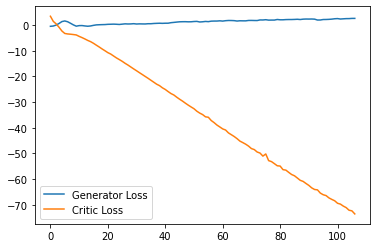

Step 2200: Generator loss: 2.523163559436798, critic loss: -74.3517585144043


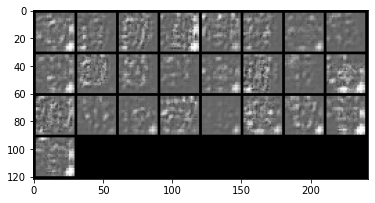

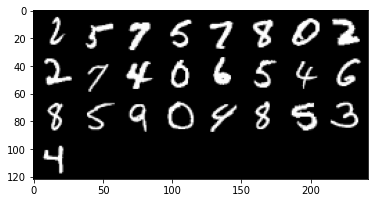

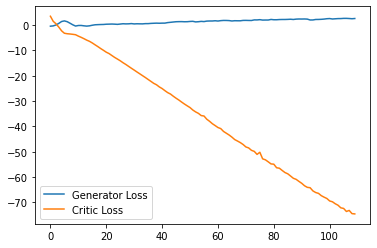

Step 2250: Generator loss: 2.3361381125450134, critic loss: -74.72537452697753


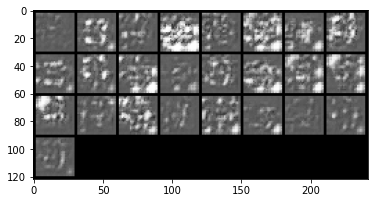

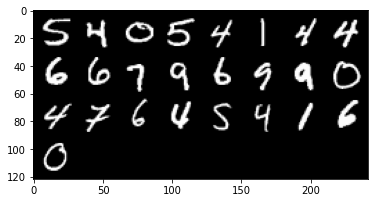

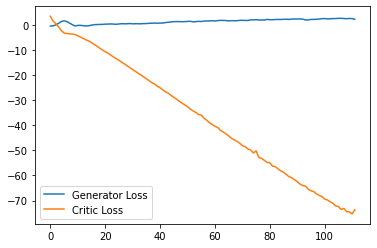

Step 2300: Generator loss: 0.29749697357416155, critic loss: -65.42433831024168


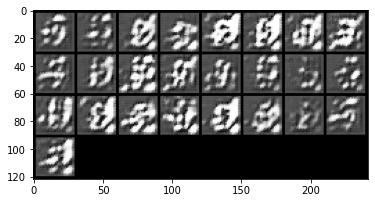

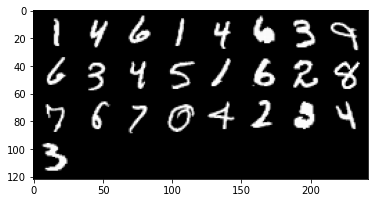

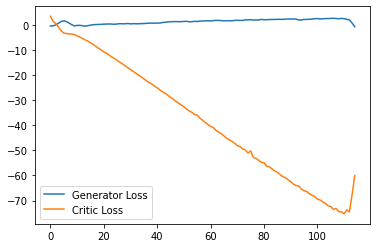

  0%|          | 0/469 [00:00<?, ?it/s]

Step 2350: Generator loss: -2.632348235100508, critic loss: -47.2936489944458


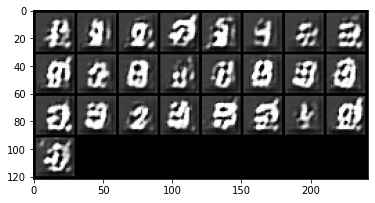

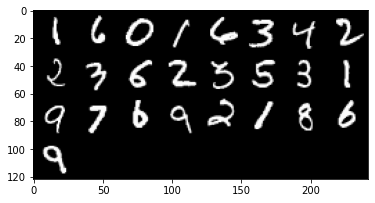

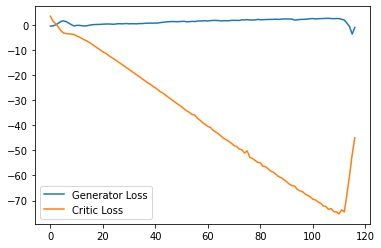

Step 2400: Generator loss: -2.5696643790602685, critic loss: -35.3142569732666


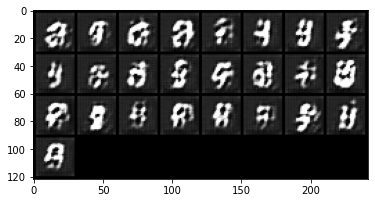

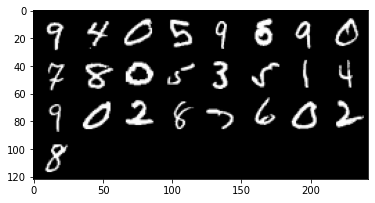

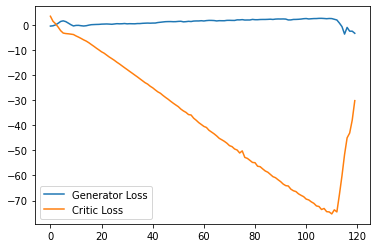

Step 2450: Generator loss: 1.282596800327301, critic loss: -11.430292895317077


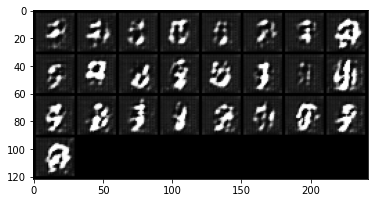

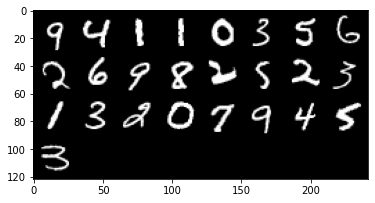

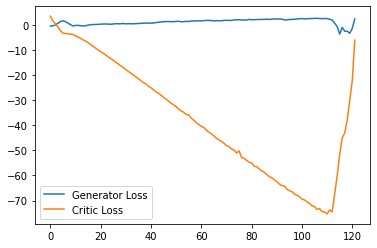

Step 2500: Generator loss: 0.5834816401451826, critic loss: -6.007652054786682


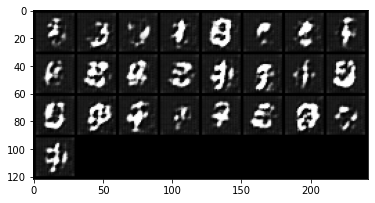

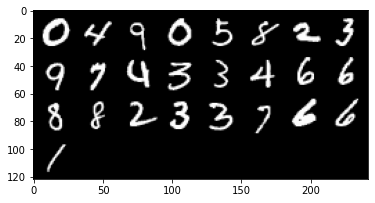

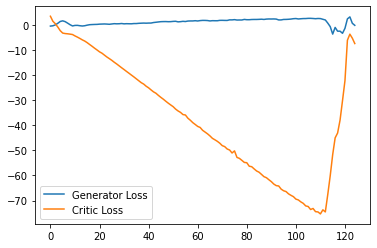

Step 2550: Generator loss: -0.005595066249370575, critic loss: -9.498899123191833


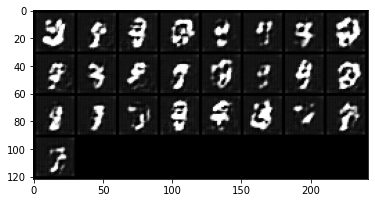

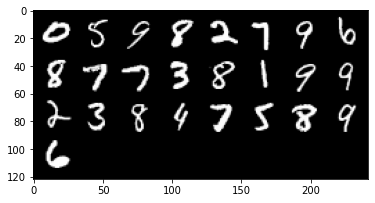

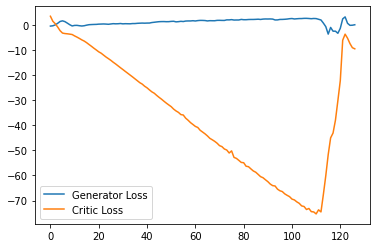

Step 2600: Generator loss: -0.495757016800344, critic loss: -8.683291734695434


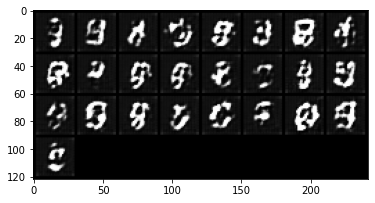

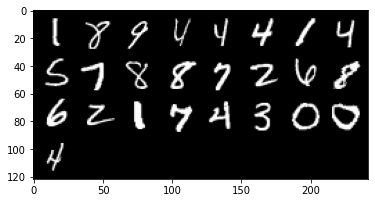

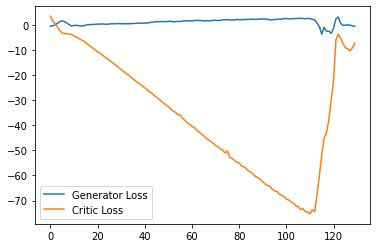

Step 2650: Generator loss: -0.6671205015480518, critic loss: -9.007100379467012


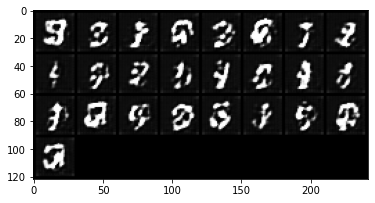

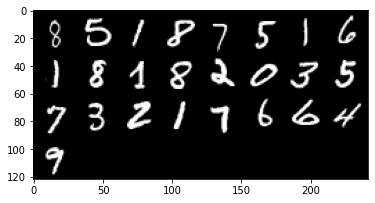

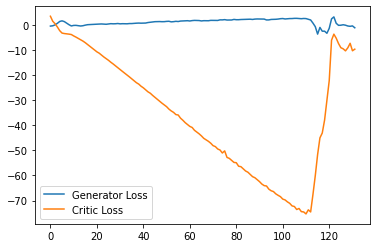

Step 2700: Generator loss: 0.08739675007760525, critic loss: -7.4160511350631735


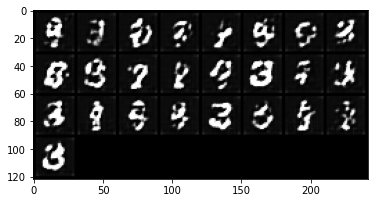

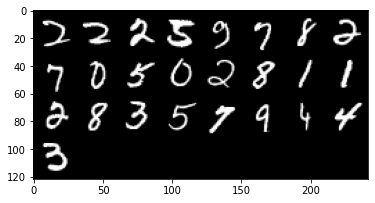

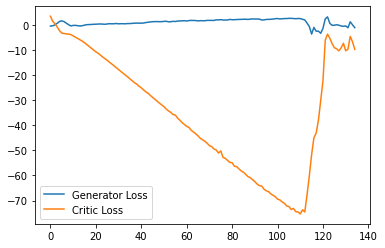

Step 2750: Generator loss: -1.0099890618026257, critic loss: -8.7879189453125


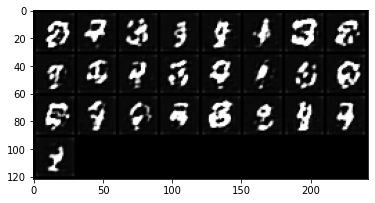

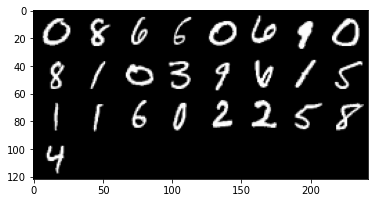

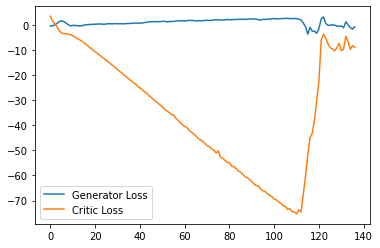

Step 2800: Generator loss: 1.3352707797288894, critic loss: -3.5514118952751157


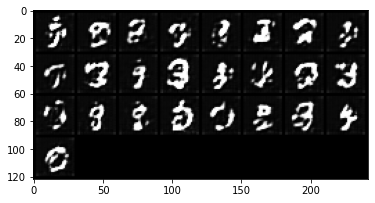

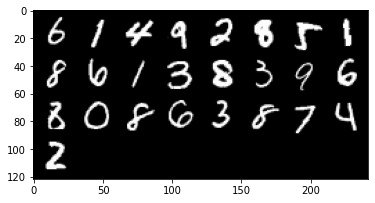

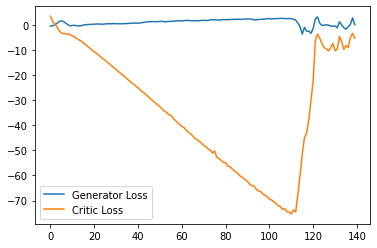

  0%|          | 0/469 [00:00<?, ?it/s]

Step 2850: Generator loss: -0.8892244344949722, critic loss: -8.14525176024437


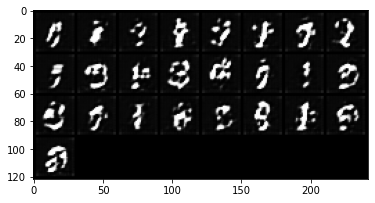

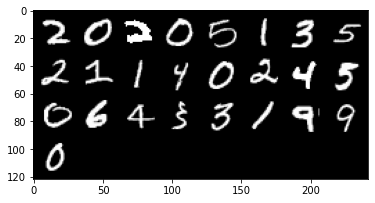

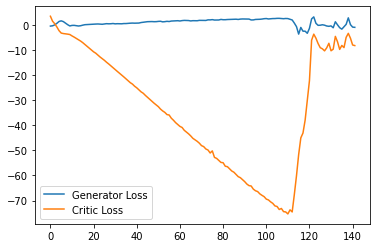

Step 2900: Generator loss: 1.2680691559612751, critic loss: -4.147863759040834


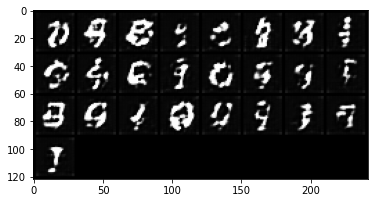

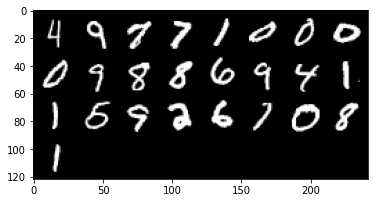

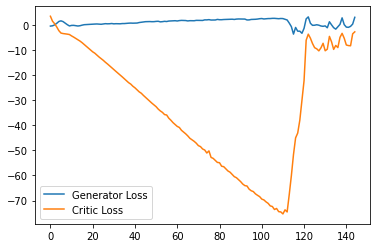

Step 2950: Generator loss: 0.337547610476613, critic loss: -5.689183131933212


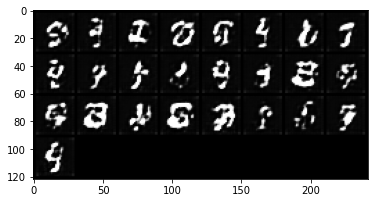

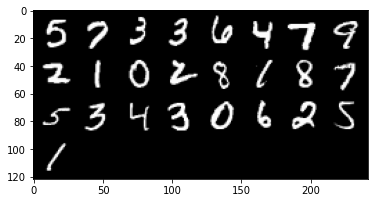

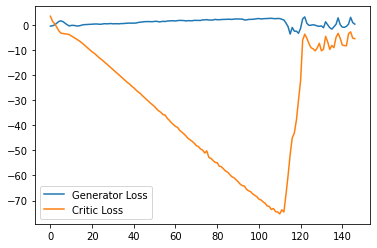

Step 3000: Generator loss: 0.009779422730207443, critic loss: -7.027072502851484


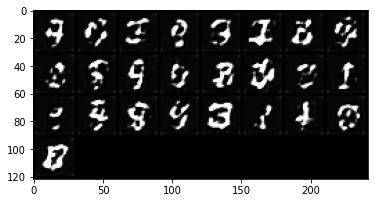

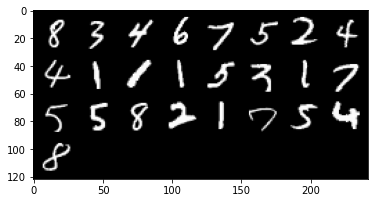

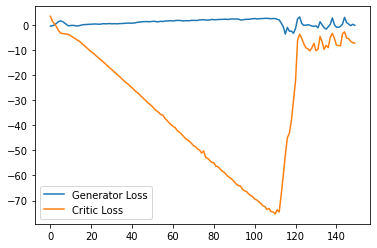

Step 3050: Generator loss: -0.06963962092995643, critic loss: -7.825131864547726


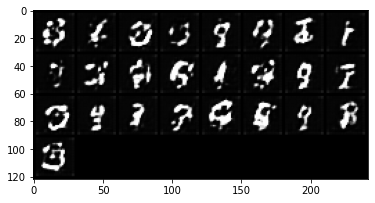

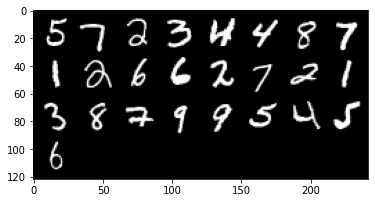

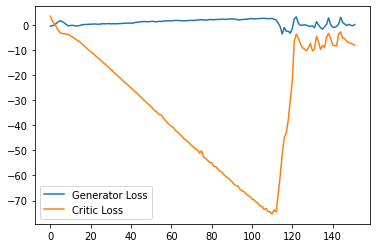

Step 3100: Generator loss: -0.3054134513437748, critic loss: -7.9835766336917855


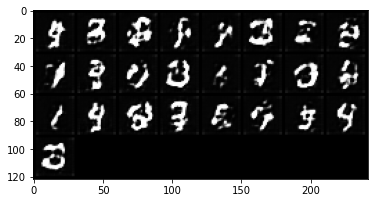

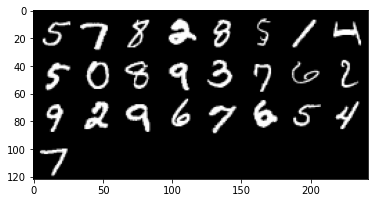

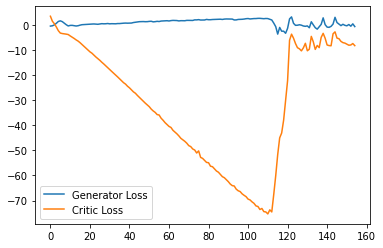

Step 3150: Generator loss: 0.18824011527001858, critic loss: -8.102551400303843


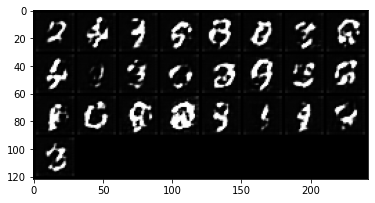

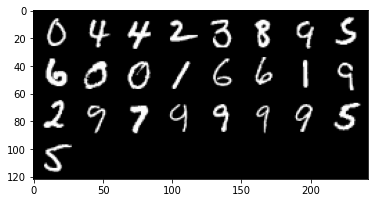

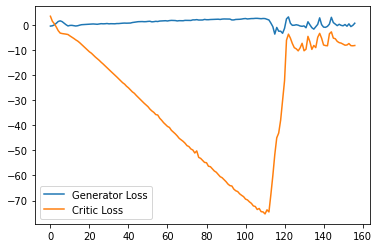

Step 3200: Generator loss: 0.7654274442791938, critic loss: -3.950940524578095


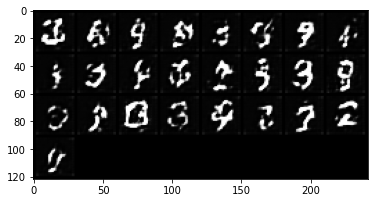

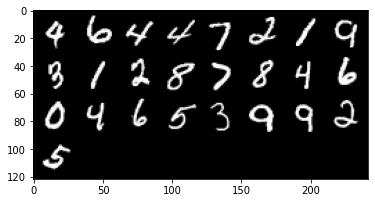

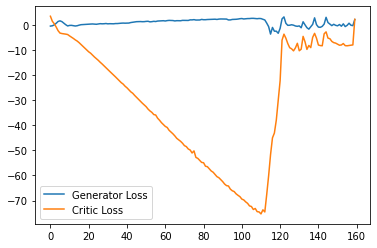

Step 3250: Generator loss: 0.949339874908328, critic loss: -5.009855436325072


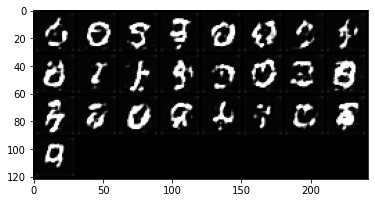

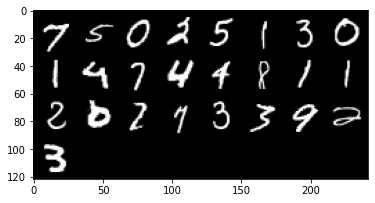

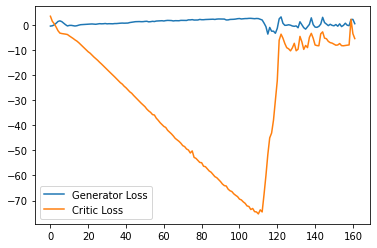

  0%|          | 0/469 [00:00<?, ?it/s]

Step 3300: Generator loss: 0.14476648591458796, critic loss: -6.760477856636048


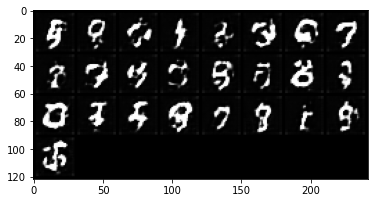

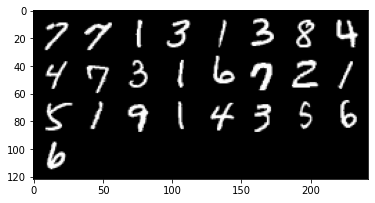

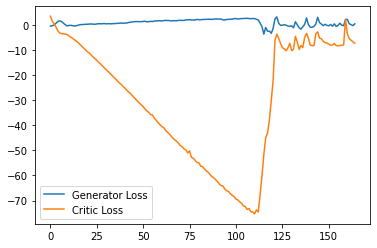

Step 3350: Generator loss: -0.31704552076756953, critic loss: -7.040868039369584


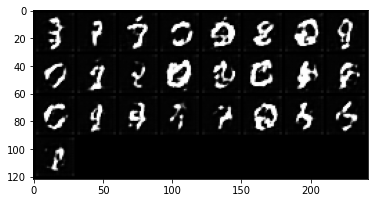

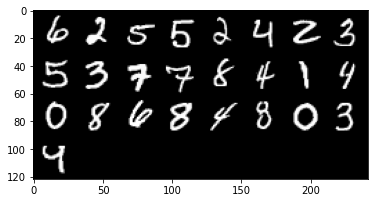

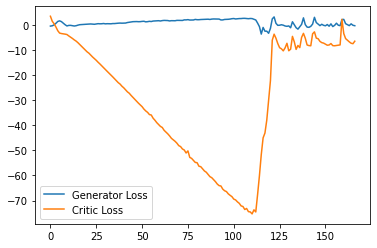

Step 3400: Generator loss: 0.03127904713153839, critic loss: -7.815179969310761


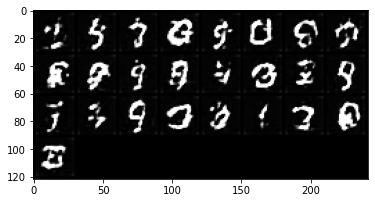

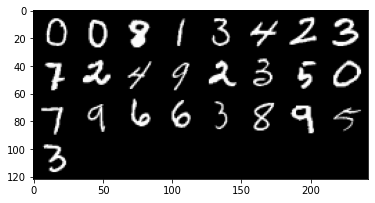

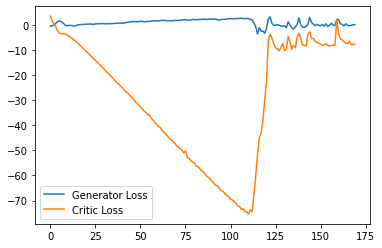

Step 3450: Generator loss: 0.46147098630666733, critic loss: -7.998421129465104


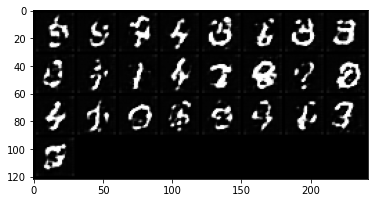

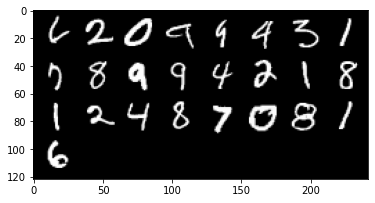

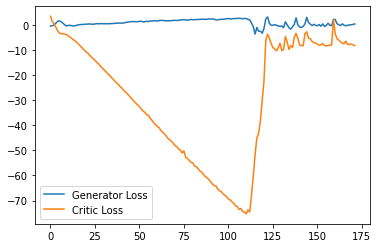

Step 3500: Generator loss: 0.3138179424405098, critic loss: -8.03256532907486


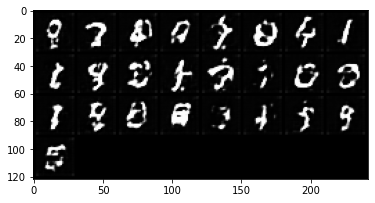

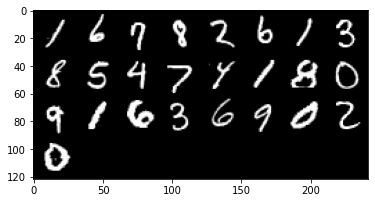

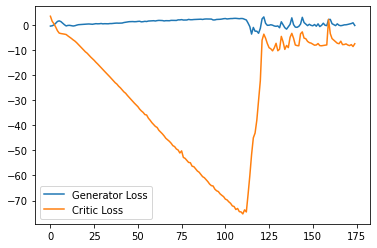

Step 3550: Generator loss: 0.38990109115839006, critic loss: -7.9934749996662156


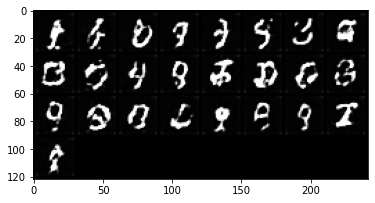

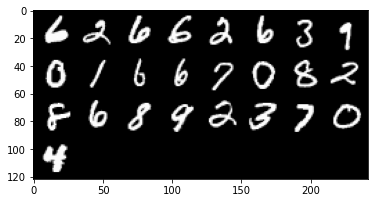

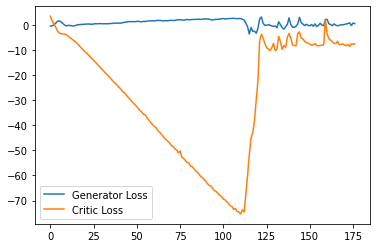

Step 3600: Generator loss: 0.1815771608427167, critic loss: -6.411967935800553


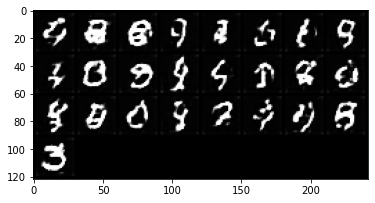

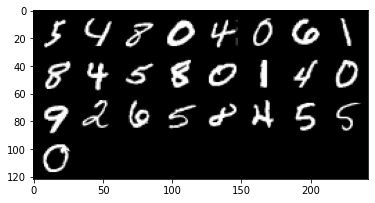

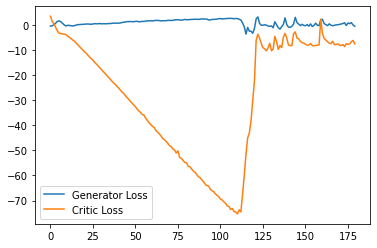

Step 3650: Generator loss: -0.4403720799088478, critic loss: -8.103923946619034


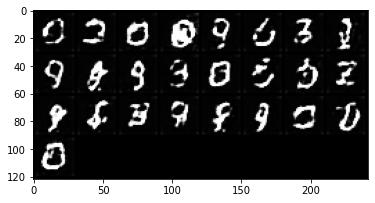

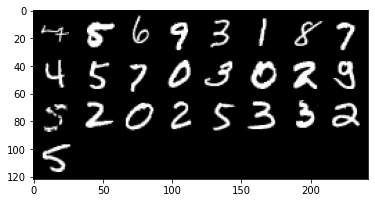

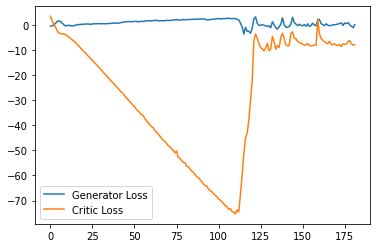

Step 3700: Generator loss: 0.5714626701921225, critic loss: -6.797591354131698


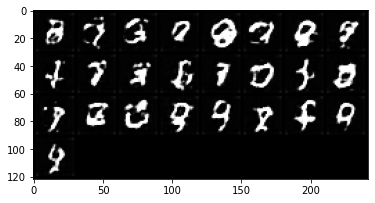

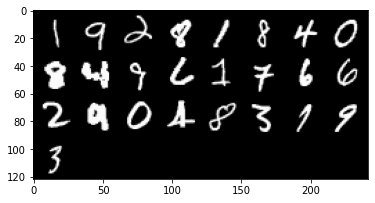

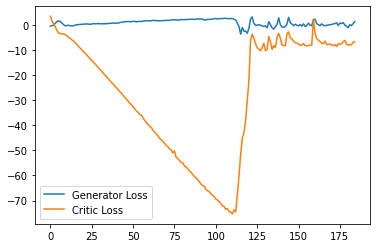

Step 3750: Generator loss: 0.3328727343678474, critic loss: -7.751377900600435


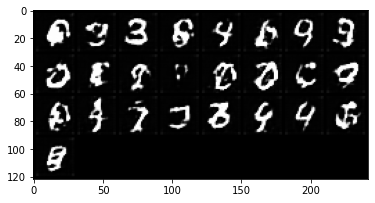

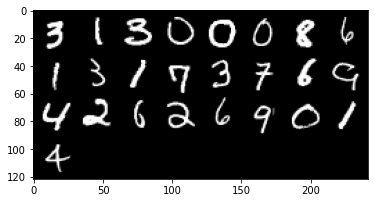

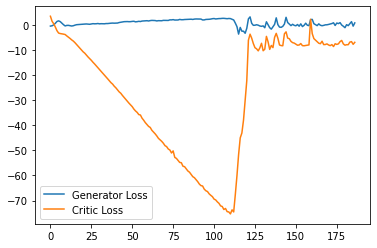

  0%|          | 0/469 [00:00<?, ?it/s]

Step 3800: Generator loss: 0.303411662876606, critic loss: -8.02805908370018


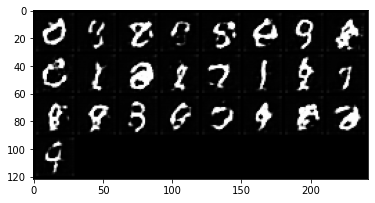

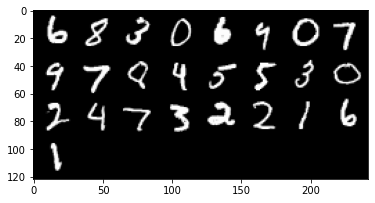

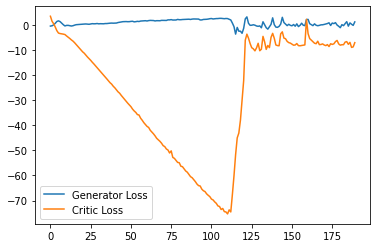

Step 3850: Generator loss: 0.99268589630723, critic loss: -6.772007893562319


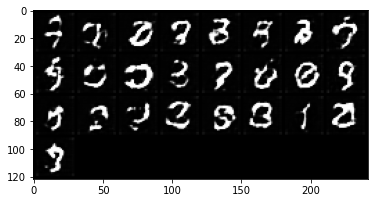

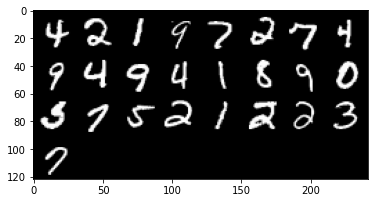

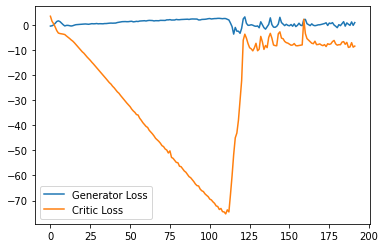

Step 3900: Generator loss: 1.89312737762928, critic loss: -5.927245814800264


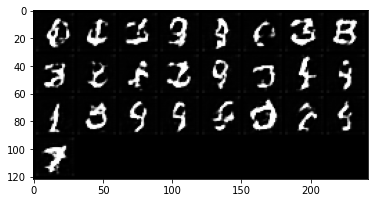

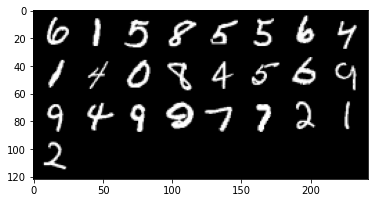

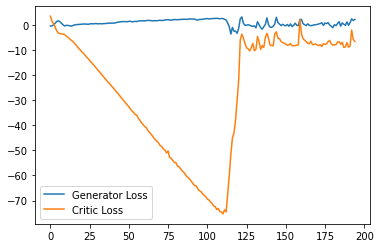

Step 3950: Generator loss: 1.4638333266973496, critic loss: -7.458758457422254


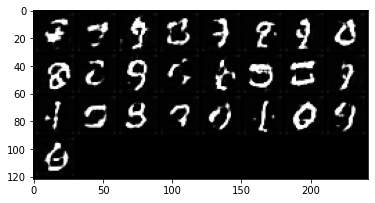

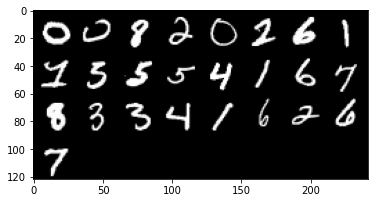

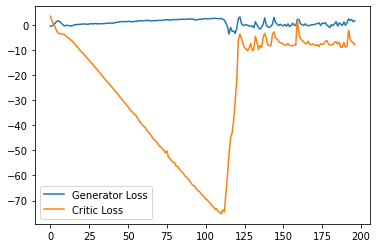

Step 4000: Generator loss: 1.329582522958517, critic loss: -7.746255675792691


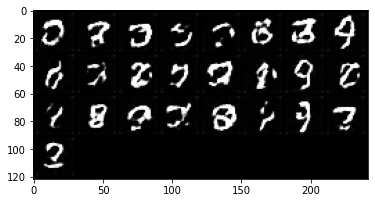

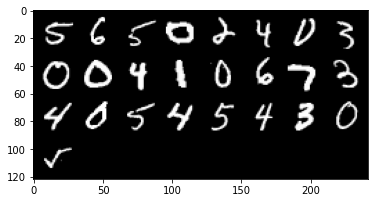

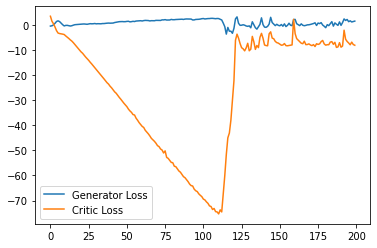

Step 4050: Generator loss: 2.208255015388131, critic loss: -7.341086420297625


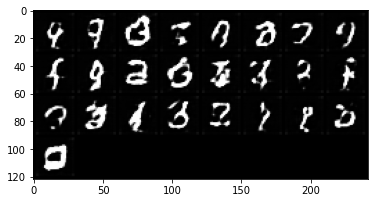

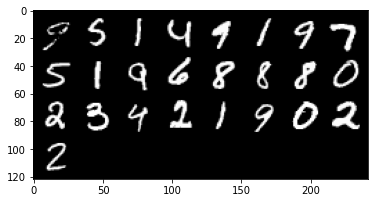

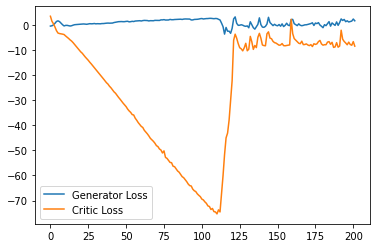

Step 4100: Generator loss: 2.1356663554906845, critic loss: -6.00845635843277


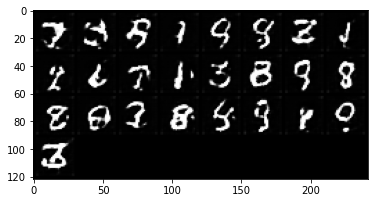

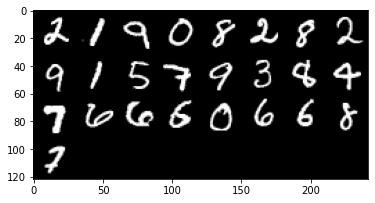

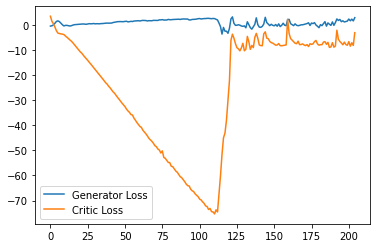

Step 4150: Generator loss: 2.3094977180659773, critic loss: -4.83239789867401


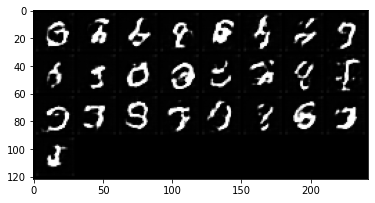

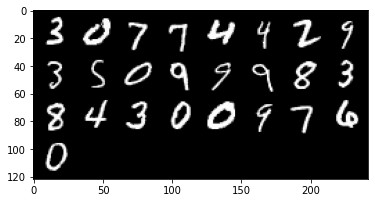

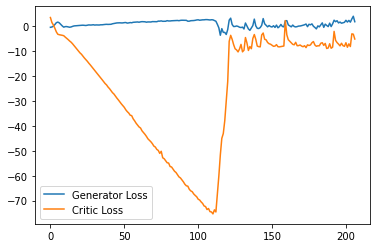

Step 4200: Generator loss: 1.5066904959082603, critic loss: -7.080716102957723


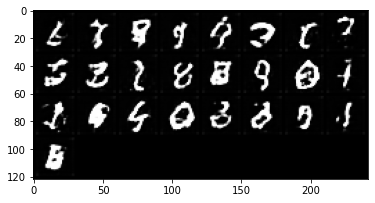

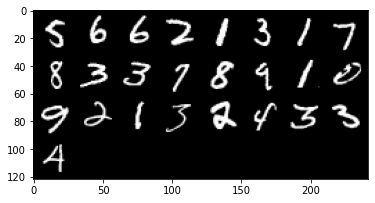

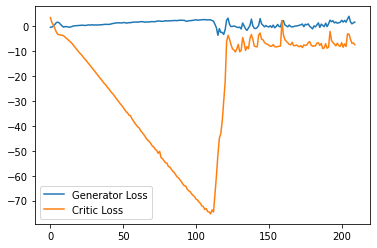

  0%|          | 0/469 [00:00<?, ?it/s]

Step 4250: Generator loss: 1.533420041501522, critic loss: -6.772169277668


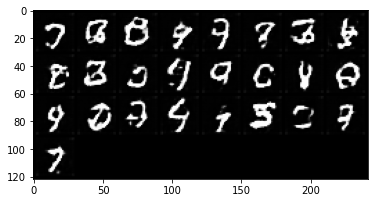

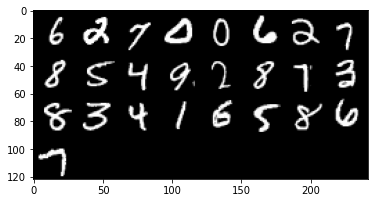

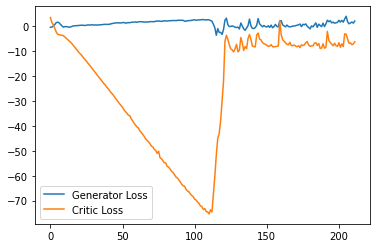

Step 4300: Generator loss: 1.3388095931708812, critic loss: -7.330782686233521


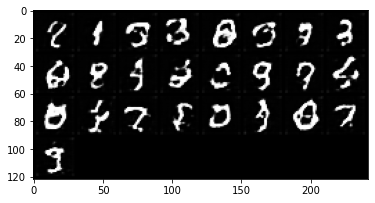

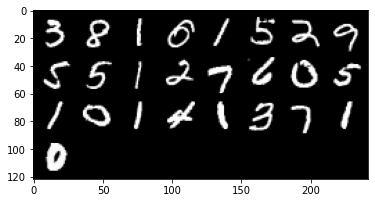

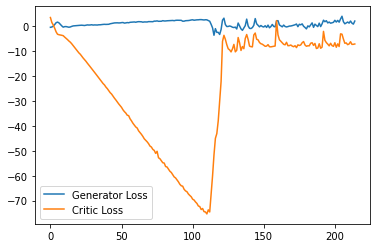

Step 4350: Generator loss: 0.8577240762859583, critic loss: -7.885278314590454


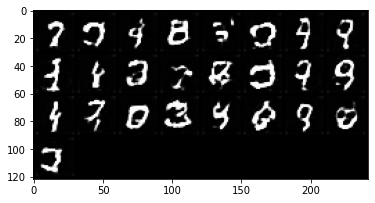

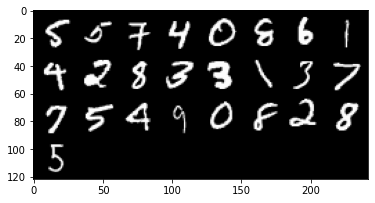

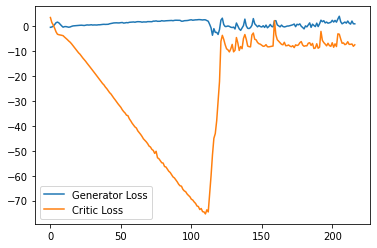

Step 4400: Generator loss: 0.9280175482854247, critic loss: -8.176309083938596


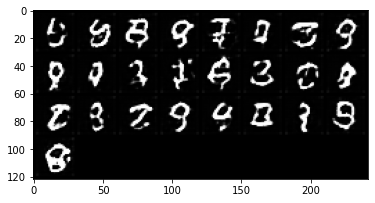

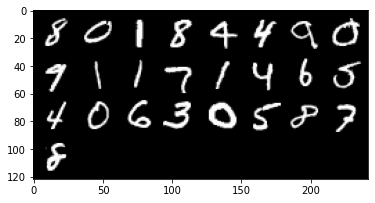

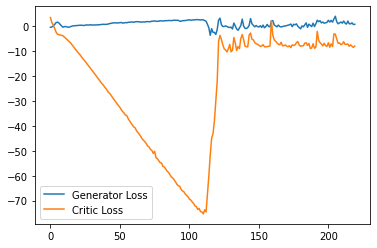

Step 4450: Generator loss: 1.4737459129840136, critic loss: -8.797552685022353


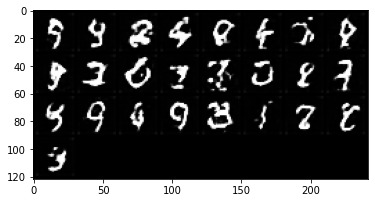

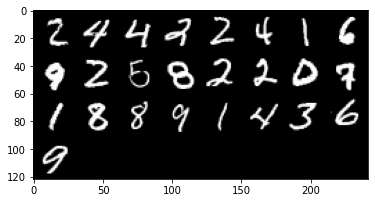

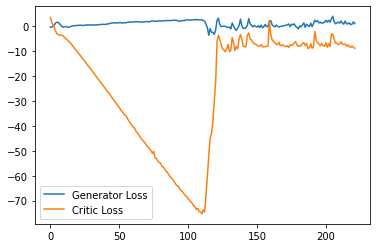

Step 4500: Generator loss: 1.404376313984394, critic loss: -8.709513901948931


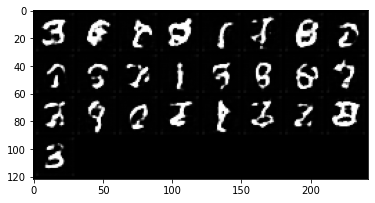

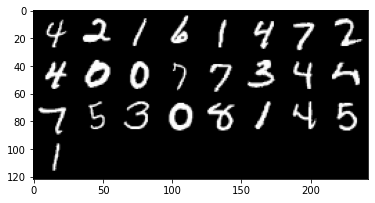

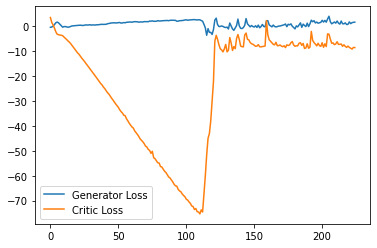

Step 4550: Generator loss: 2.179132488667965, critic loss: -5.385497767567633


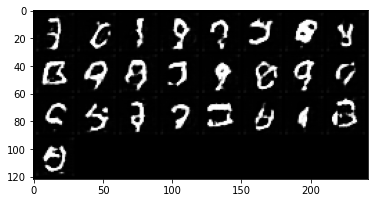

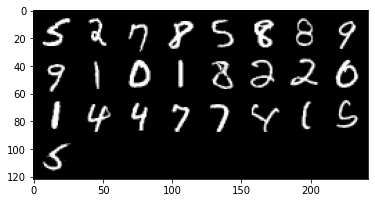

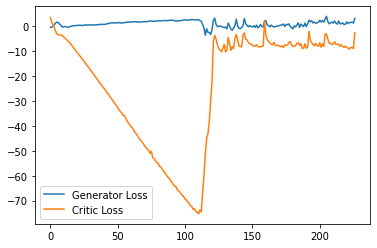

Step 4600: Generator loss: 1.7921829436719419, critic loss: -6.07685983645916


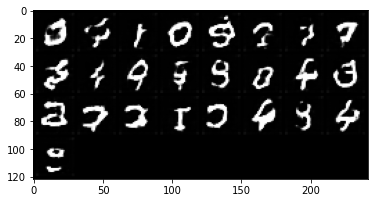

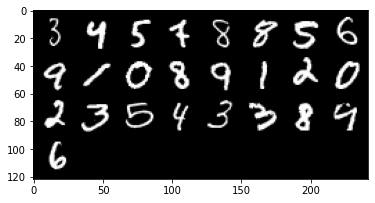

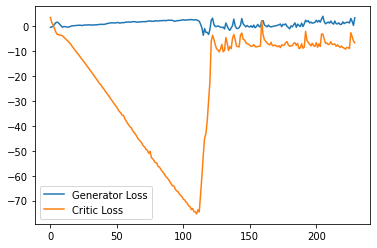

Step 4650: Generator loss: 1.151749724149704, critic loss: -7.966292660713197


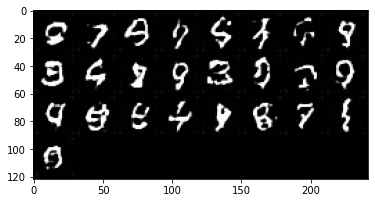

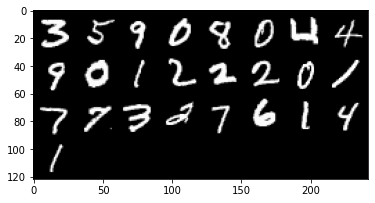

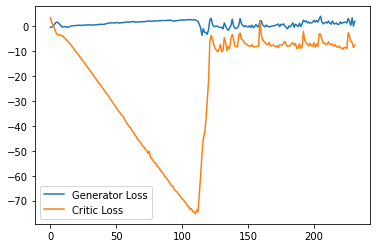

  0%|          | 0/469 [00:00<?, ?it/s]

Step 4700: Generator loss: 0.9609663594514132, critic loss: -8.745861580252646


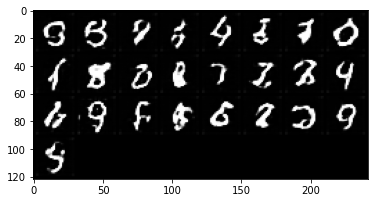

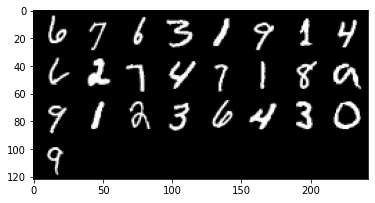

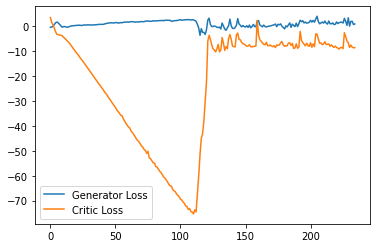

Step 4750: Generator loss: 1.428017835766077, critic loss: -8.253211585044863


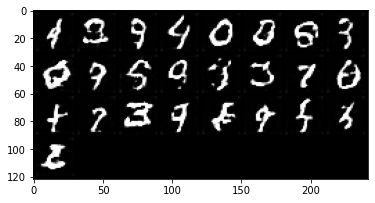

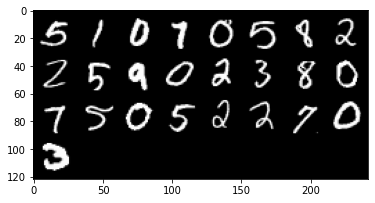

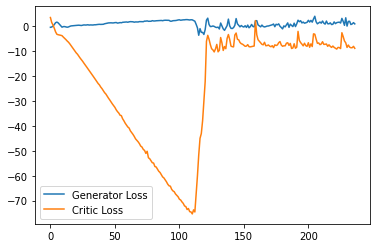

Step 4800: Generator loss: 1.5886166967451572, critic loss: -8.137696631789208


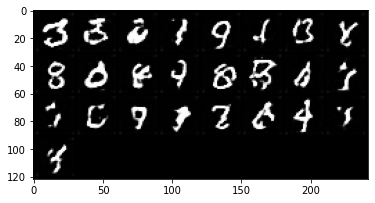

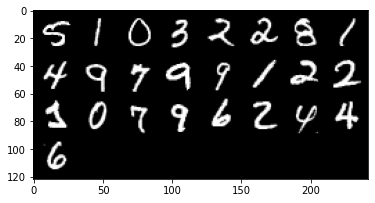

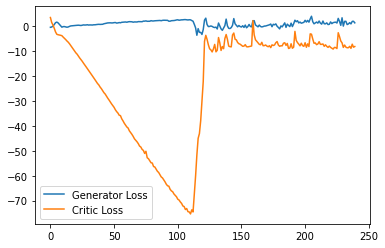

Step 4850: Generator loss: 1.8732815031707286, critic loss: -8.43635424530506


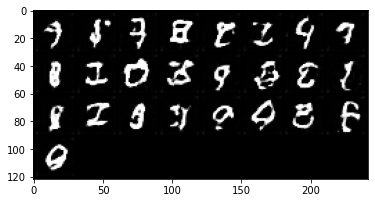

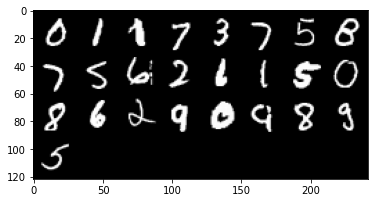

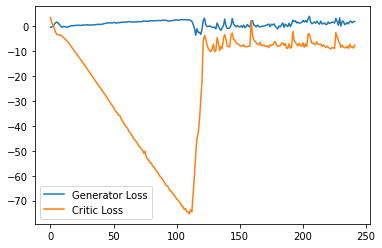

Step 4900: Generator loss: 2.2615856072306633, critic loss: -8.374380697250364


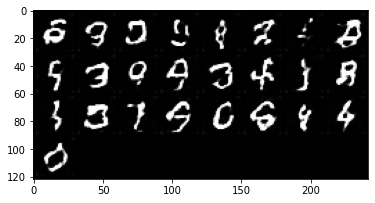

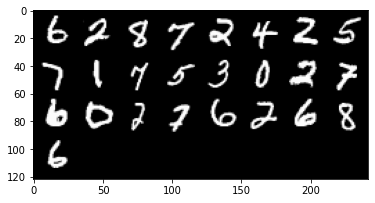

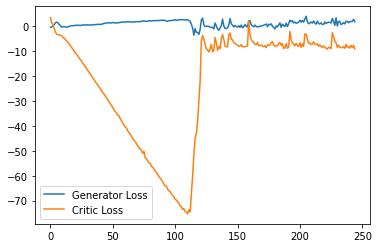

Step 4950: Generator loss: 1.5950132191181183, critic loss: -8.745427855014801


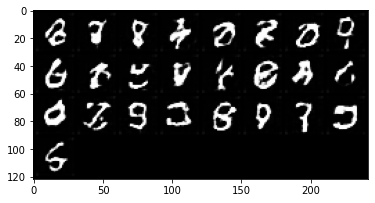

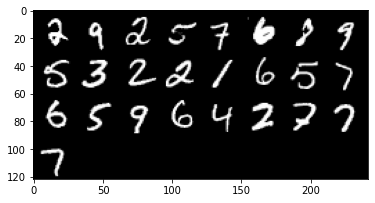

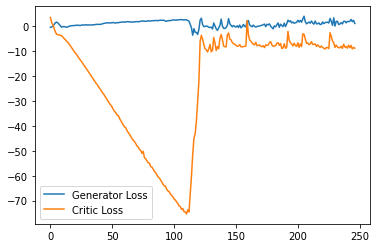

Step 5000: Generator loss: 2.0382575315237044, critic loss: -8.324106527090072


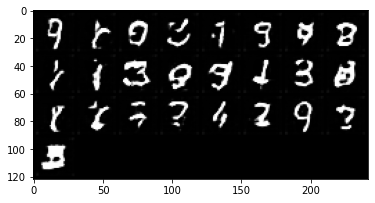

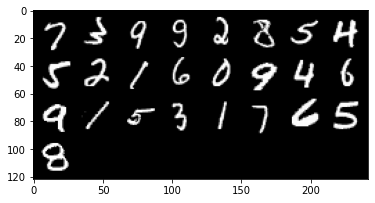

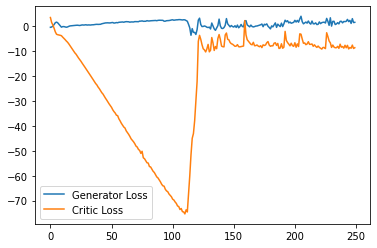

Step 5050: Generator loss: 3.496387281566858, critic loss: -3.614754377663136


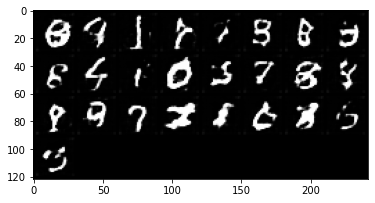

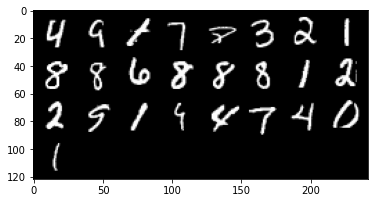

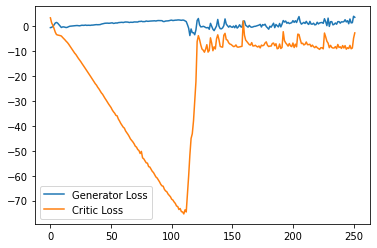

Step 5100: Generator loss: 0.8646866375207901, critic loss: -5.783061346054077


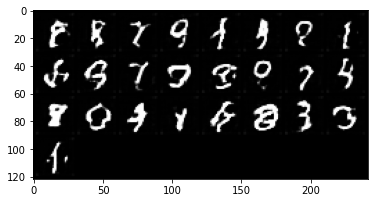

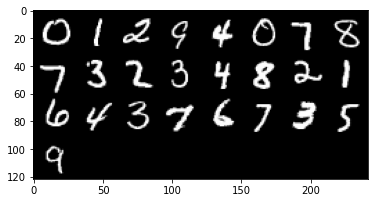

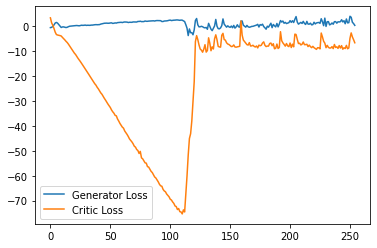

Step 5150: Generator loss: 1.113335842564702, critic loss: -7.509336449861527


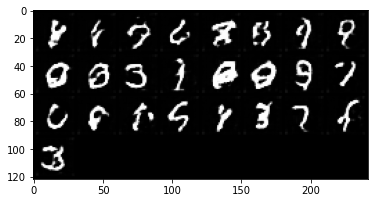

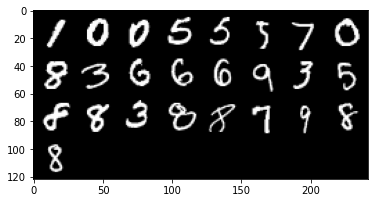

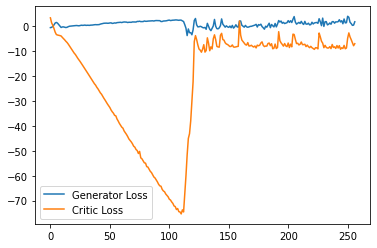

  0%|          | 0/469 [00:00<?, ?it/s]

Step 5200: Generator loss: 1.9925434196740388, critic loss: -7.77286808037758


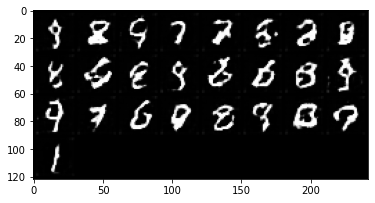

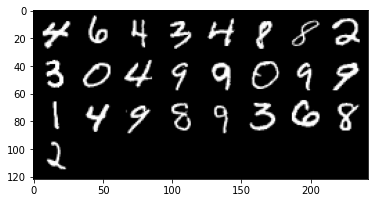

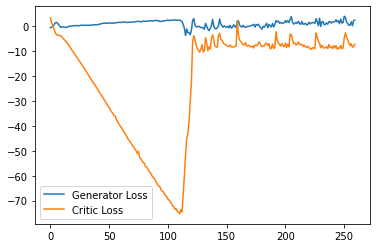

Step 5250: Generator loss: 1.487153303399682, critic loss: -8.941205986022947


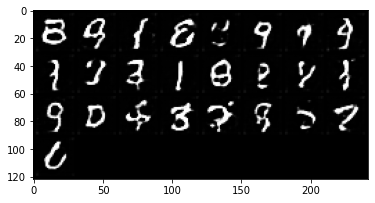

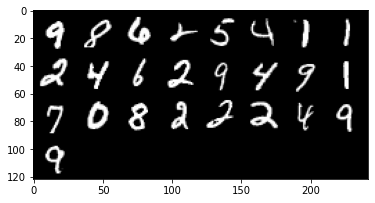

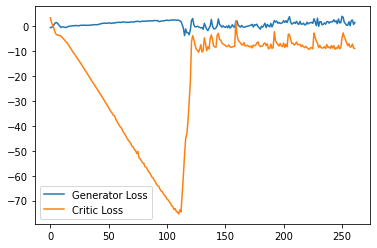

Step 5300: Generator loss: 3.116721196472645, critic loss: -7.964382182776927


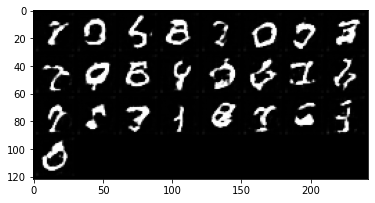

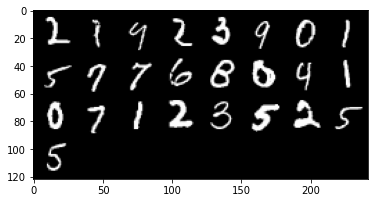

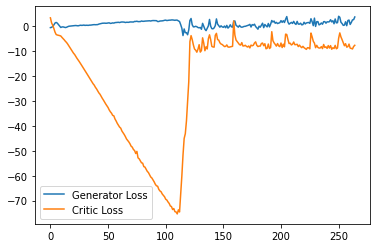

Step 5350: Generator loss: 1.478676919862628, critic loss: -9.003334412813187


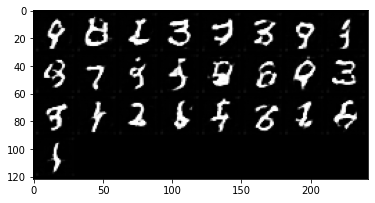

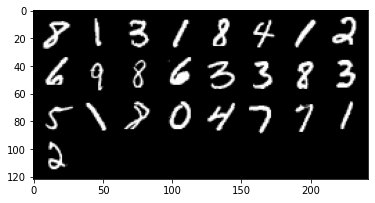

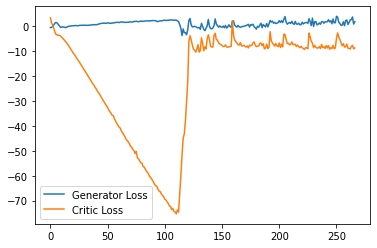

Step 5400: Generator loss: 2.6484398224204777, critic loss: -8.47068991726637


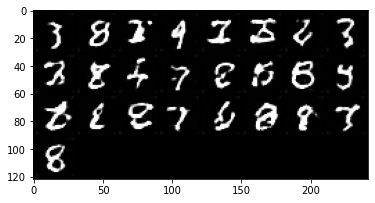

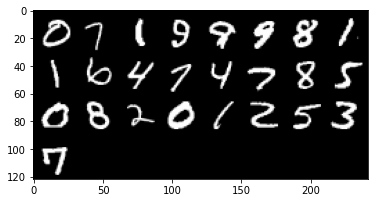

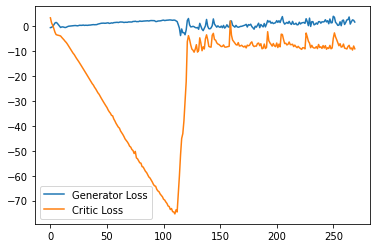

Step 5450: Generator loss: 2.00742396581918, critic loss: -9.307766730964182


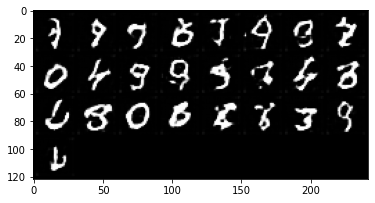

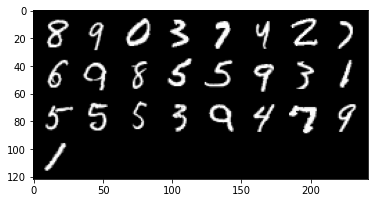

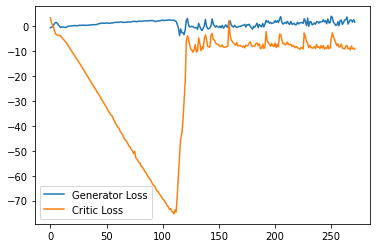

Step 5500: Generator loss: 3.5389097505807876, critic loss: -8.060807187318805


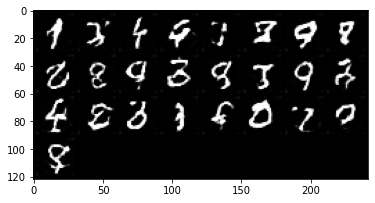

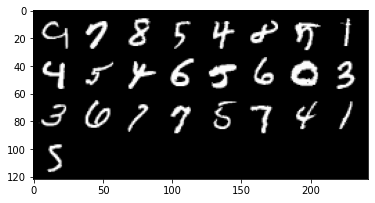

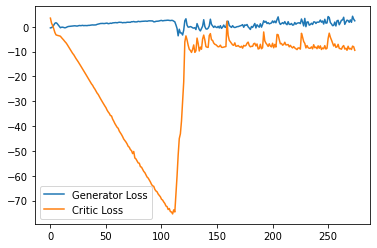

Step 5550: Generator loss: 1.6250308009982108, critic loss: -7.279707273244859


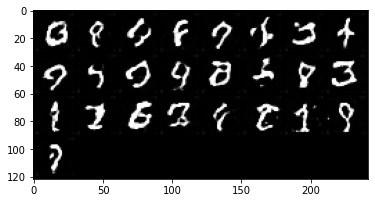

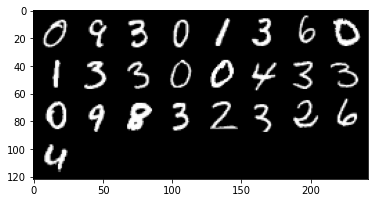

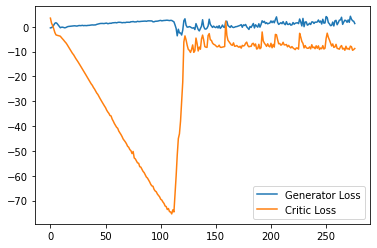

Step 5600: Generator loss: 2.504049602299929, critic loss: -5.536696662068366


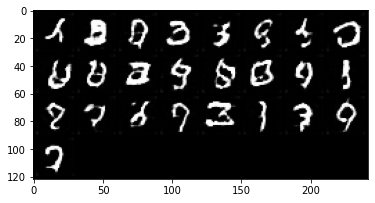

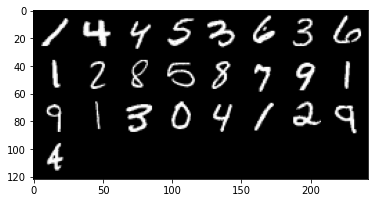

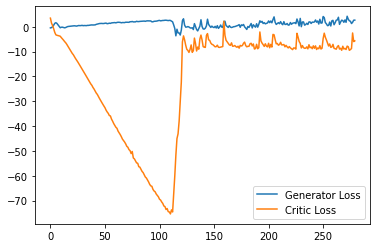

  0%|          | 0/469 [00:00<?, ?it/s]

Step 5650: Generator loss: 2.274506001472473, critic loss: -7.534015109777454


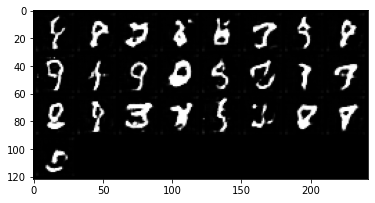

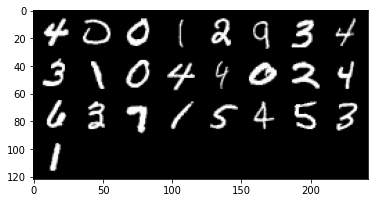

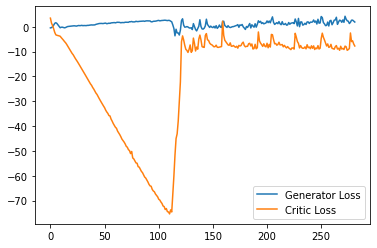

Step 5700: Generator loss: 3.0970793713629248, critic loss: -7.194905497968198


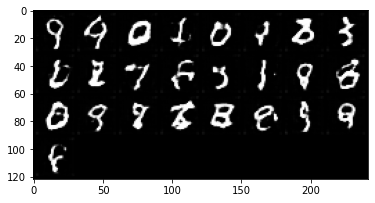

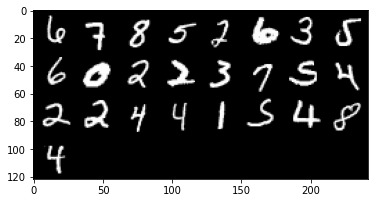

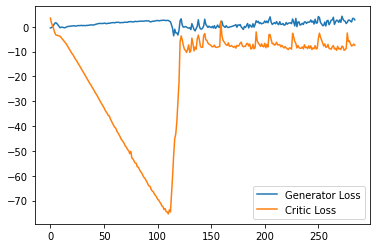

Step 5750: Generator loss: 2.204267661720514, critic loss: -7.819774383306502


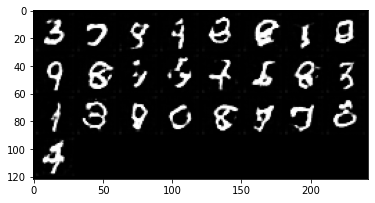

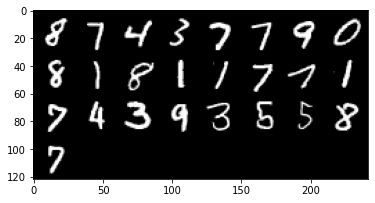

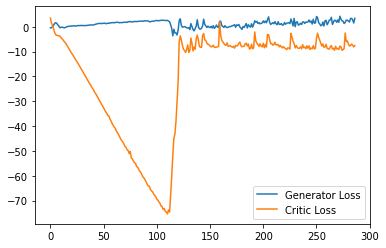

Step 5800: Generator loss: 2.2491312320530414, critic loss: -8.057452101945875


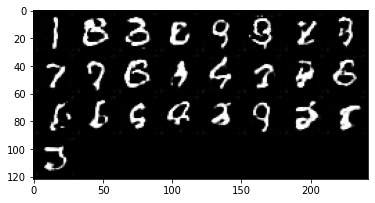

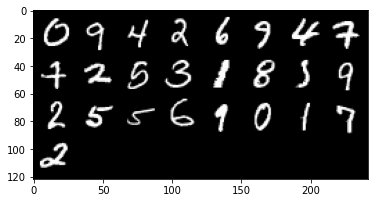

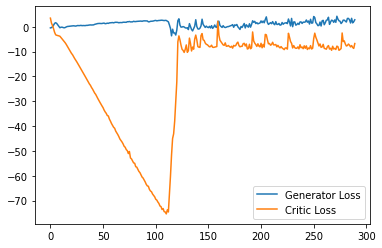

Step 5850: Generator loss: 2.403815092891455, critic loss: -8.23803905439377


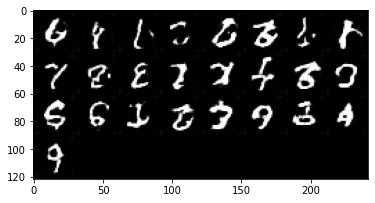

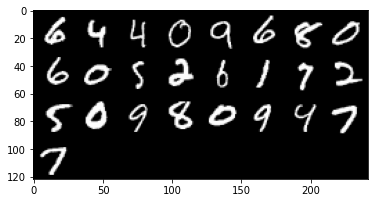

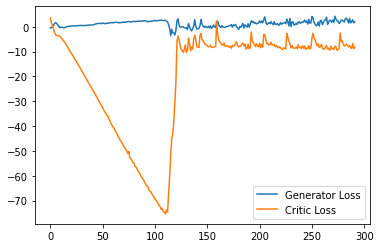

Step 5900: Generator loss: 2.3576256743073465, critic loss: -8.568311657428744


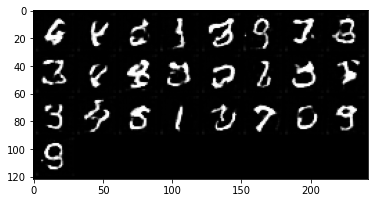

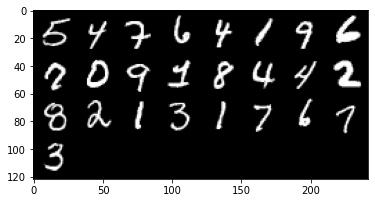

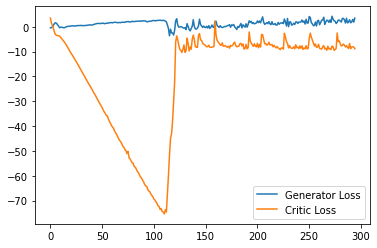

Step 5950: Generator loss: 3.487778768837452, critic loss: -8.074026461601257


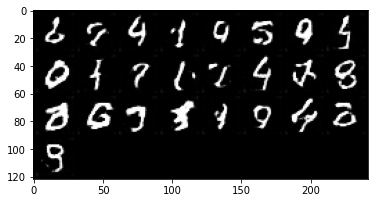

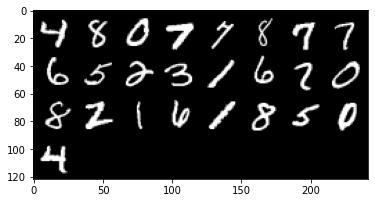

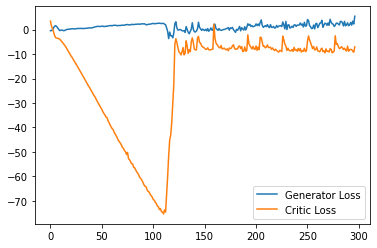

Step 6000: Generator loss: 3.1064709542691706, critic loss: -7.384259286522864


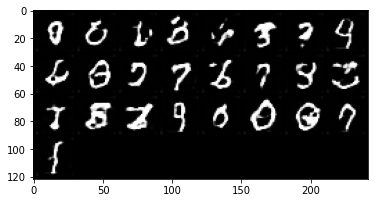

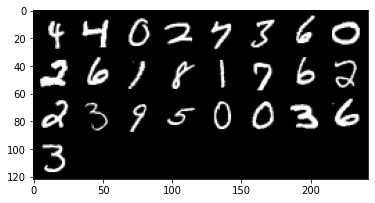

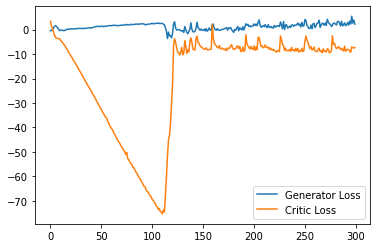

Step 6050: Generator loss: 3.3919911040365696, critic loss: -3.190788518548012


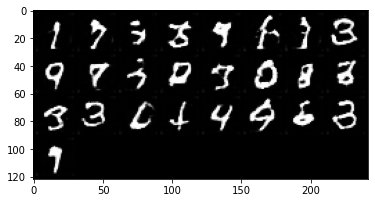

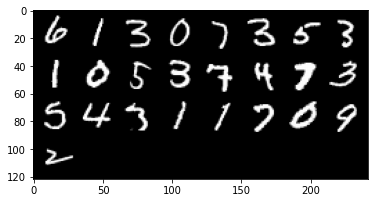

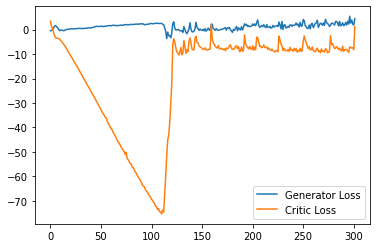

  0%|          | 0/469 [00:00<?, ?it/s]

Step 6100: Generator loss: 2.5531218840181826, critic loss: -4.052885717034339


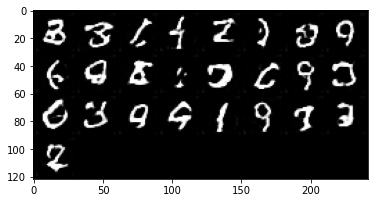

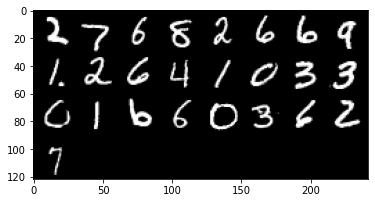

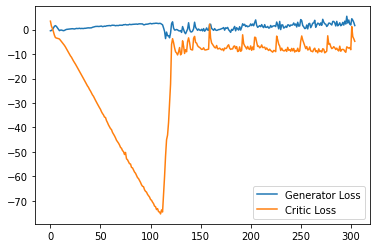

Step 6150: Generator loss: 2.1655995567142963, critic loss: -5.958110845327378


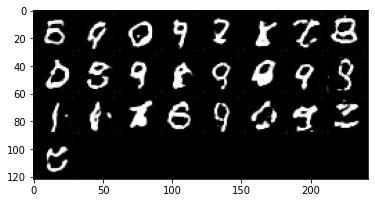

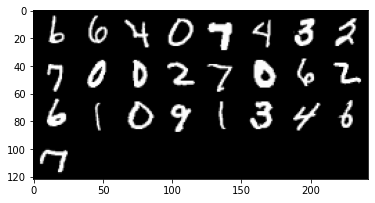

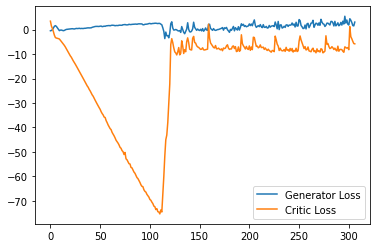

Step 6200: Generator loss: 2.2895932061970234, critic loss: -6.570439687252047


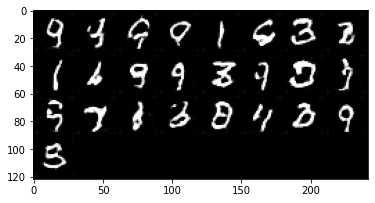

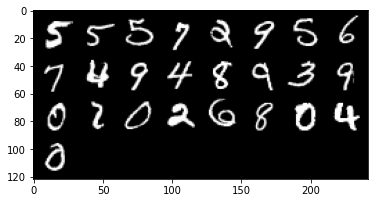

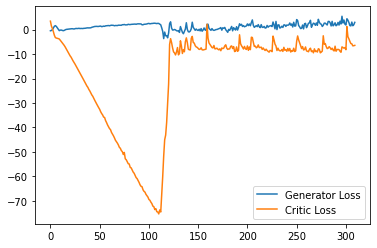

Step 6250: Generator loss: 2.590096969008446, critic loss: -6.569289544582371


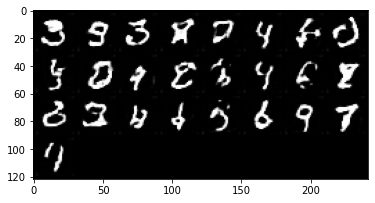

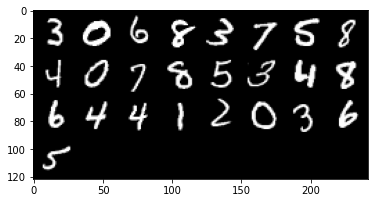

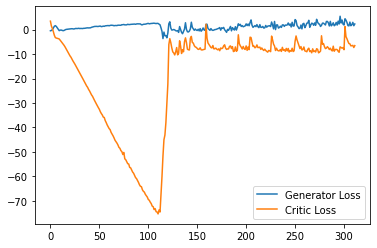

Step 6300: Generator loss: 2.116857777312398, critic loss: -6.854816051006318


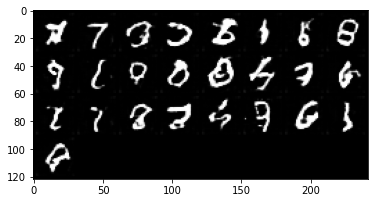

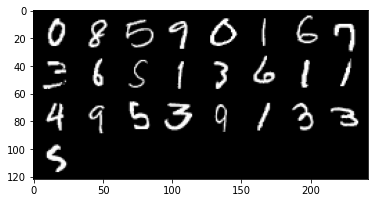

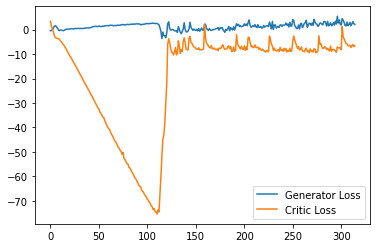

Step 6350: Generator loss: 2.3698856085538864, critic loss: -7.4667355440855


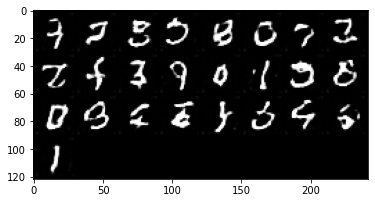

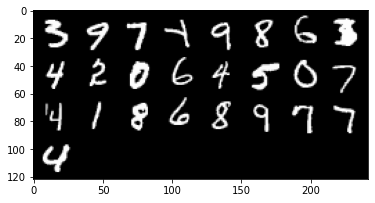

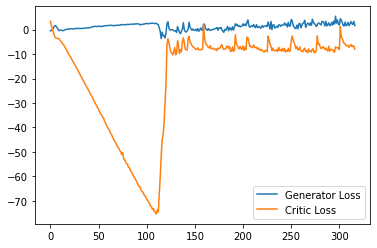

Step 6400: Generator loss: 2.6696422688663004, critic loss: -6.879280674874783


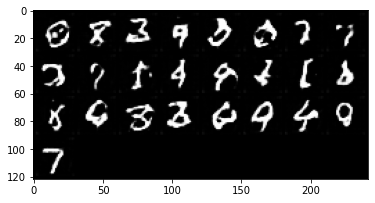

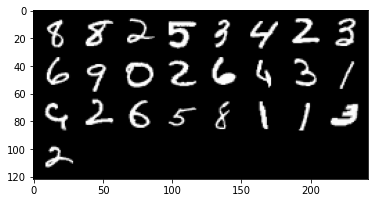

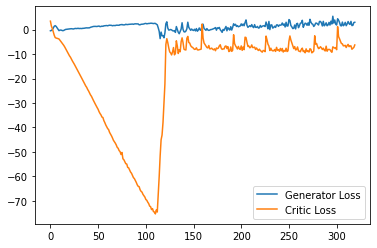

Step 6450: Generator loss: 2.4868248043209316, critic loss: -8.070423468351365


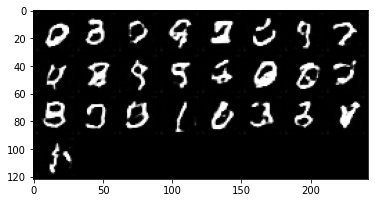

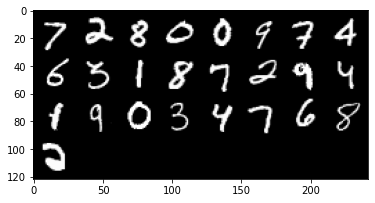

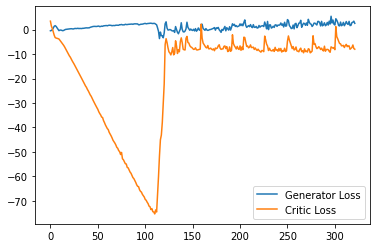

Step 6500: Generator loss: 3.2443053176999093, critic loss: -6.561602967500686


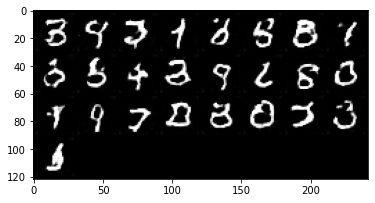

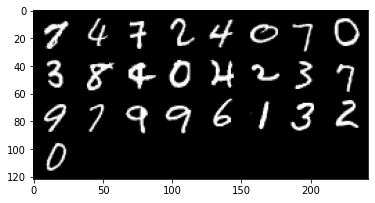

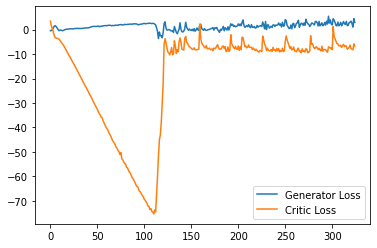

Step 6550: Generator loss: 1.748939976170659, critic loss: -7.981662276983262


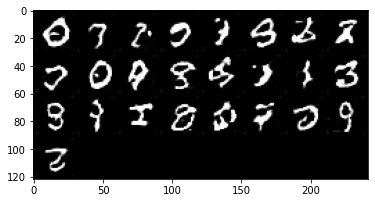

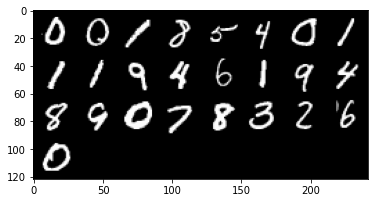

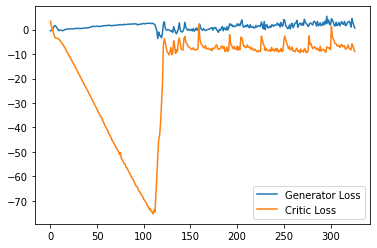

  0%|          | 0/469 [00:00<?, ?it/s]

Step 6600: Generator loss: 1.0608863146603107, critic loss: -8.697114612817765


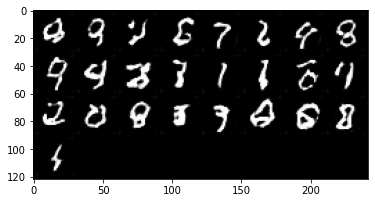

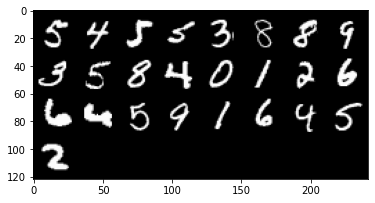

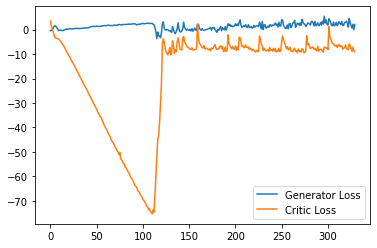

Step 6650: Generator loss: 2.014936423078179, critic loss: -4.250441935479642


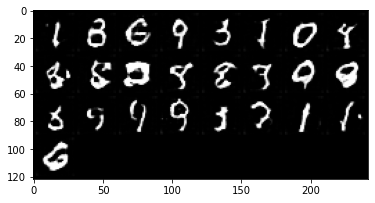

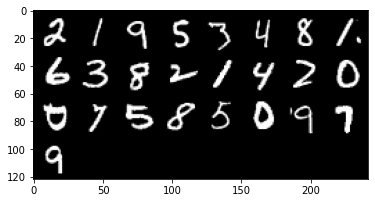

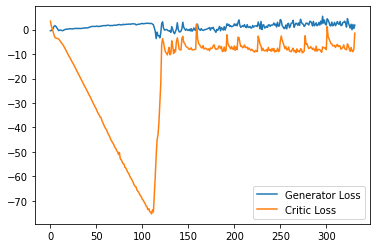

Step 6700: Generator loss: 2.6306315299123524, critic loss: -4.952182772755623


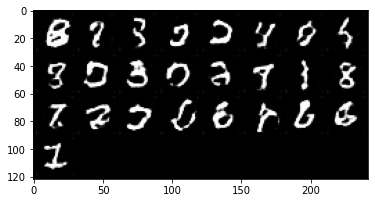

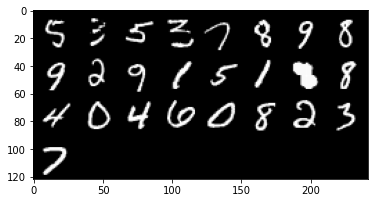

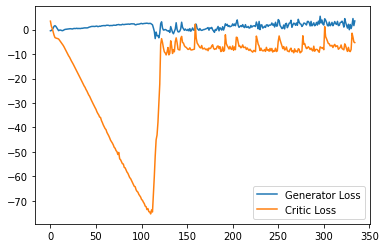

Step 6750: Generator loss: 2.2639772129058837, critic loss: -7.14048957479


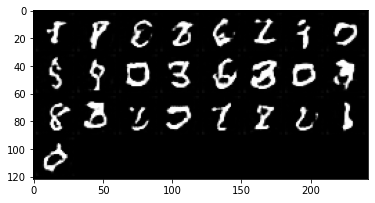

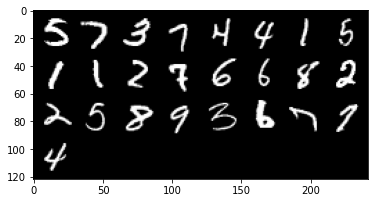

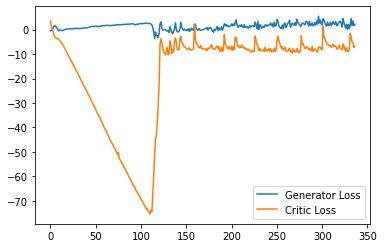

Step 6800: Generator loss: 1.6927119576931, critic loss: -8.033579233288766


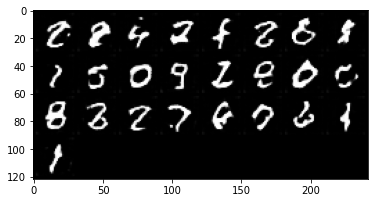

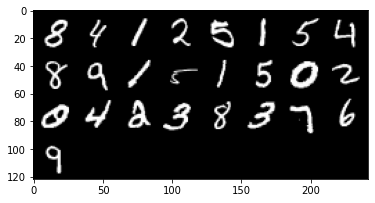

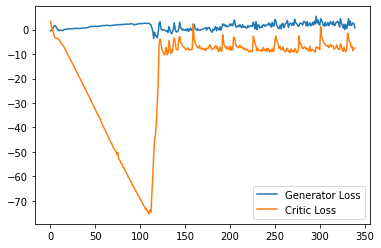

Step 6850: Generator loss: 2.1074057632684706, critic loss: -7.325561574459077


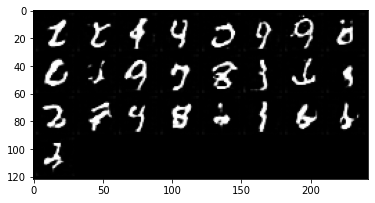

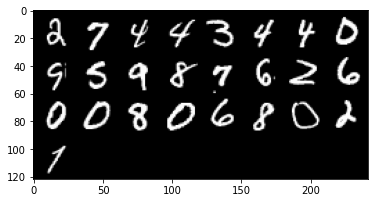

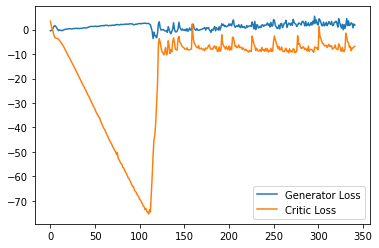

Step 6900: Generator loss: 1.972053758352995, critic loss: -7.844743161439895


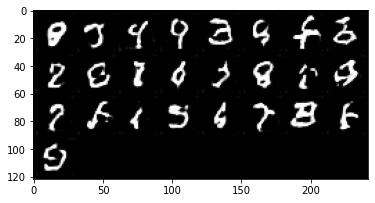

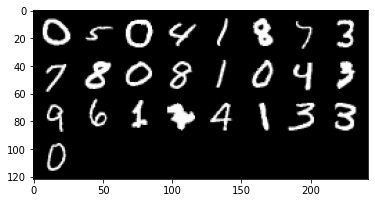

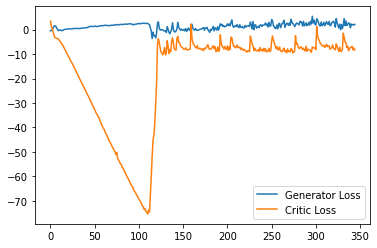

Step 6950: Generator loss: 1.7339498949050904, critic loss: -7.324450651526451


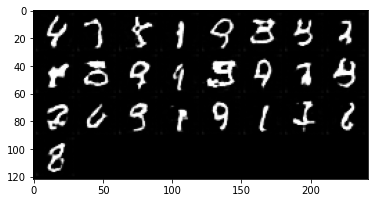

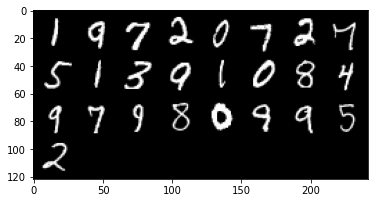

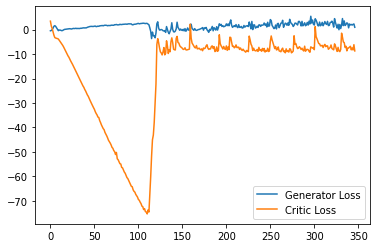

Step 7000: Generator loss: 1.8563897194713355, critic loss: -7.66376803636551


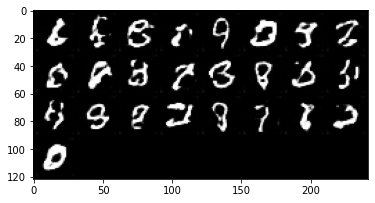

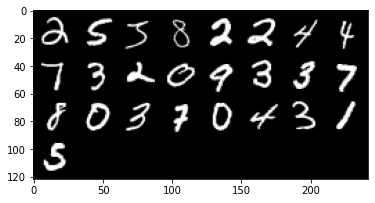

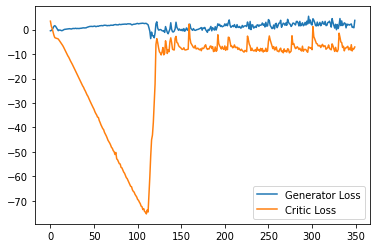

  0%|          | 0/469 [00:00<?, ?it/s]

Step 7050: Generator loss: 2.4960453747212887, critic loss: -7.21166570520401


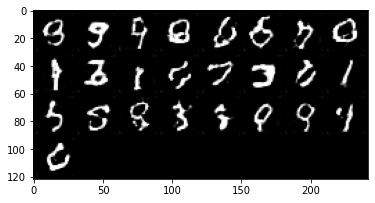

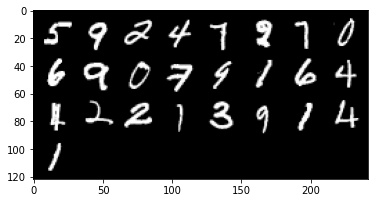

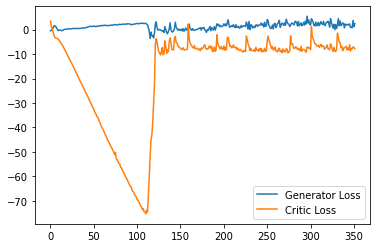

Step 7100: Generator loss: 0.6328549575805664, critic loss: -8.20974283528328


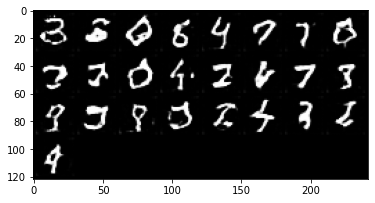

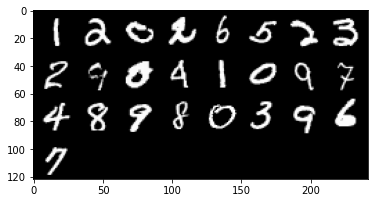

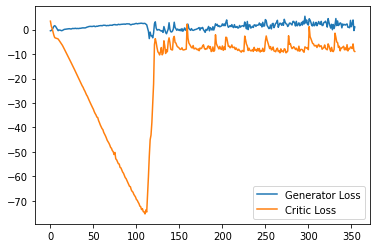

Step 7150: Generator loss: 1.2210862229391932, critic loss: -7.796062787771222


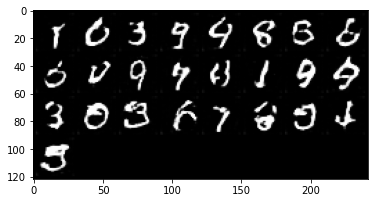

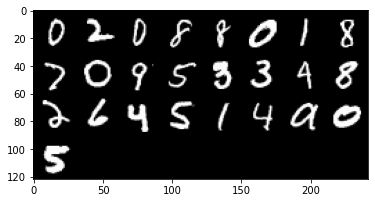

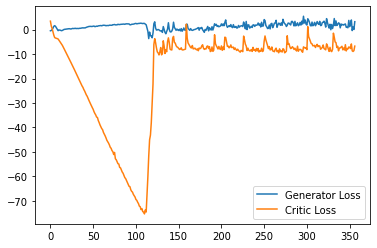

Step 7200: Generator loss: 1.1681797748059035, critic loss: -7.986965621829034


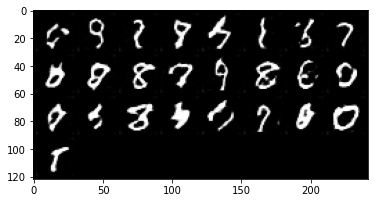

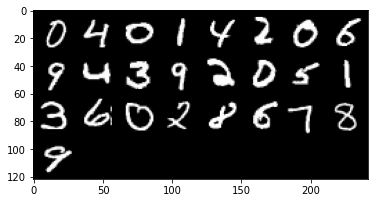

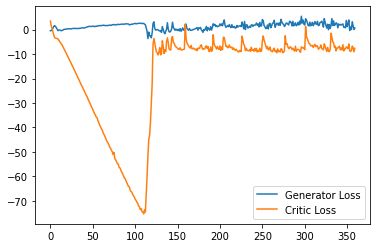

Step 7250: Generator loss: 0.1019980925321579, critic loss: -8.784092126727105


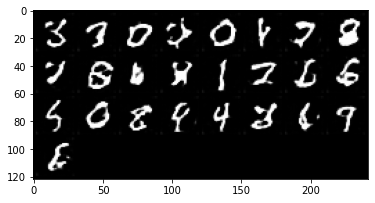

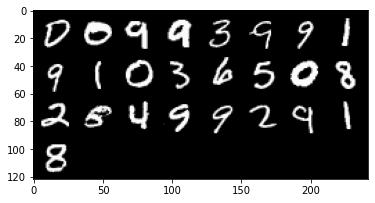

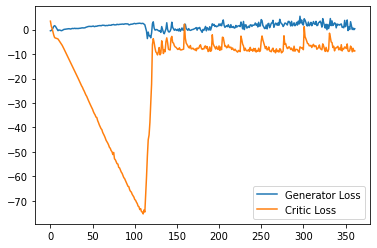

Step 7300: Generator loss: 1.7303145505487918, critic loss: -8.234195084333418


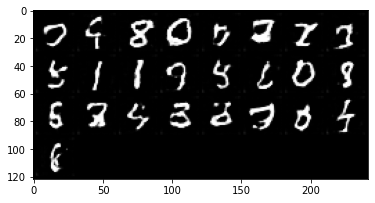

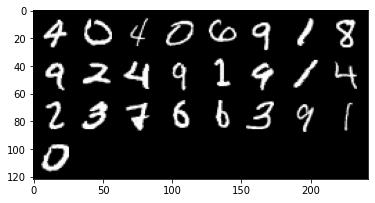

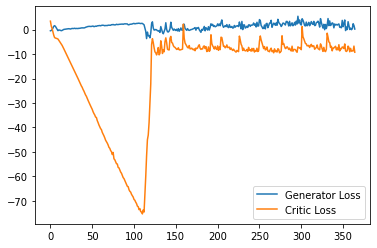

Step 7350: Generator loss: 0.36494985029101373, critic loss: -8.392346939325334


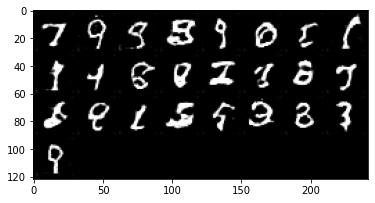

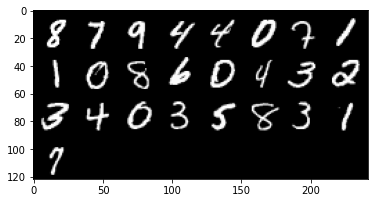

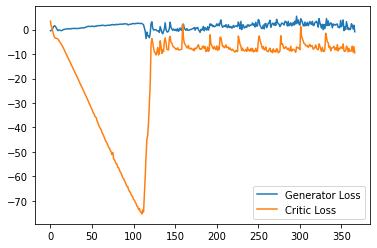

Step 7400: Generator loss: 1.1983111557364463, critic loss: -8.137885277926923


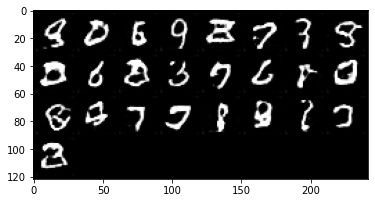

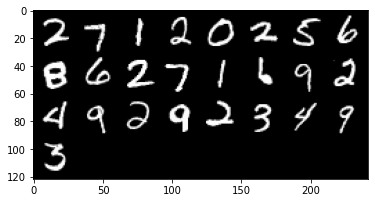

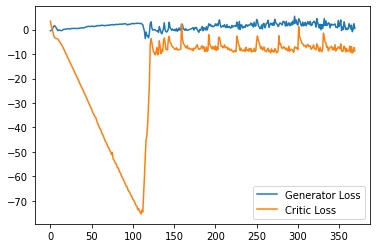

Step 7450: Generator loss: -0.10003531016409398, critic loss: -7.815339960455894


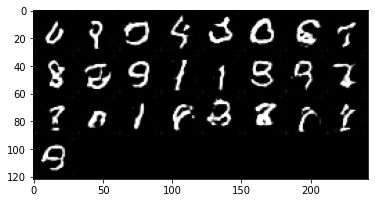

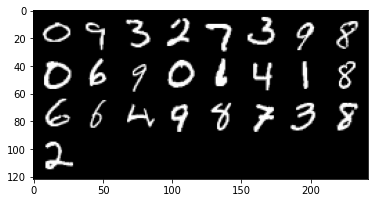

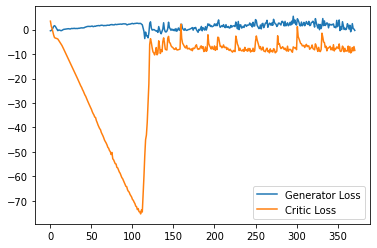

Step 7500: Generator loss: 2.763781213909388, critic loss: -7.477057536721228


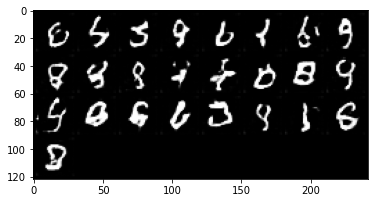

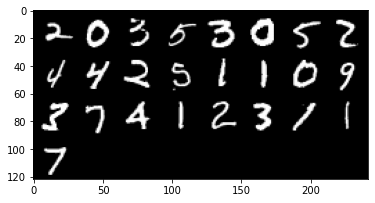

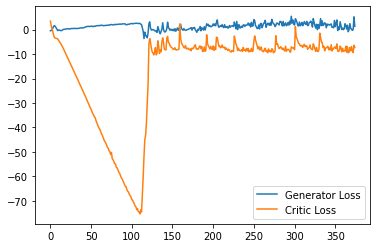

  0%|          | 0/469 [00:00<?, ?it/s]

Step 7550: Generator loss: 1.0783845968544483, critic loss: -6.9791663197875025


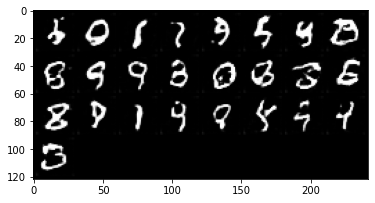

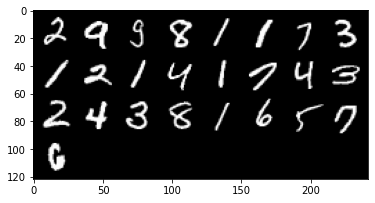

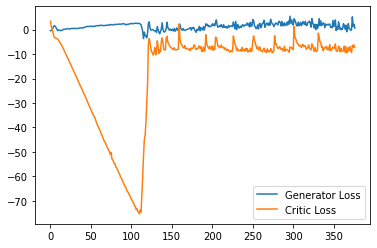

Step 7600: Generator loss: 0.9995637327432633, critic loss: -7.297421455264091


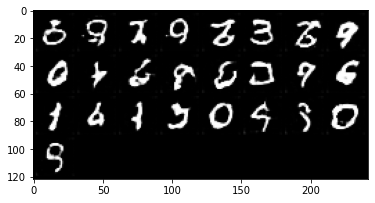

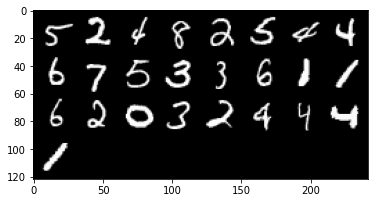

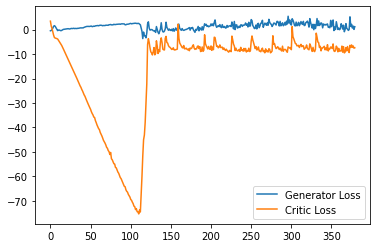

Step 7650: Generator loss: -0.5316789457201958, critic loss: -6.469173946380614


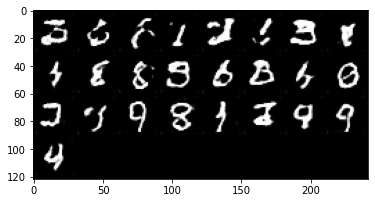

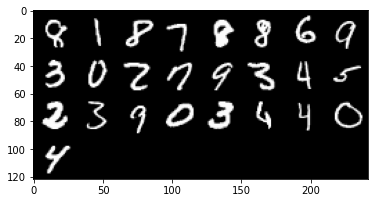

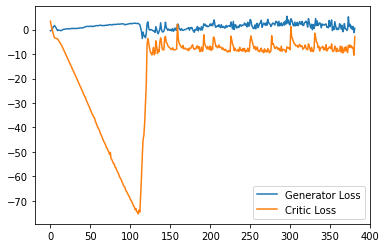

Step 7700: Generator loss: -1.5022568659484385, critic loss: -8.070385654330252


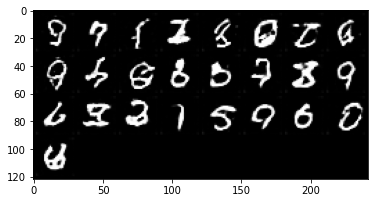

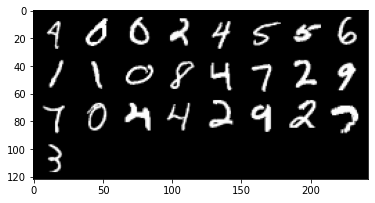

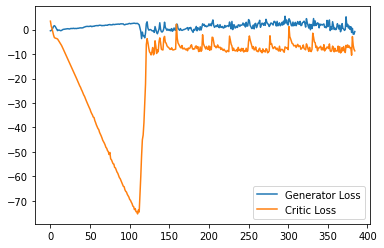

Step 7750: Generator loss: 0.06179769277572632, critic loss: -7.458889943838117


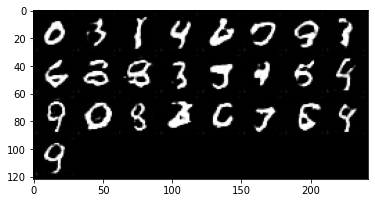

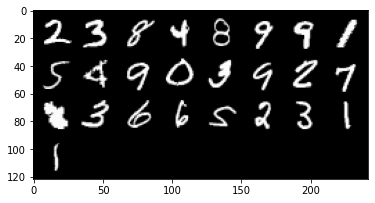

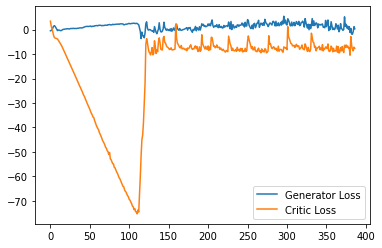

Step 7800: Generator loss: 1.336143111512065, critic loss: -7.66434887933731


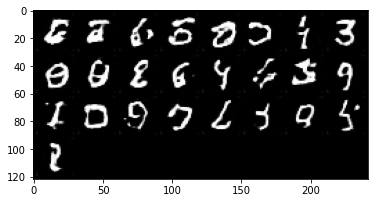

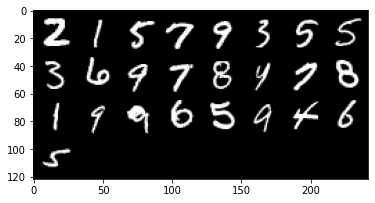

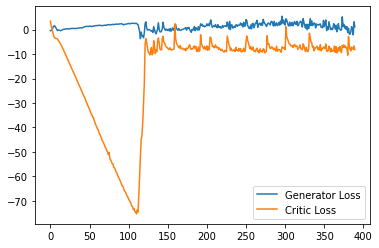

Step 7850: Generator loss: 0.5698258356750011, critic loss: -7.642988495111465


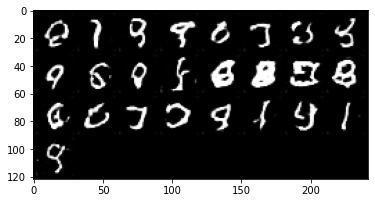

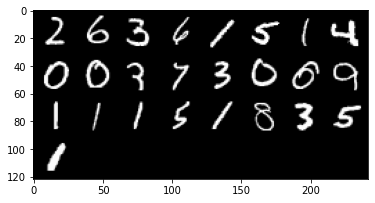

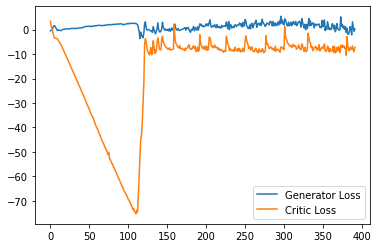

Step 7900: Generator loss: -1.0033640748262405, critic loss: -7.751961871623994


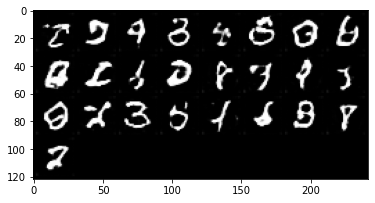

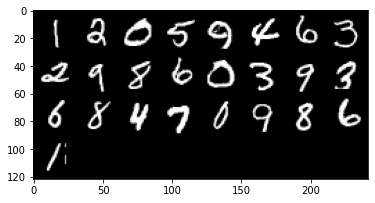

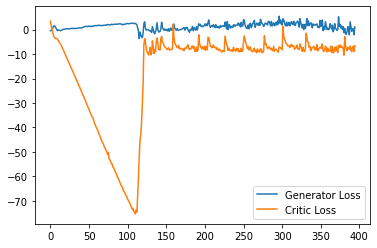

Step 7950: Generator loss: -0.640836157426238, critic loss: -8.40611801236868


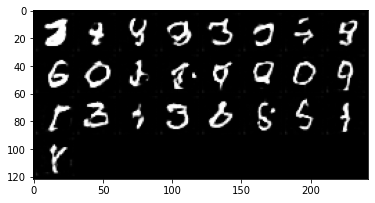

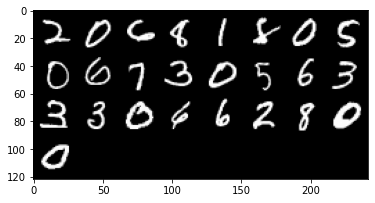

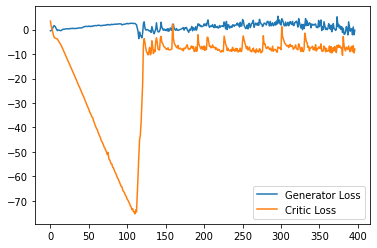

  0%|          | 0/469 [00:00<?, ?it/s]

Step 8000: Generator loss: 0.1654353192448616, critic loss: -8.003117958009245


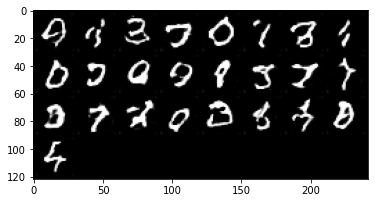

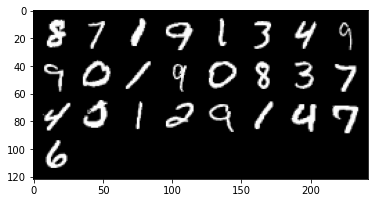

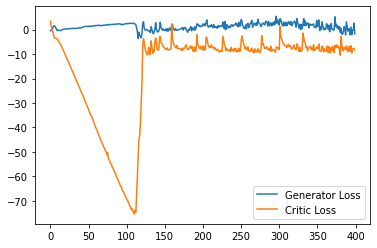

Step 8050: Generator loss: -0.35011780075728893, critic loss: -7.964127915740014


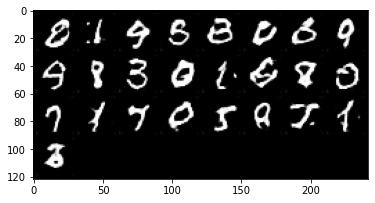

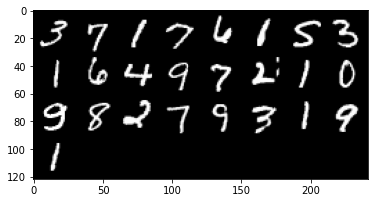

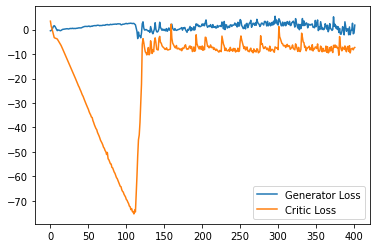

Step 8100: Generator loss: -1.264932256191969, critic loss: -8.968957282304764


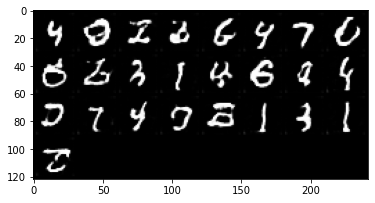

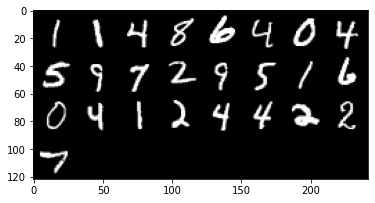

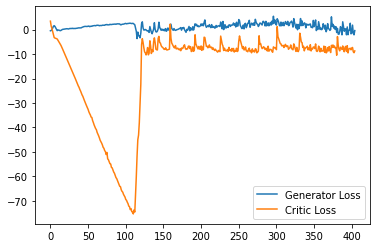

Step 8150: Generator loss: -0.4525502395629883, critic loss: -7.723329033970831


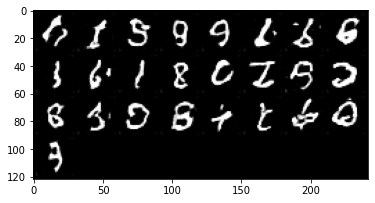

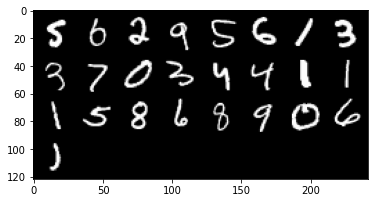

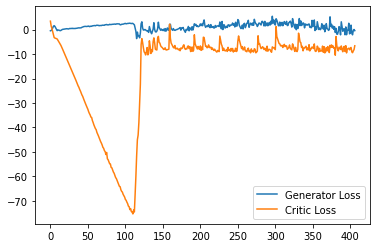

Step 8200: Generator loss: -0.7518181499838829, critic loss: -8.22852879190445


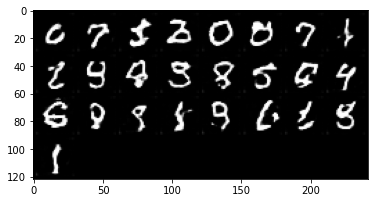

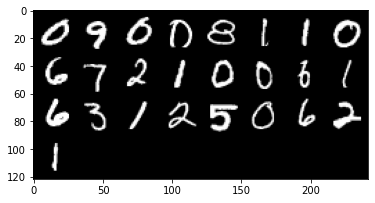

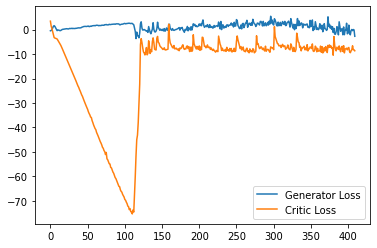

Step 8250: Generator loss: 0.09212883785367013, critic loss: -4.7799706329703335


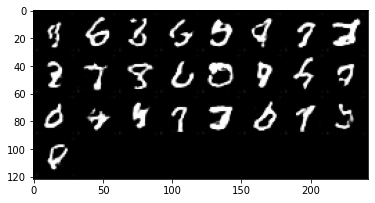

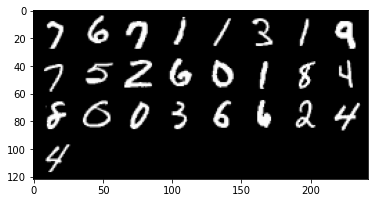

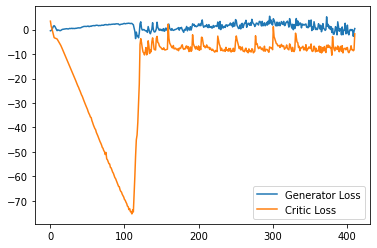

Step 8300: Generator loss: -0.6067875343561172, critic loss: -5.989788807094098


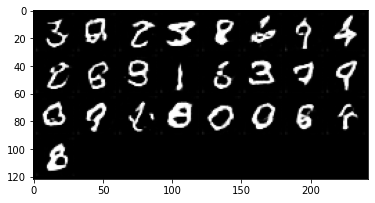

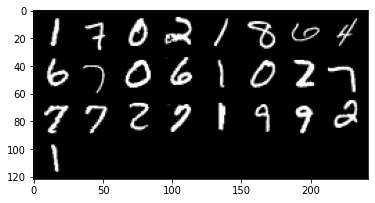

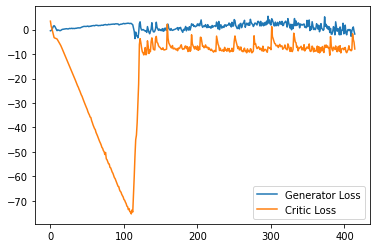

Step 8350: Generator loss: -0.38599147260189054, critic loss: -7.800055374622343


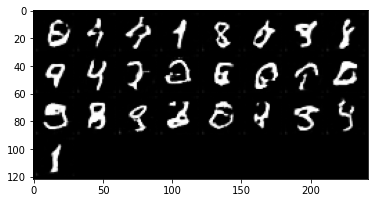

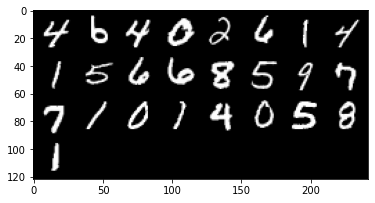

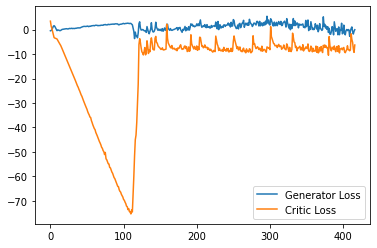

Step 8400: Generator loss: -0.32754971742630007, critic loss: -7.593255963921549


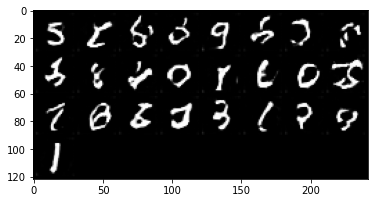

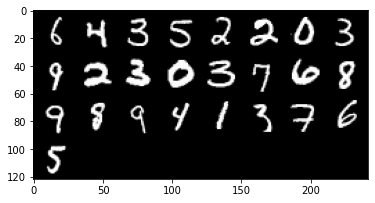

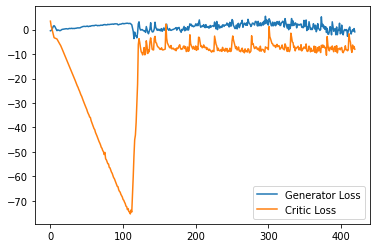

  0%|          | 0/469 [00:00<?, ?it/s]

Step 8450: Generator loss: -2.285278390944004, critic loss: -7.812611352086066


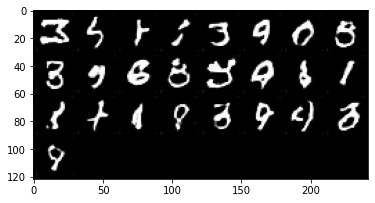

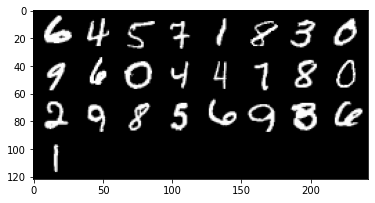

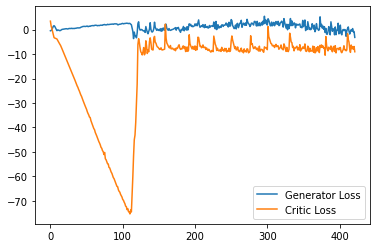

Step 8500: Generator loss: 0.6133914087712765, critic loss: -7.446648347795008


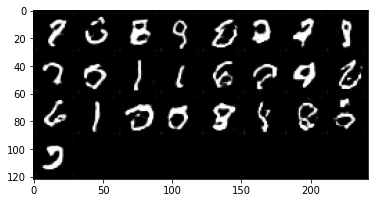

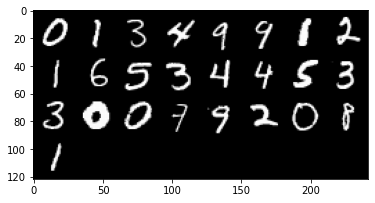

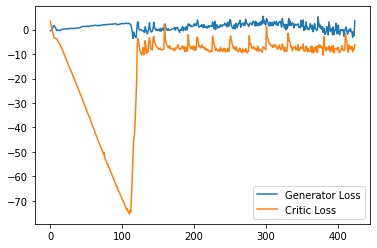

Step 8550: Generator loss: -0.33152791440486906, critic loss: -7.576425474643708


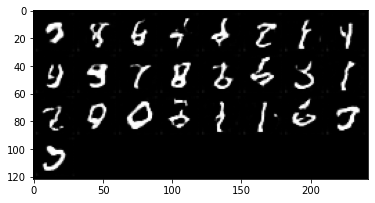

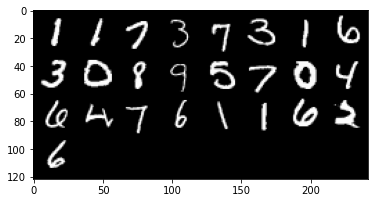

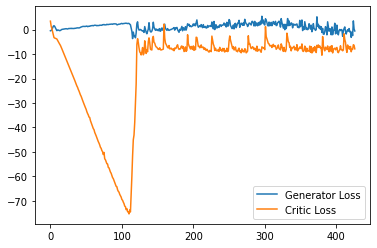

Step 8600: Generator loss: 0.3777333238720894, critic loss: -7.2767656957507105


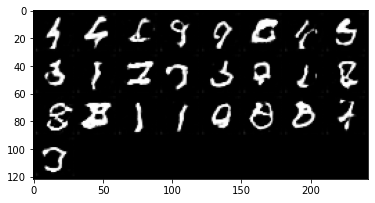

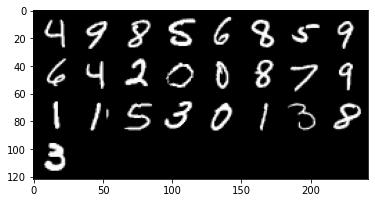

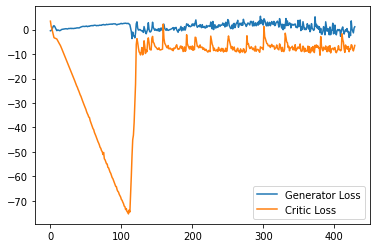

Step 8650: Generator loss: -2.1143068397045135, critic loss: -8.566552327990529


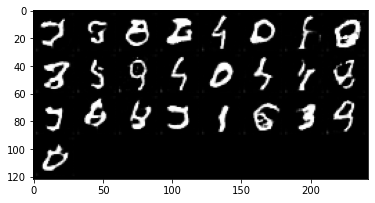

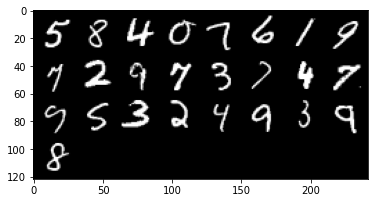

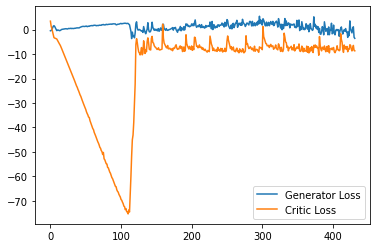

Step 8700: Generator loss: 0.7542754589021206, critic loss: -7.257307157397268


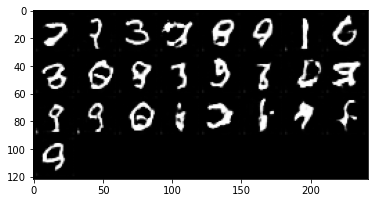

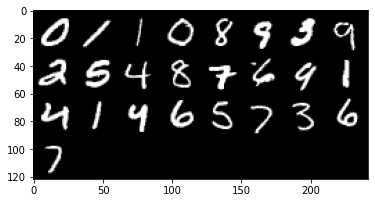

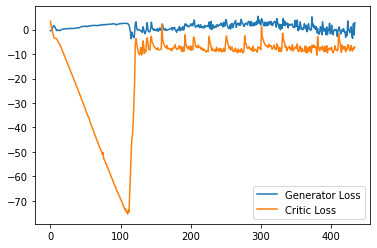

Step 8750: Generator loss: -1.0404735136777163, critic loss: -7.516999052524565


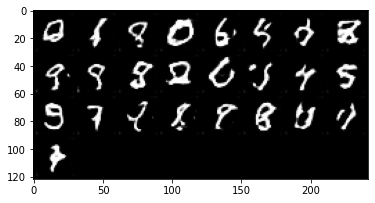

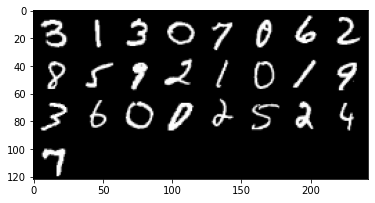

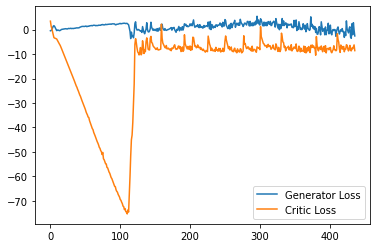

Step 8800: Generator loss: -0.6897786259651184, critic loss: -8.092513692378995


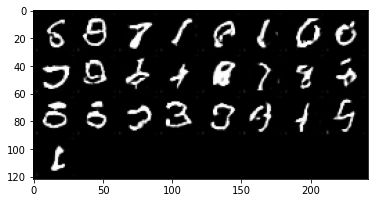

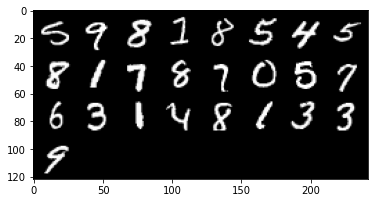

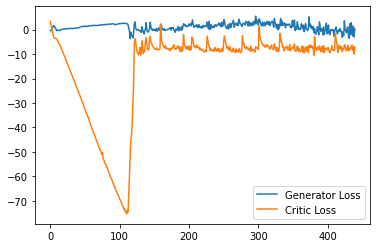

Step 8850: Generator loss: -0.9480660367012024, critic loss: -6.714902327895164


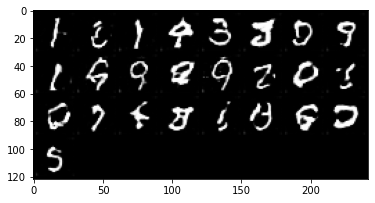

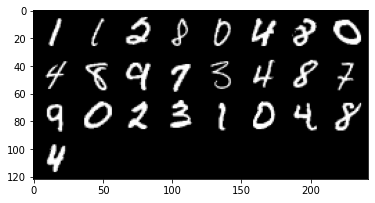

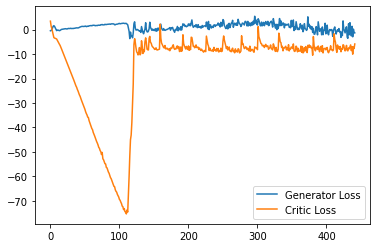

Step 8900: Generator loss: 0.8528238826990128, critic loss: -6.780180979251863


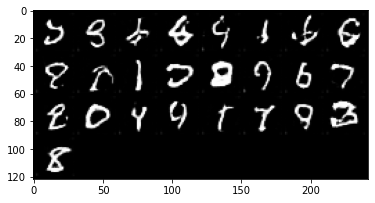

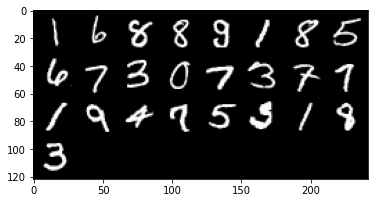

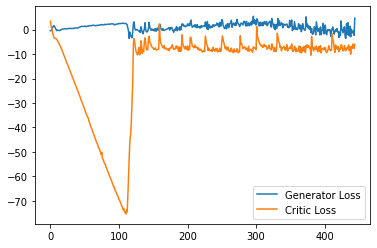

  0%|          | 0/469 [00:00<?, ?it/s]

Step 8950: Generator loss: 1.6255736814439297, critic loss: -6.809659355044364


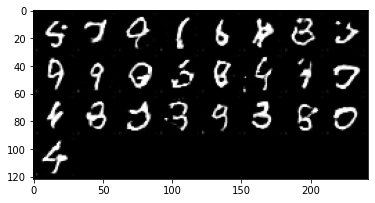

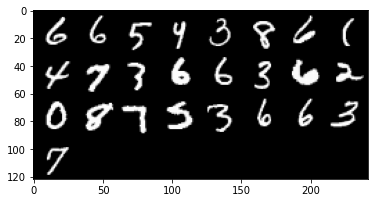

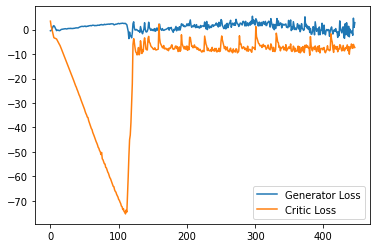

Step 9000: Generator loss: -1.9233475854992867, critic loss: -8.094937712430955


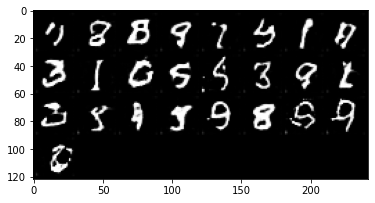

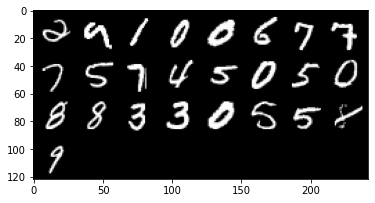

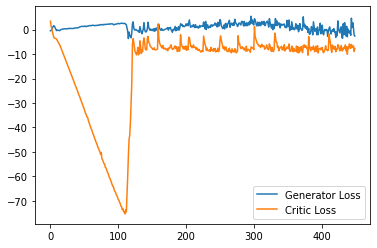

Step 9050: Generator loss: 0.8053311616182327, critic loss: -4.213414659261703


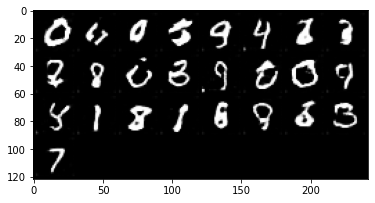

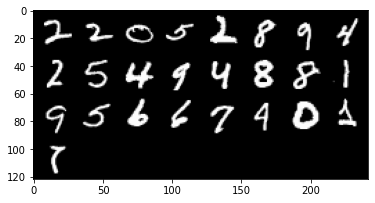

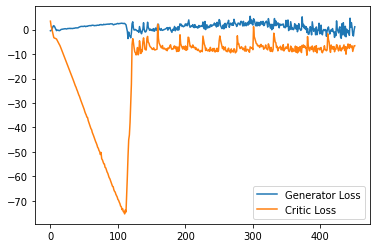

Step 9100: Generator loss: -0.7896658176183701, critic loss: -5.9419652618169785


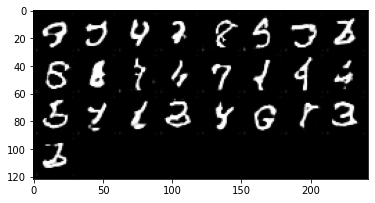

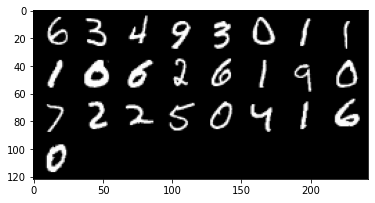

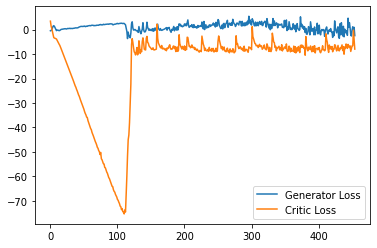

Step 9150: Generator loss: -1.3816067381203174, critic loss: -7.61199896979332


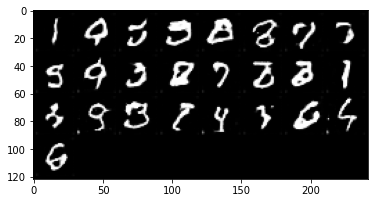

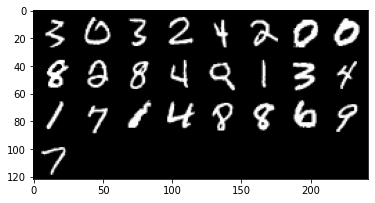

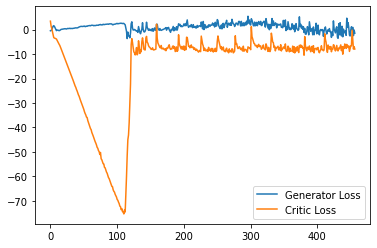

Step 9200: Generator loss: -0.4582242171466351, critic loss: -9.024471798181533


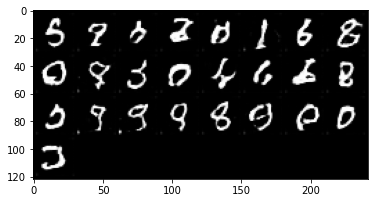

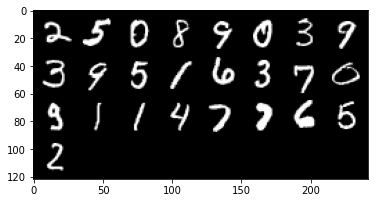

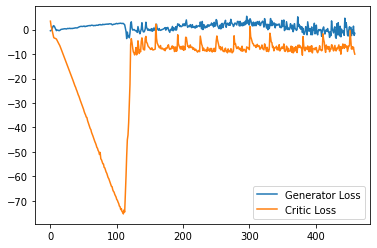

Step 9250: Generator loss: 0.7217834347486496, critic loss: -7.550102086007595


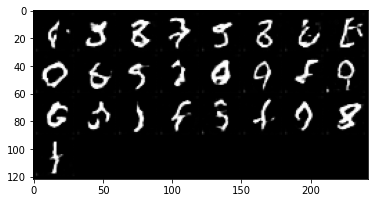

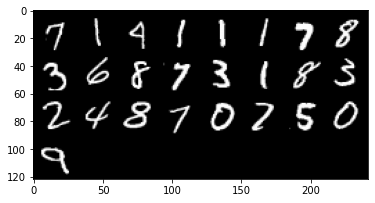

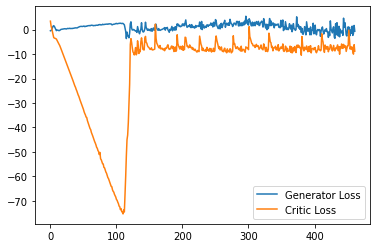

Step 9300: Generator loss: -0.3660401824116707, critic loss: -8.113536331892014


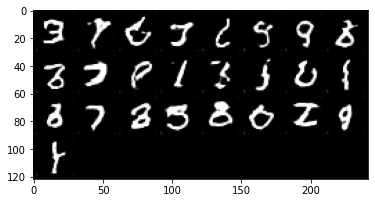

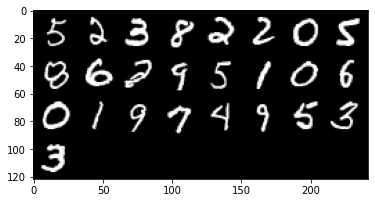

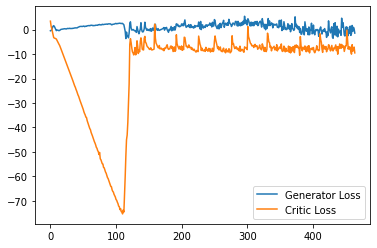

Step 9350: Generator loss: 0.3971556894481182, critic loss: -8.62545028531551


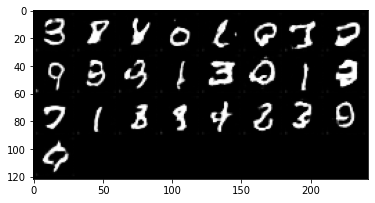

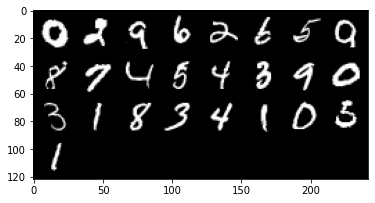

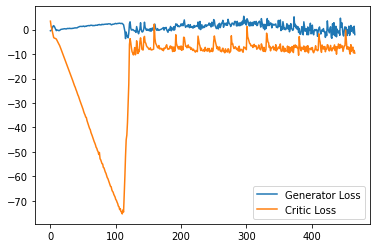

  0%|          | 0/469 [00:00<?, ?it/s]

Step 9400: Generator loss: -1.4289661356806755, critic loss: -8.249115125656125


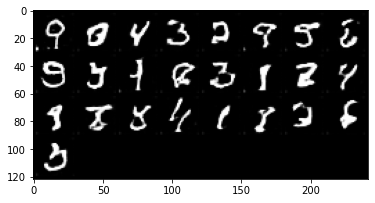

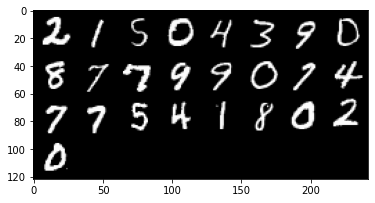

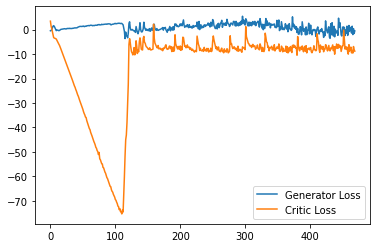

Step 9450: Generator loss: 1.3011374810338021, critic loss: -9.324689461112023


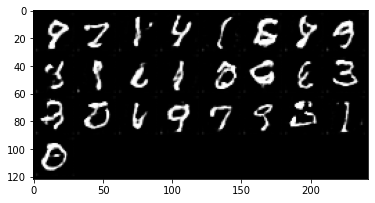

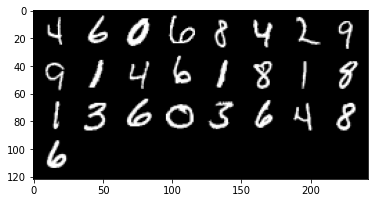

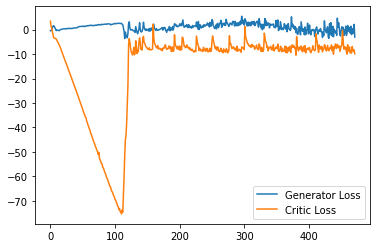

Step 9500: Generator loss: 1.1974280235171317, critic loss: -5.7597800781726844


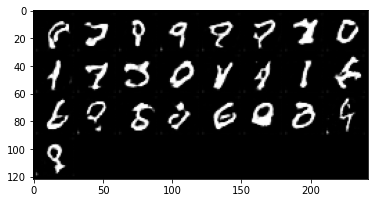

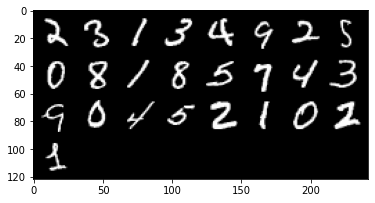

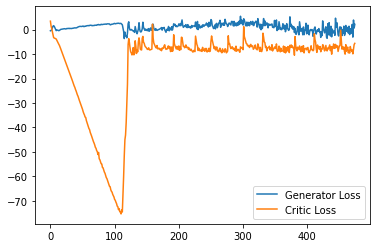

Step 9550: Generator loss: 0.7189190939068795, critic loss: -7.769490068137646


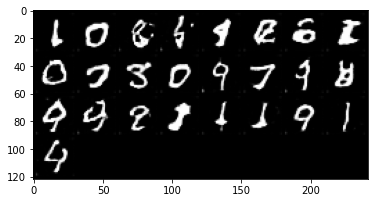

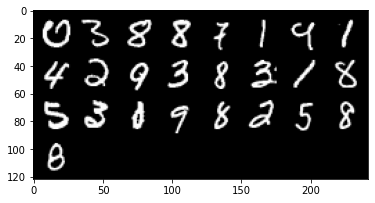

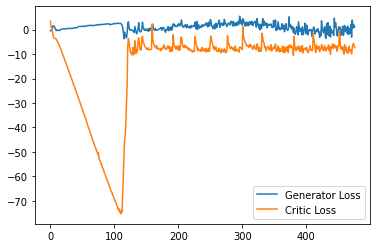

Step 9600: Generator loss: 0.12806023485958576, critic loss: -7.076722052693367


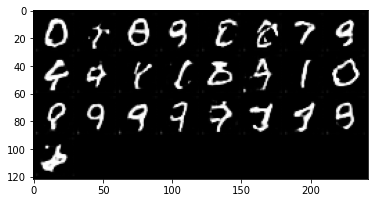

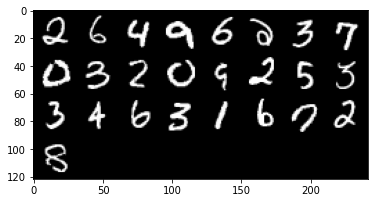

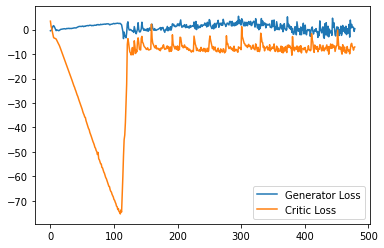

Step 9650: Generator loss: -0.18287602663040162, critic loss: -7.301030472755432


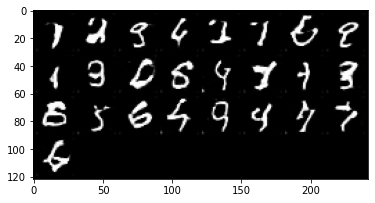

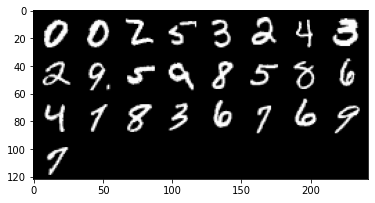

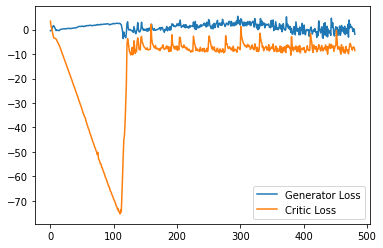

Step 9700: Generator loss: -0.19455496430397035, critic loss: -8.31251037222147


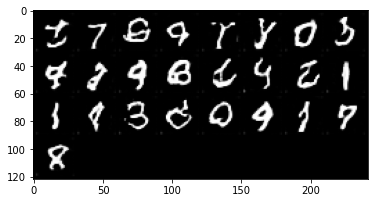

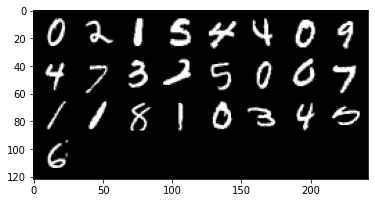

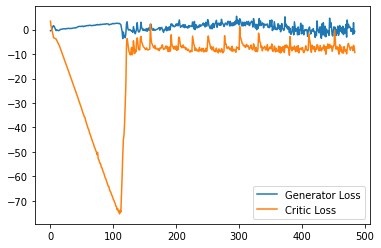

Step 9750: Generator loss: -1.5854549396038056, critic loss: -9.795485432863234


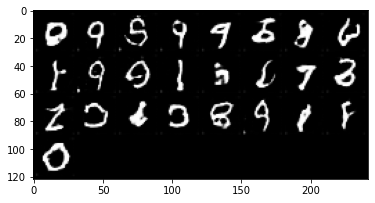

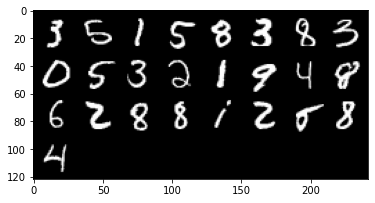

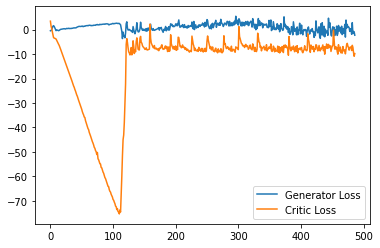

Step 9800: Generator loss: 1.367731680572033, critic loss: -6.772657784938814


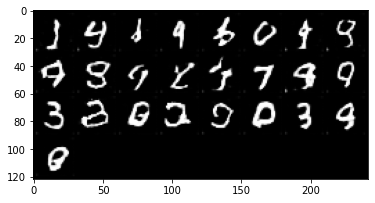

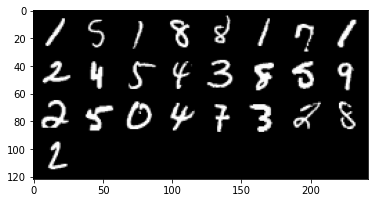

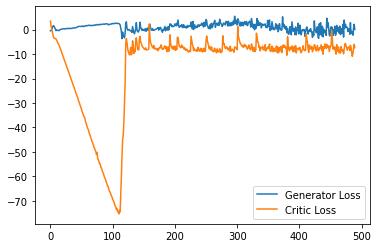

  0%|          | 0/469 [00:00<?, ?it/s]

Step 9850: Generator loss: 2.5283130875974895, critic loss: -6.5994576956033715


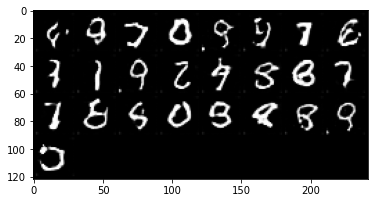

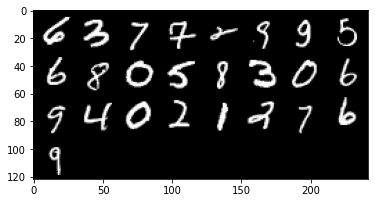

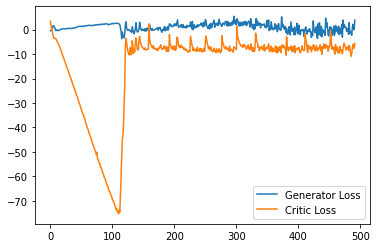

Step 9900: Generator loss: 0.8479809284210205, critic loss: -6.683854863762855


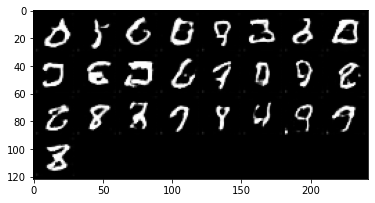

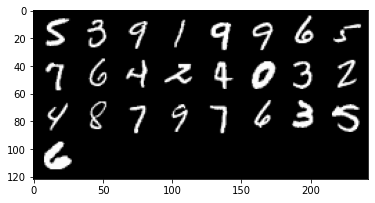

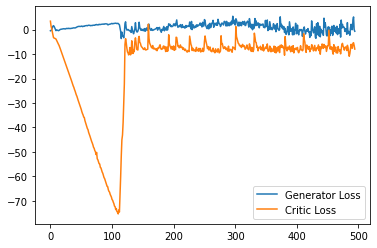

Step 9950: Generator loss: -0.056052685976028443, critic loss: -5.677350976467132


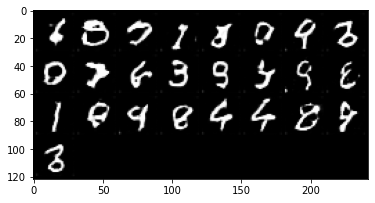

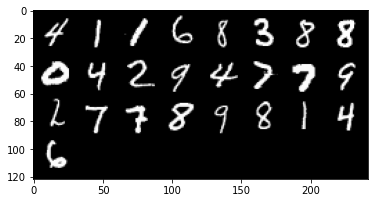

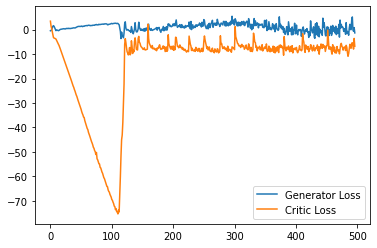

Step 10000: Generator loss: 1.1357236738502978, critic loss: -7.622090056180955


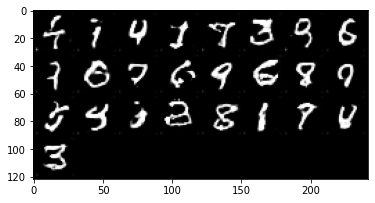

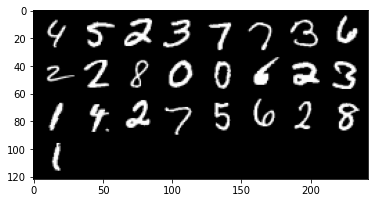

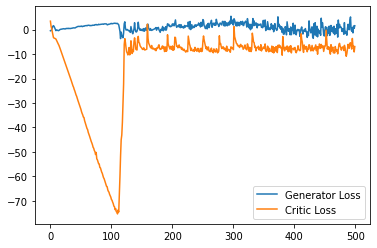

Step 10050: Generator loss: -0.034901646971702574, critic loss: -8.484127462208273


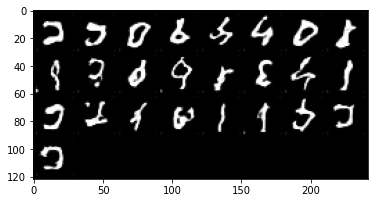

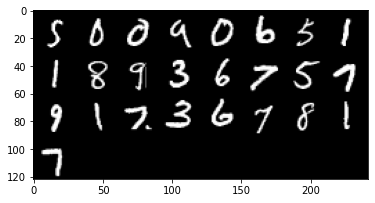

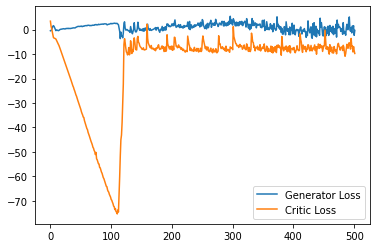

Step 10100: Generator loss: 2.2987527987360954, critic loss: -5.729880567073823


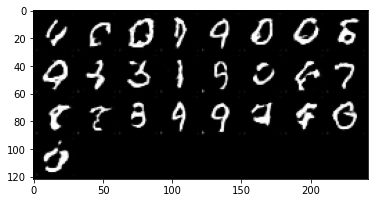

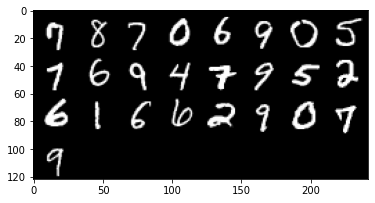

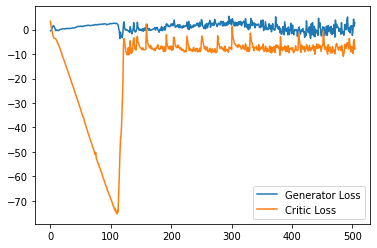

Step 10150: Generator loss: -0.3718358014523983, critic loss: -7.290830139398574


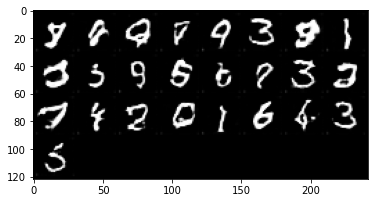

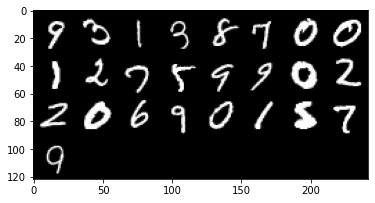

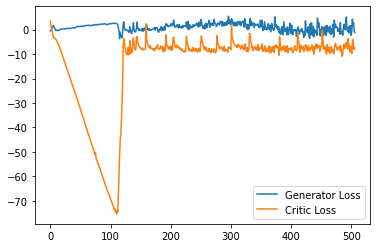

Step 10200: Generator loss: -0.41604306414723397, critic loss: -8.951812292337415


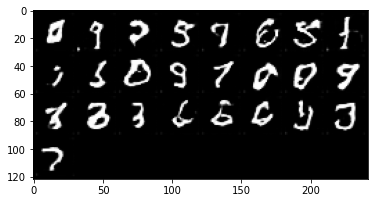

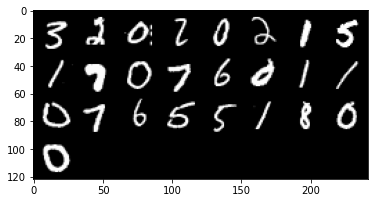

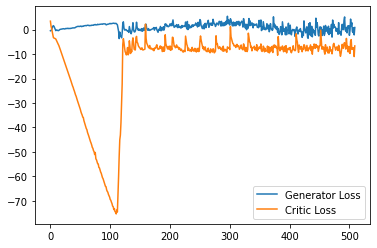

Step 10250: Generator loss: -1.3218342912197114, critic loss: -9.338799816012383


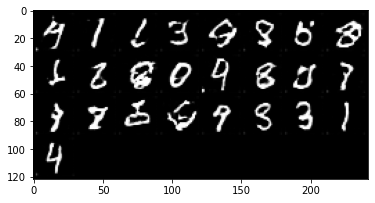

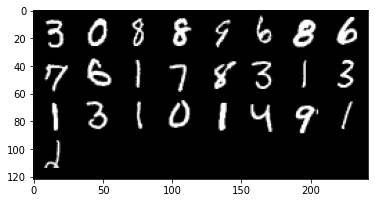

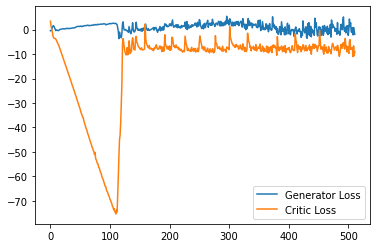

Step 10300: Generator loss: -1.0393833312392236, critic loss: -9.151669099211691


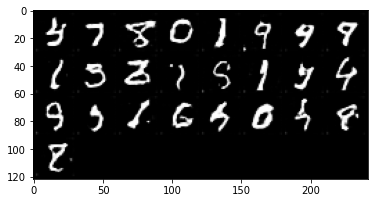

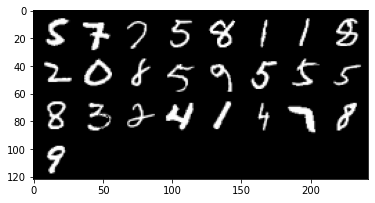

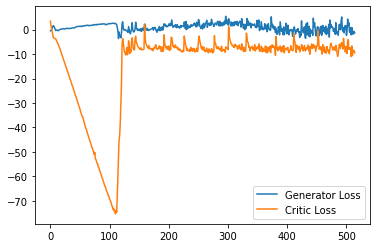

  0%|          | 0/469 [00:00<?, ?it/s]

Step 10350: Generator loss: 1.5789021891355515, critic loss: -3.4332505856752387


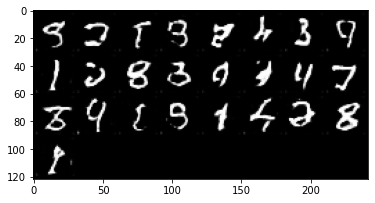

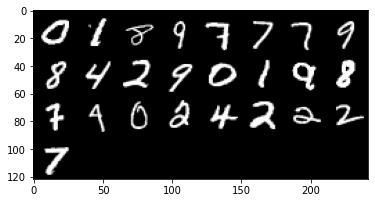

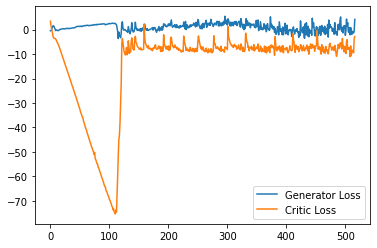

Step 10400: Generator loss: 1.322819504365325, critic loss: -6.6575985277891165


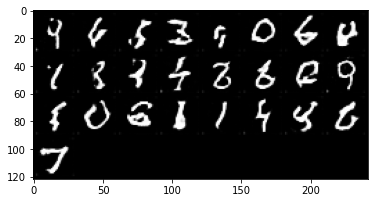

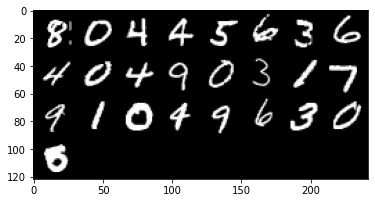

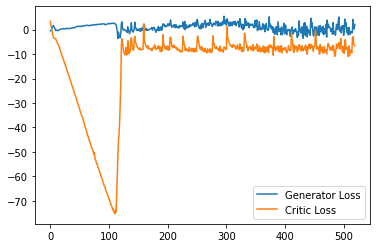

Step 10450: Generator loss: -1.335254812836647, critic loss: -8.077128966867926


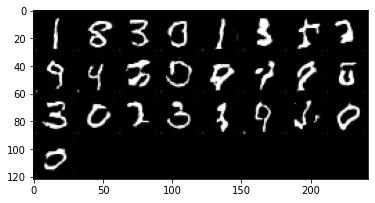

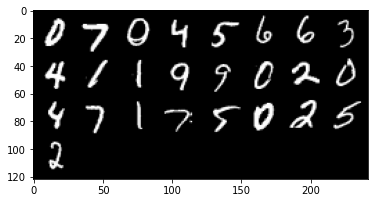

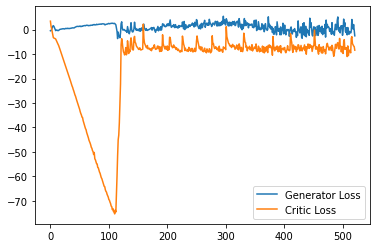

Step 10500: Generator loss: 1.1216599556803704, critic loss: -7.716691231489182


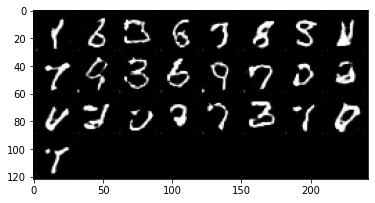

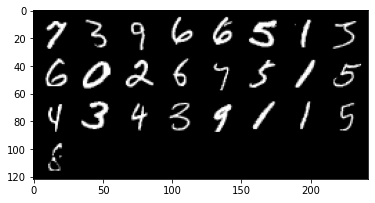

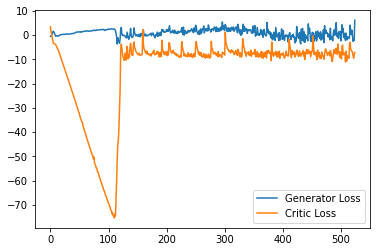

Step 10550: Generator loss: 2.0654649344831704, critic loss: -6.054927138090132


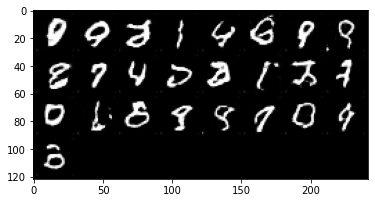

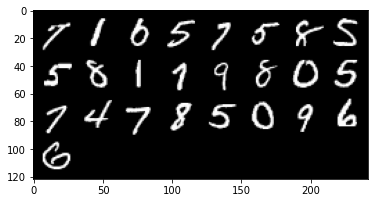

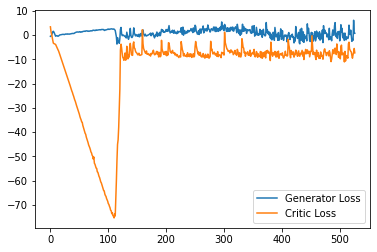

Step 10600: Generator loss: 1.5305154752731323, critic loss: -7.479579523026944


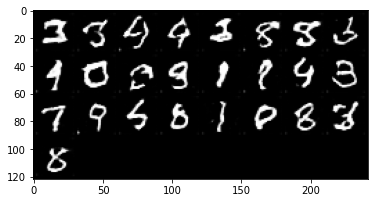

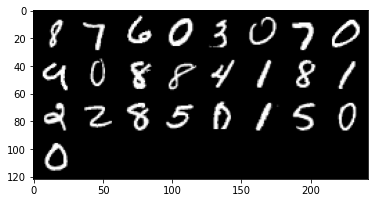

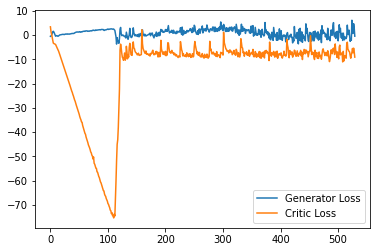

Step 10650: Generator loss: 1.4450326615571976, critic loss: -6.2593452697396295


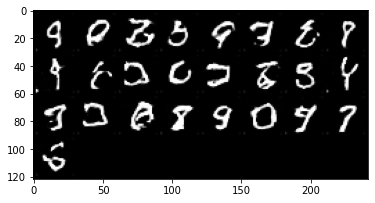

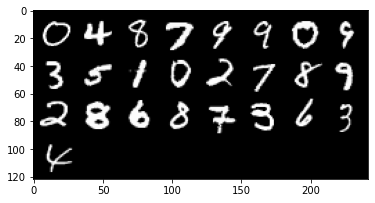

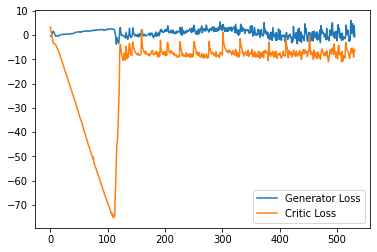

Step 10700: Generator loss: 4.661353514939546, critic loss: -6.591097178936004


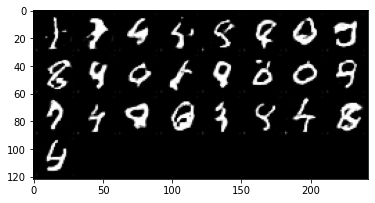

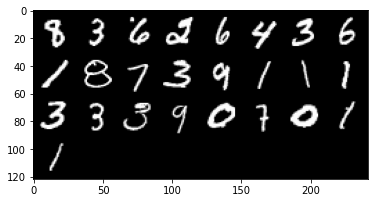

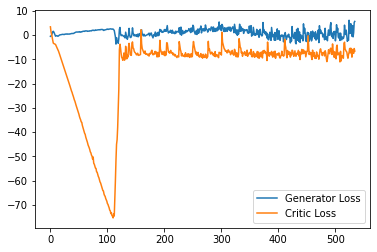

Step 10750: Generator loss: 3.0986573742330075, critic loss: -7.133475972533224


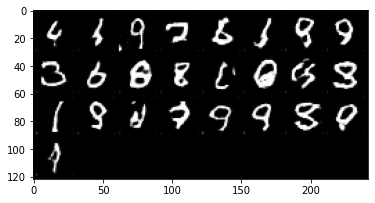

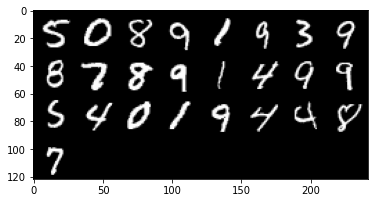

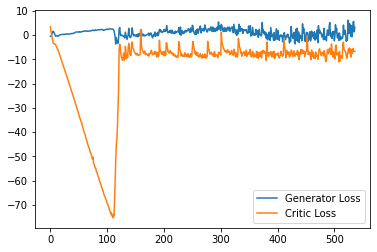

  0%|          | 0/469 [00:00<?, ?it/s]

Step 10800: Generator loss: 0.5149224942922592, critic loss: -7.822855006575583


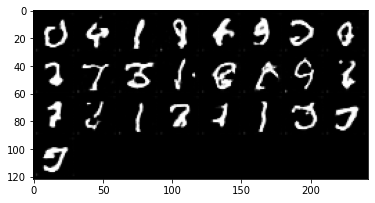

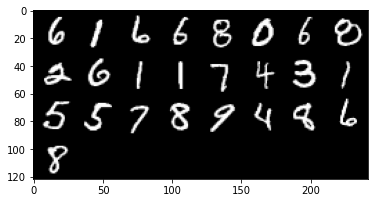

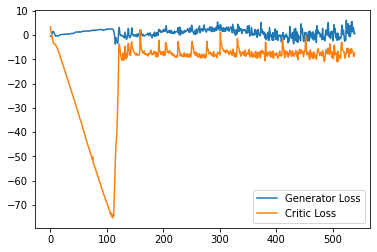

Step 10850: Generator loss: 1.220912456214428, critic loss: -7.983978041708467


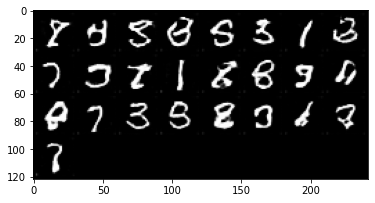

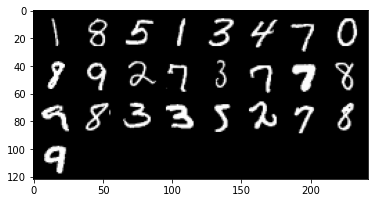

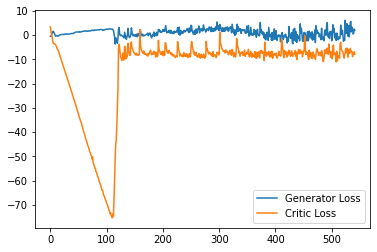

Step 10900: Generator loss: 1.5266407293081283, critic loss: -8.401221992611884


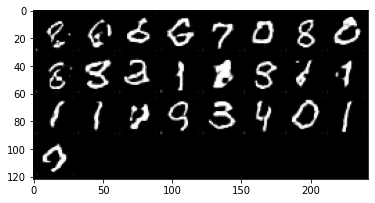

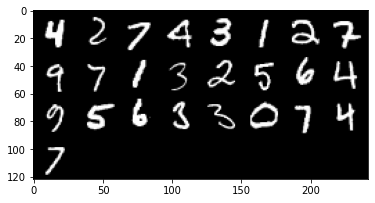

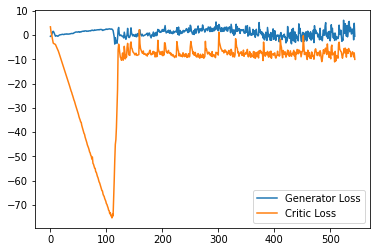

Step 10950: Generator loss: 1.9245704436302185, critic loss: -8.054596831321716


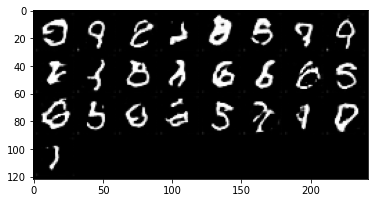

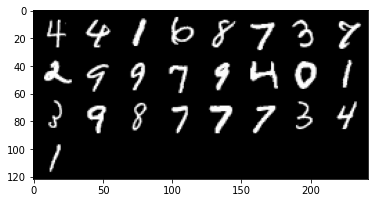

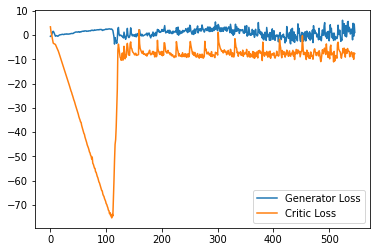

Step 11000: Generator loss: 4.520901643037796, critic loss: -2.3767175641059866


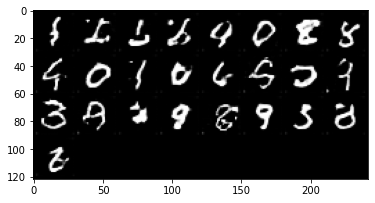

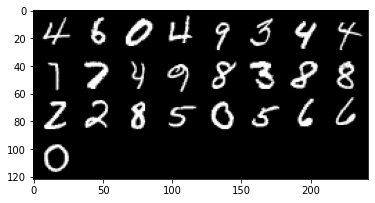

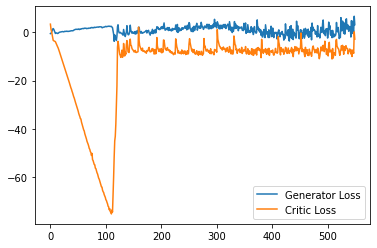

Step 11050: Generator loss: 1.3974565547704696, critic loss: -4.977957914471627


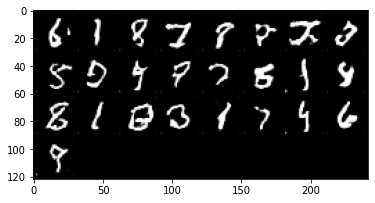

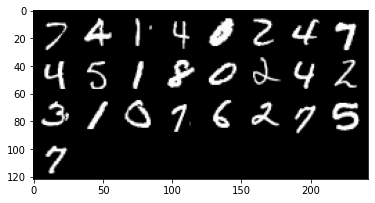

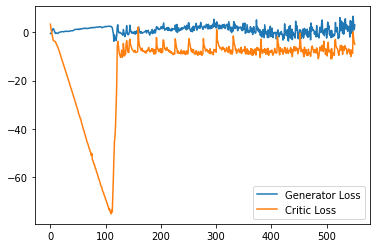

Step 11100: Generator loss: 1.7866440817713738, critic loss: -6.464297379612919


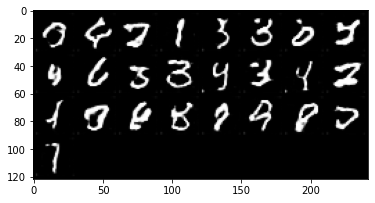

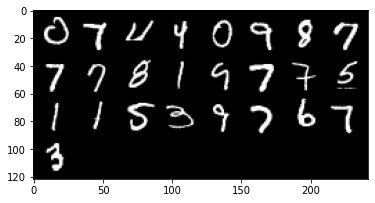

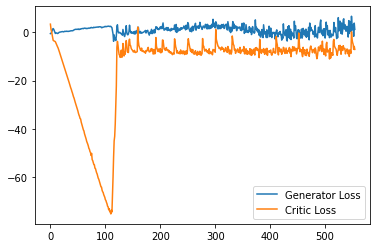

Step 11150: Generator loss: 1.1090592514723538, critic loss: -7.153709088027476


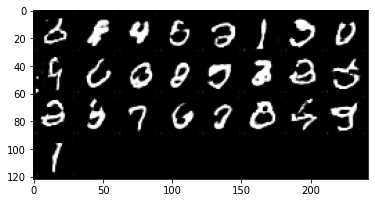

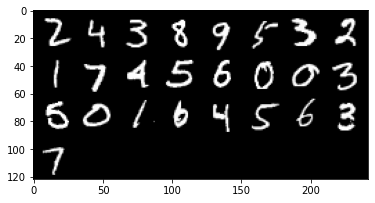

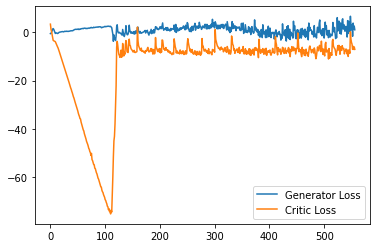

Step 11200: Generator loss: -1.5033203166723252, critic loss: -9.06322377002239


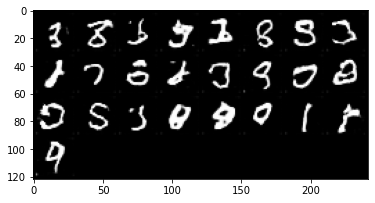

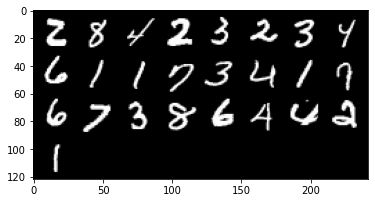

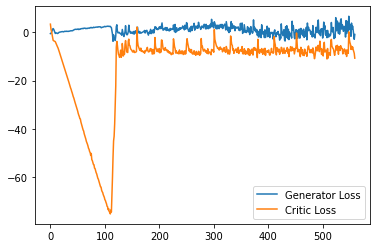

Step 11250: Generator loss: -0.22853895604610444, critic loss: -7.984054751276969


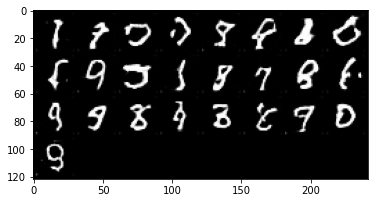

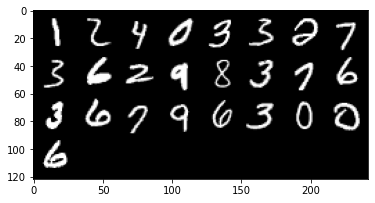

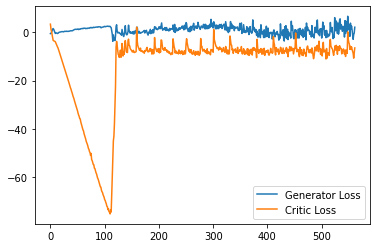

  0%|          | 0/469 [00:00<?, ?it/s]

Step 11300: Generator loss: 1.4900829416513444, critic loss: -7.275993541121482


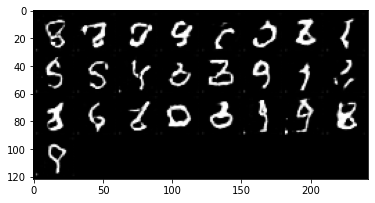

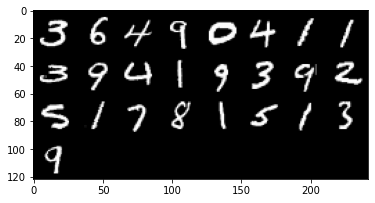

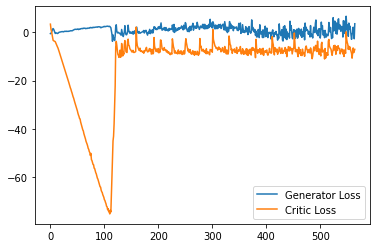

Step 11350: Generator loss: 0.9054691255092621, critic loss: -7.109855736494062


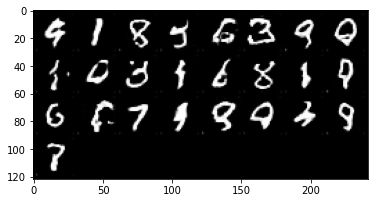

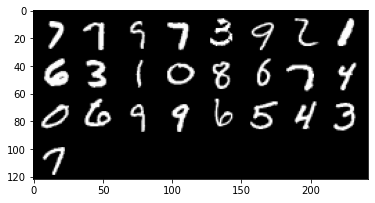

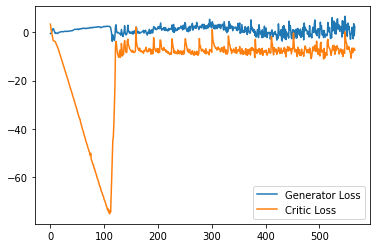

Step 11400: Generator loss: 2.3088736858963967, critic loss: -7.008490148305893


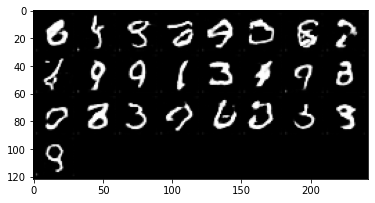

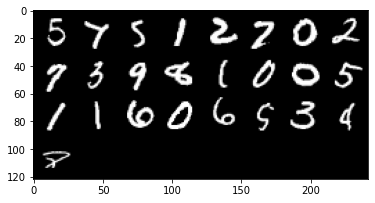

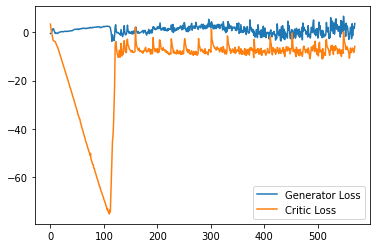

Step 11450: Generator loss: 1.8405331000685692, critic loss: -7.025753062605856


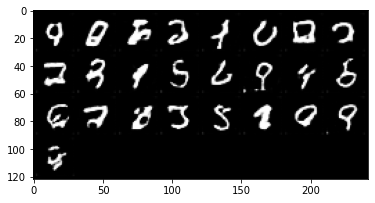

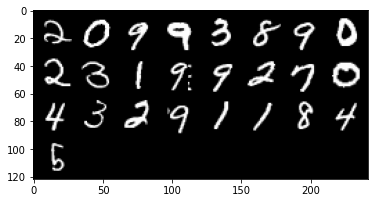

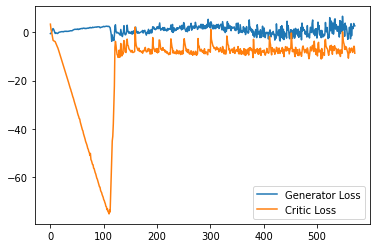

Step 11500: Generator loss: 0.7209411589801311, critic loss: -7.048510094523429


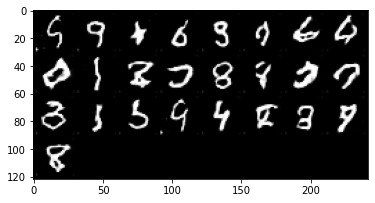

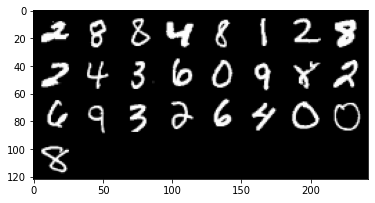

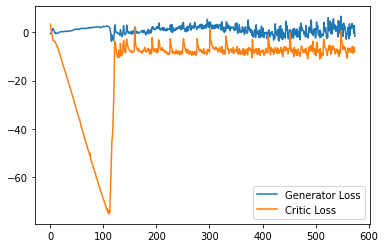

Step 11550: Generator loss: 2.276853293776512, critic loss: -6.784163306951523


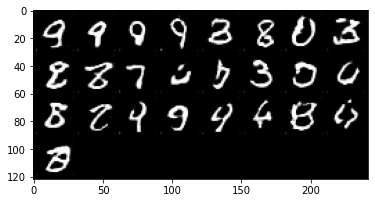

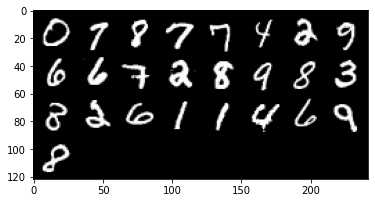

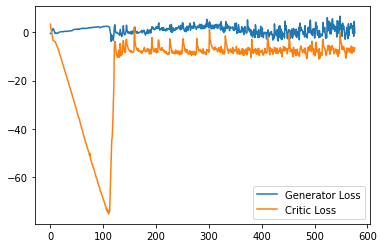

Step 11600: Generator loss: 3.0887733256816863, critic loss: -6.63033316397667


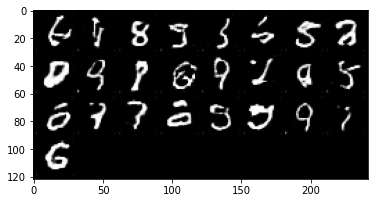

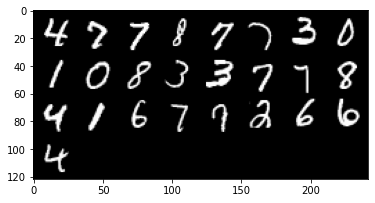

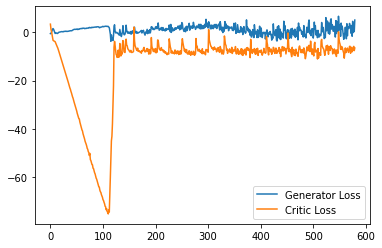

Step 11650: Generator loss: 2.0737546145915986, critic loss: -5.47027049469948


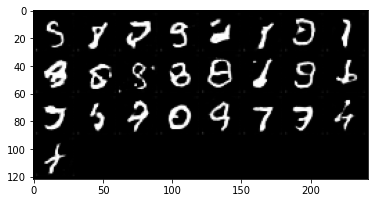

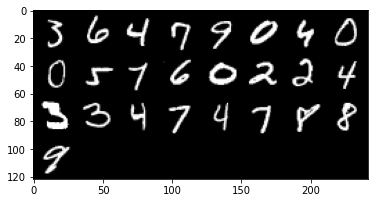

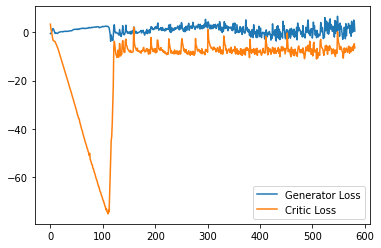

Step 11700: Generator loss: 0.84253593146801, critic loss: -5.312251705110074


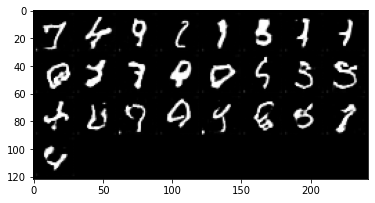

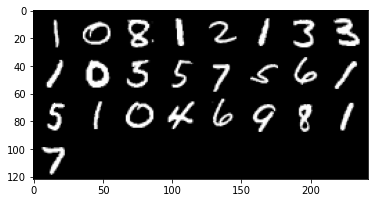

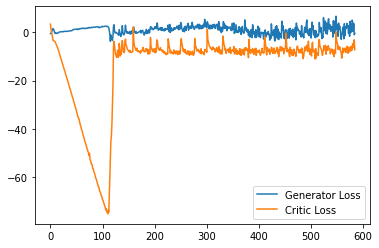

  0%|          | 0/469 [00:00<?, ?it/s]

Step 11750: Generator loss: 0.28472524173557756, critic loss: -7.801058726668357


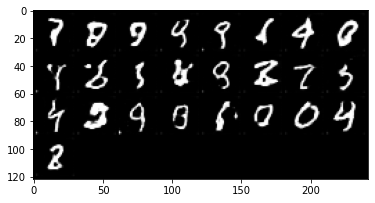

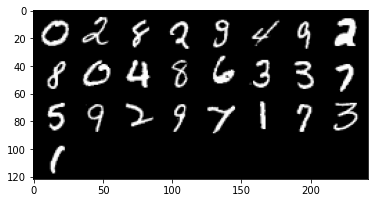

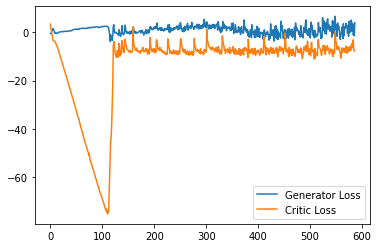

Step 11800: Generator loss: 2.664186129570007, critic loss: -7.339355770826341


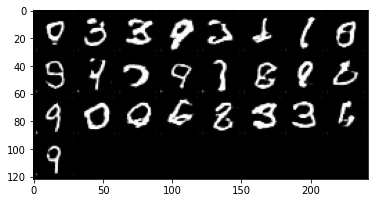

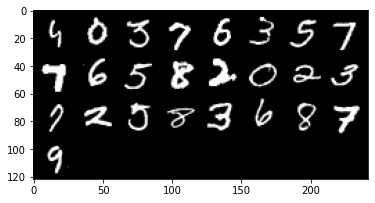

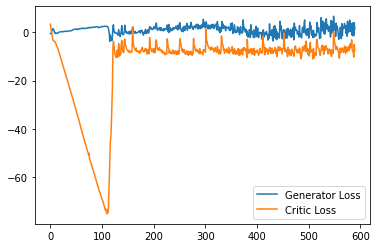

Step 11850: Generator loss: -0.48068330526351927, critic loss: -9.064455592215058


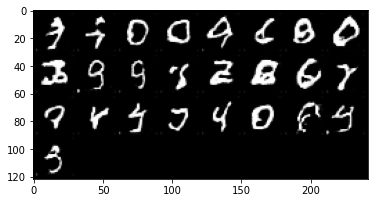

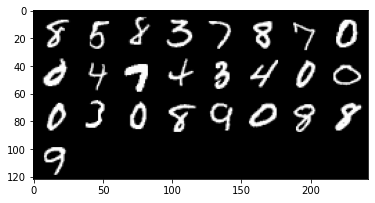

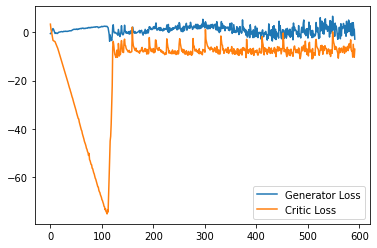

Step 11900: Generator loss: -0.020145951509475707, critic loss: -7.849072603940965


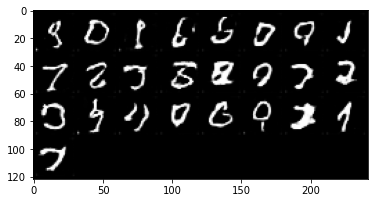

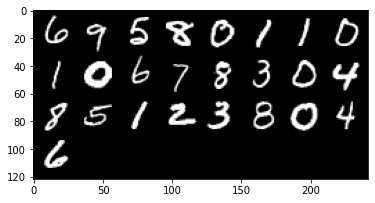

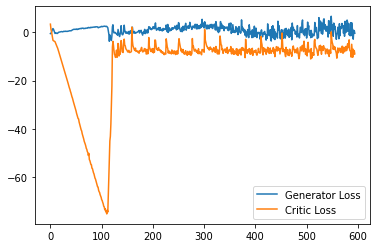

Step 11950: Generator loss: 2.5385654498636723, critic loss: -6.508892677545548


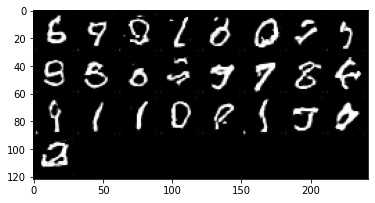

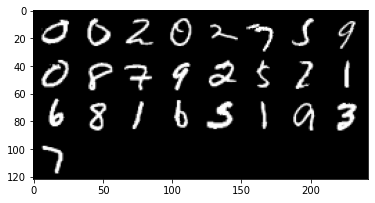

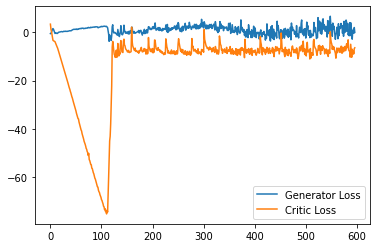

Step 12000: Generator loss: -0.9106914556026459, critic loss: -7.588383264184


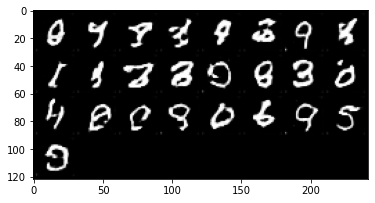

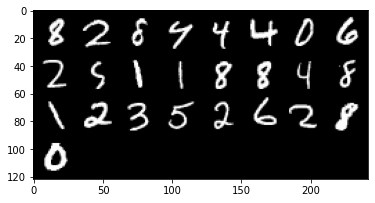

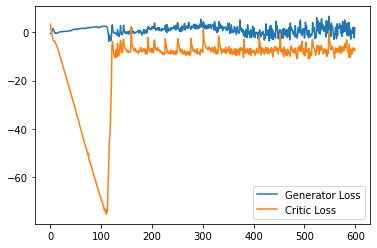

Step 12050: Generator loss: 1.0086169564723968, critic loss: -7.252234263658525


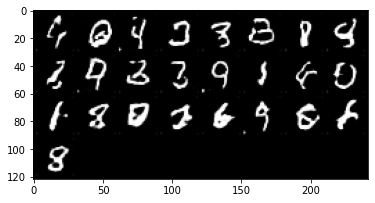

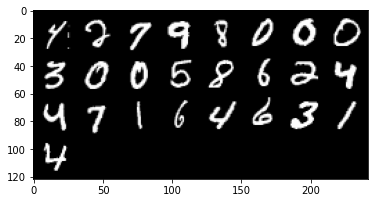

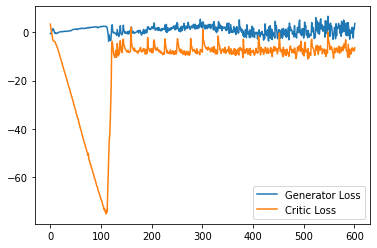

Step 12100: Generator loss: 2.4744655466079712, critic loss: -5.394172585606575


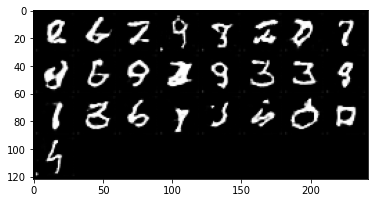

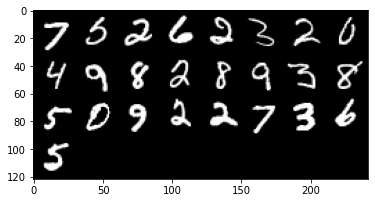

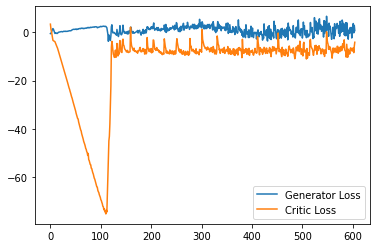

Step 12150: Generator loss: 2.3021710681915284, critic loss: -6.439882709264757


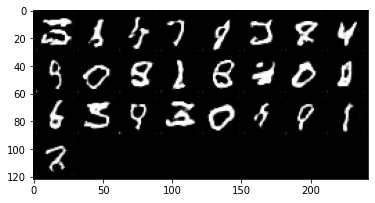

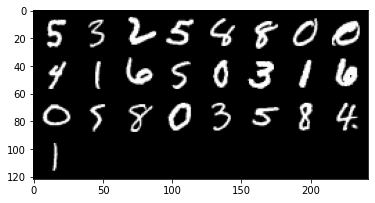

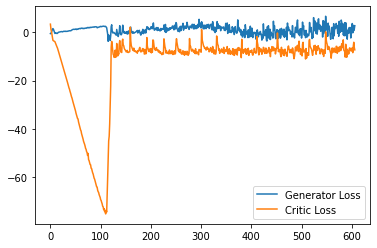

  0%|          | 0/469 [00:00<?, ?it/s]

Step 12200: Generator loss: 1.7928938221931459, critic loss: -6.92617927265167


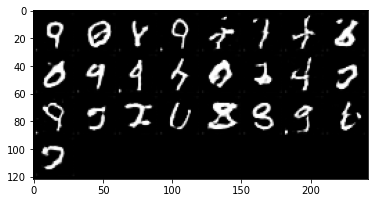

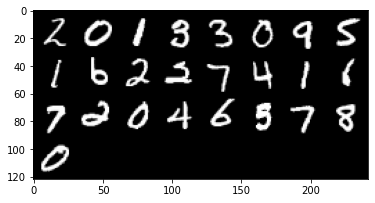

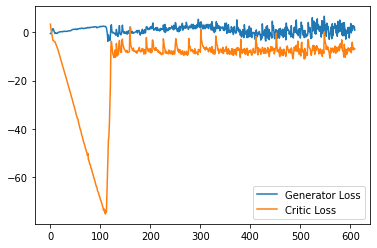

Step 12250: Generator loss: 2.504482245147228, critic loss: -7.3018719193339345


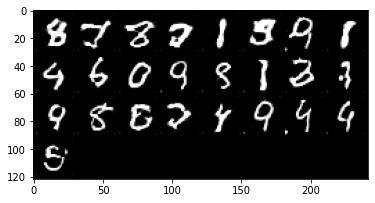

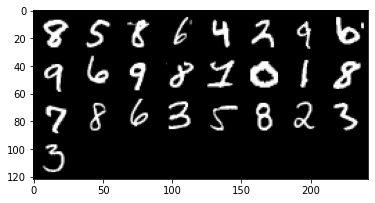

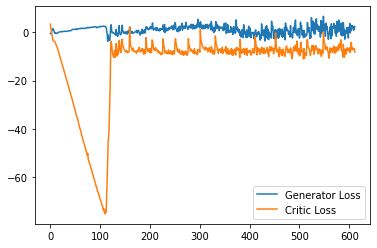

Step 12300: Generator loss: 3.3110586661100387, critic loss: -6.449374278485774


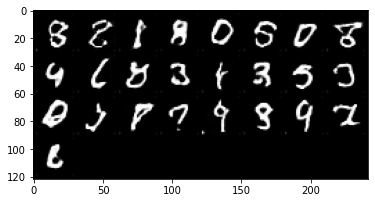

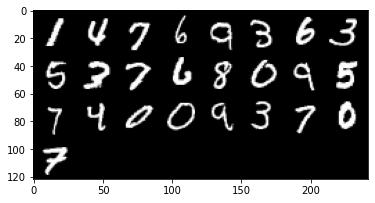

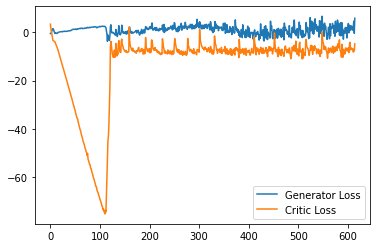

Step 12350: Generator loss: 0.39122783482074736, critic loss: -8.001637523889542


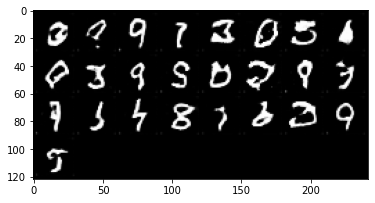

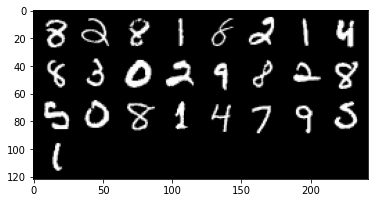

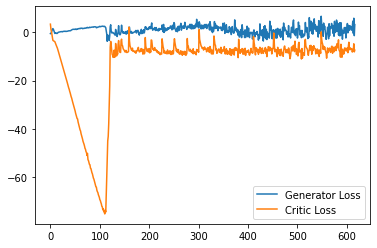

Step 12400: Generator loss: -0.6914031565189361, critic loss: -8.624904012084006


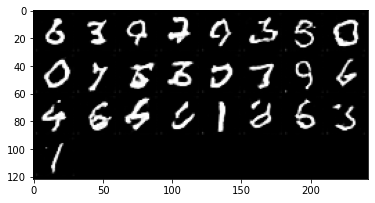

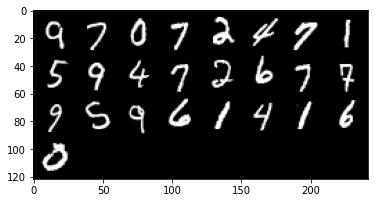

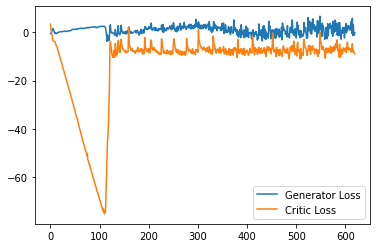

Step 12450: Generator loss: 0.3541344100236893, critic loss: -7.482068702876568


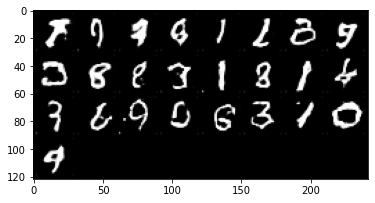

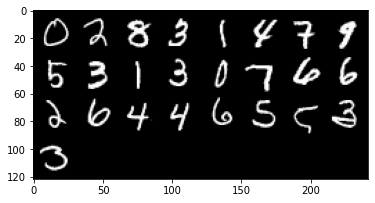

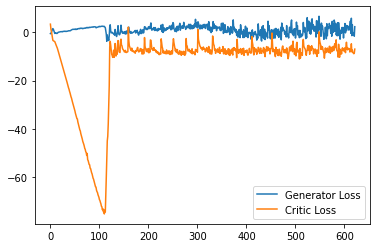

Step 12500: Generator loss: 2.5184878414869307, critic loss: -6.296478737115859


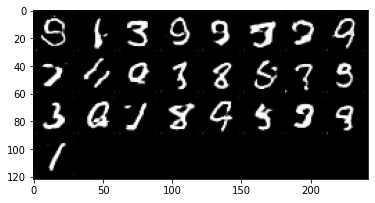

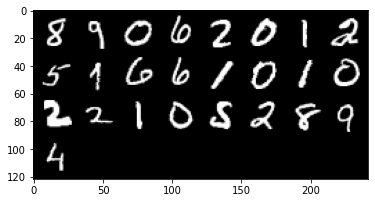

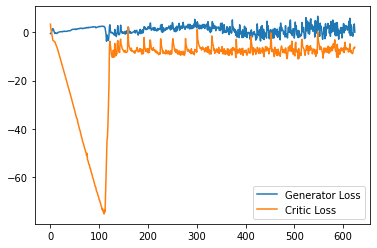

Step 12550: Generator loss: 0.16658543199300765, critic loss: -7.889550556004048


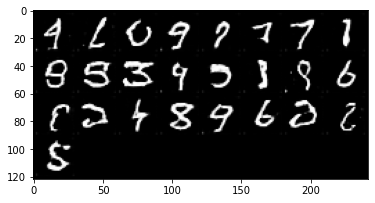

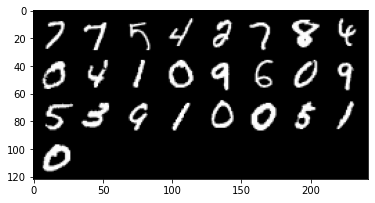

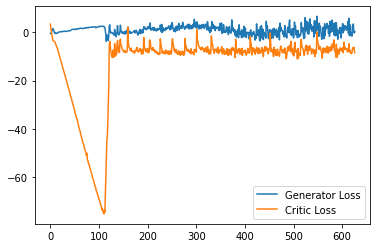

Step 12600: Generator loss: -0.2542469823360443, critic loss: -7.7179391374588


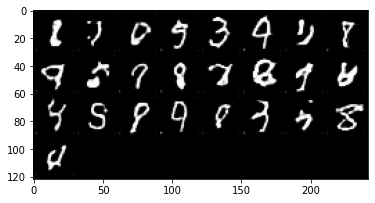

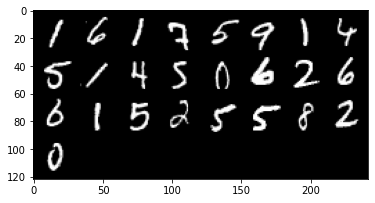

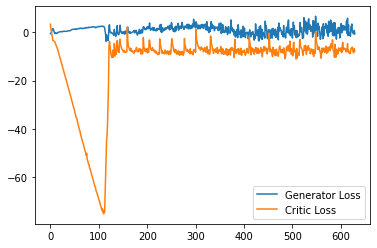

Step 12650: Generator loss: -1.3220004019141198, critic loss: -7.686284666538239


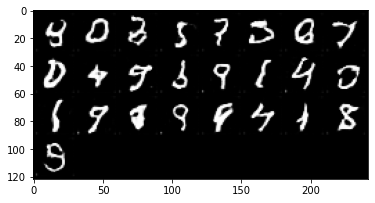

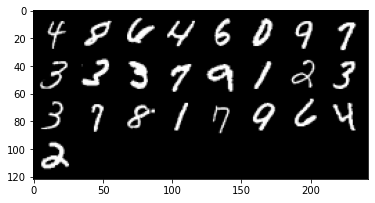

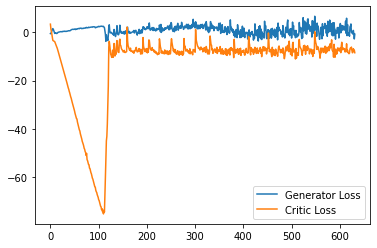

  0%|          | 0/469 [00:00<?, ?it/s]

Step 12700: Generator loss: 2.8391905263066293, critic loss: -5.334890590071678


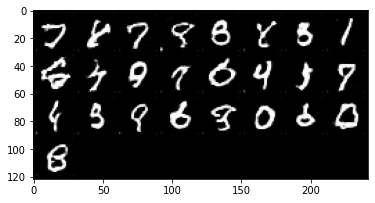

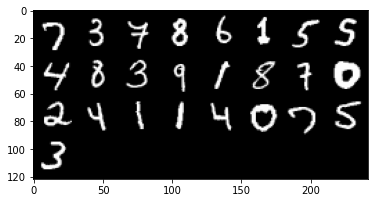

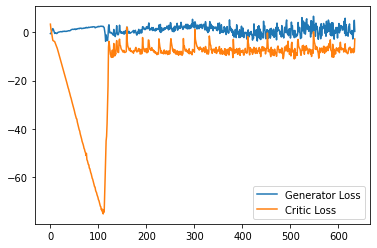

Step 12750: Generator loss: 3.5300547808408735, critic loss: -4.3580291361808765


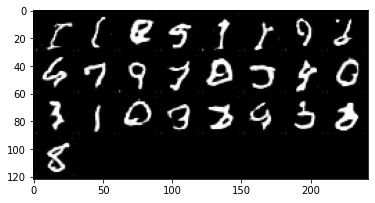

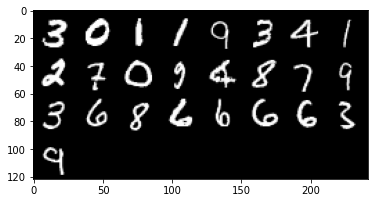

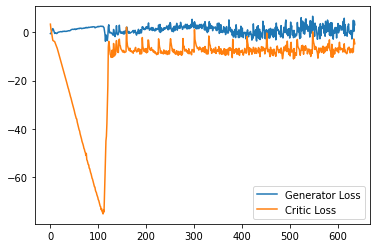

Step 12800: Generator loss: 2.526438394188881, critic loss: -6.0227227469086655


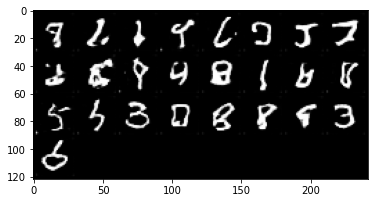

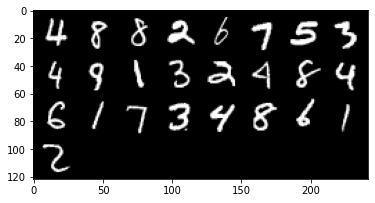

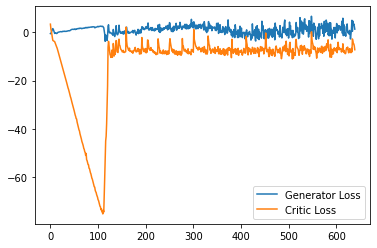

Step 12850: Generator loss: 0.8354558199644089, critic loss: -7.58640577572584


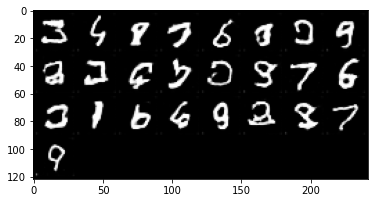

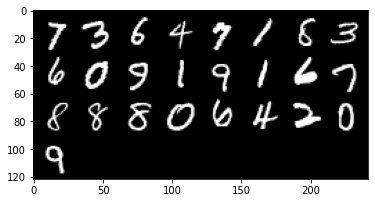

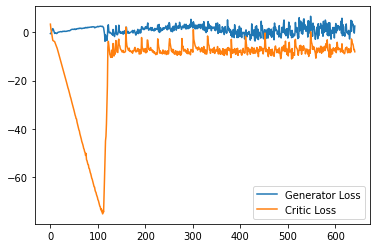

Step 12900: Generator loss: 1.3641214102506638, critic loss: -5.856518149495124


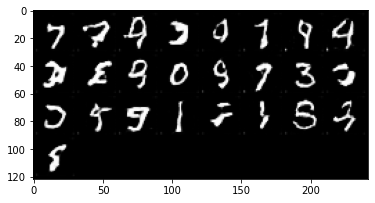

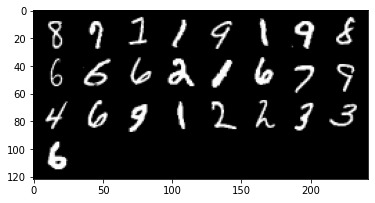

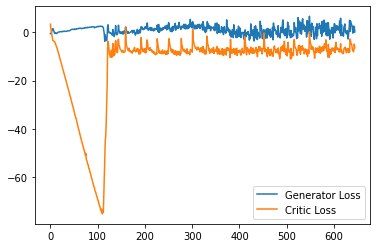

Step 12950: Generator loss: 0.8183307921886445, critic loss: -6.981570432960989


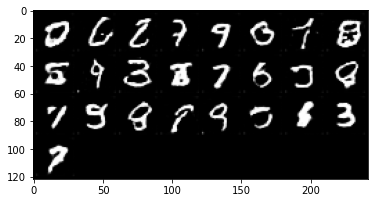

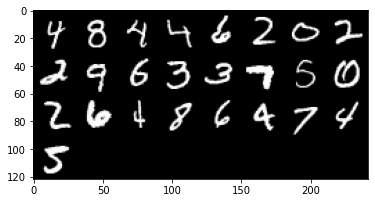

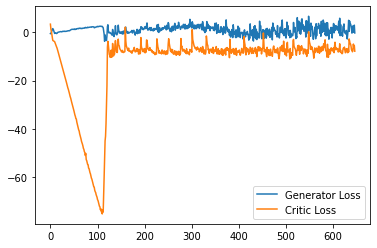

Step 13000: Generator loss: 1.7591203692555428, critic loss: -6.986648387789725


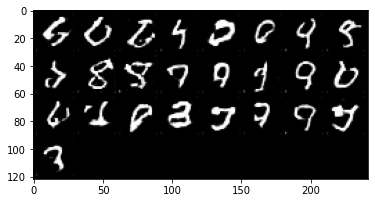

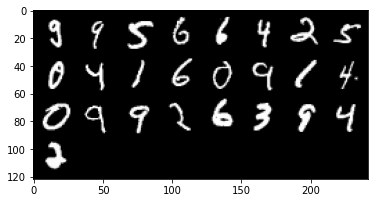

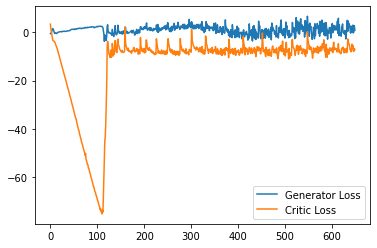

Step 13050: Generator loss: 0.7385878181457519, critic loss: -8.660216954112054


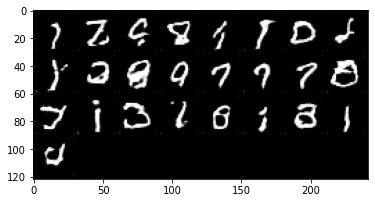

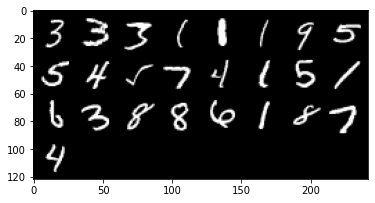

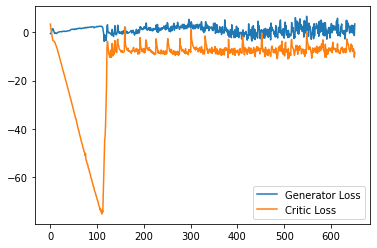

Step 13100: Generator loss: 0.5914206662774086, critic loss: -7.33961408674717


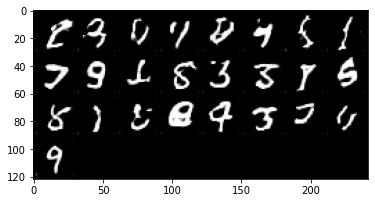

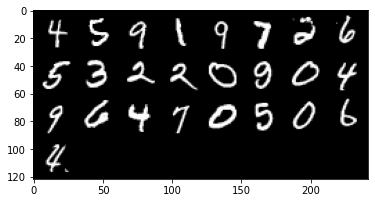

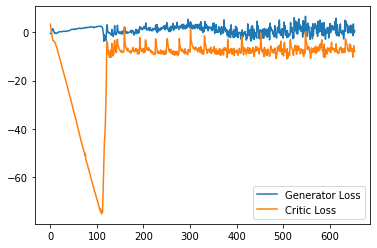

  0%|          | 0/469 [00:00<?, ?it/s]

Step 13150: Generator loss: -1.5248271358013152, critic loss: -8.601550084173676


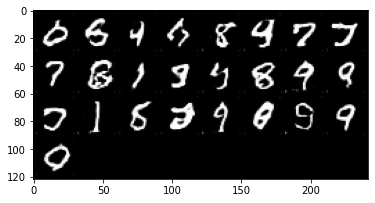

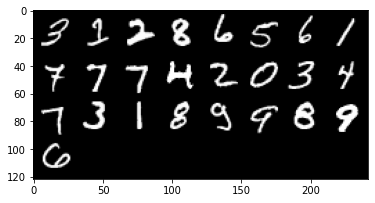

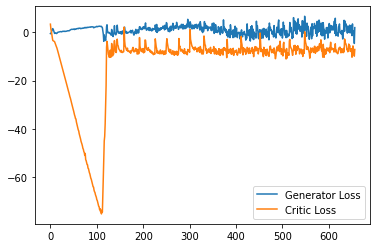

Step 13200: Generator loss: 1.5023795869201422, critic loss: -7.319761583864687


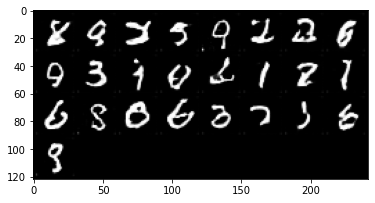

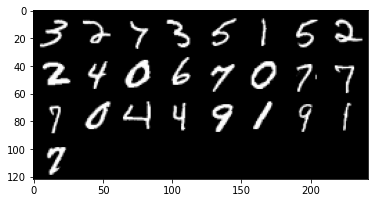

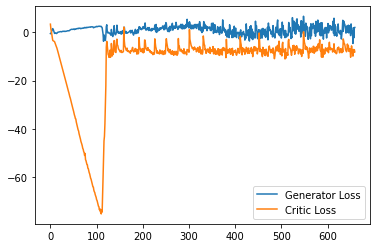

Step 13250: Generator loss: -1.2229669257998466, critic loss: -8.115158243775367


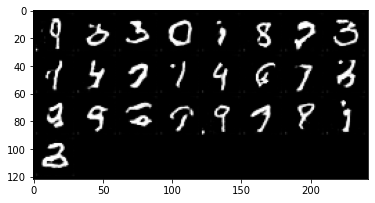

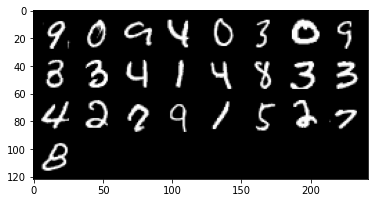

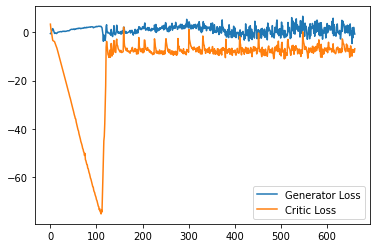

Step 13300: Generator loss: 2.1429565115273, critic loss: -8.214290127009155


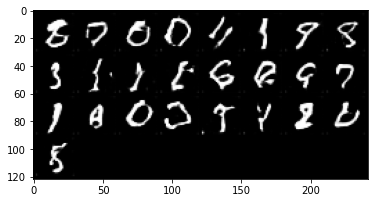

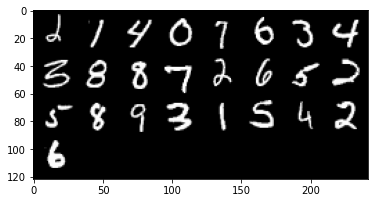

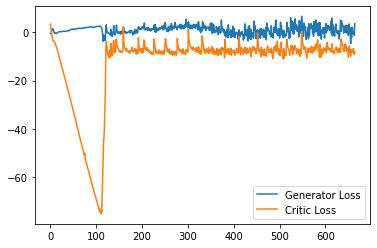

Step 13350: Generator loss: 0.46278687357902526, critic loss: -5.547973913073539


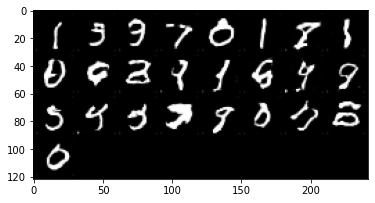

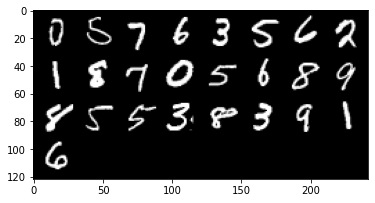

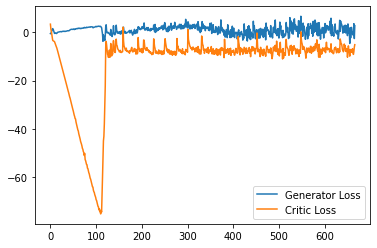

Step 13400: Generator loss: 0.24431187987327577, critic loss: -5.974682097196578


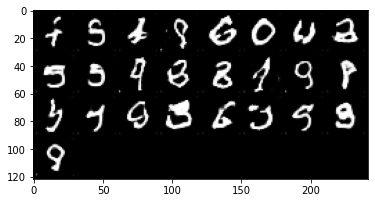

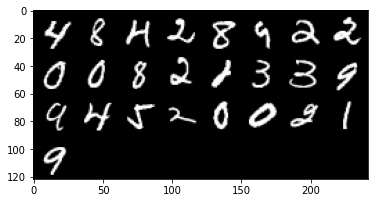

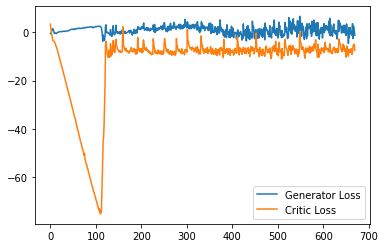

Step 13450: Generator loss: 2.821369875073433, critic loss: -6.107952656745913


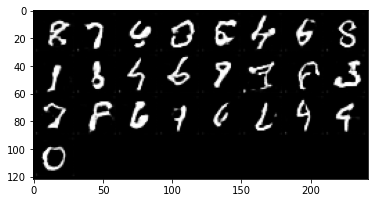

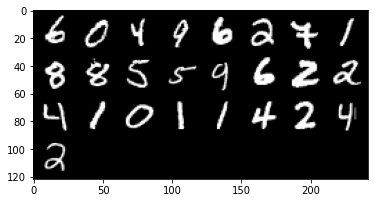

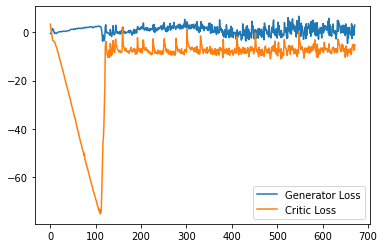

Step 13500: Generator loss: -0.6562634268403054, critic loss: -8.011848401546478


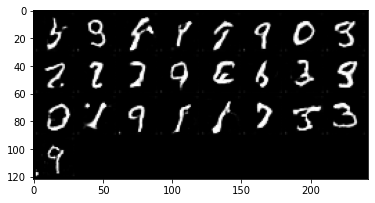

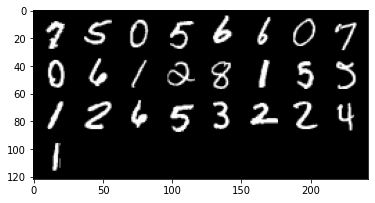

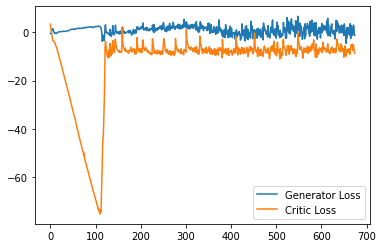

Step 13550: Generator loss: 0.0843327721953392, critic loss: -7.708169027268889


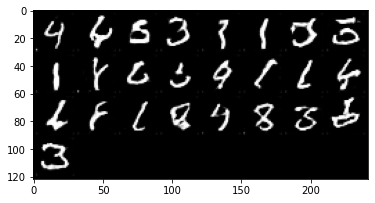

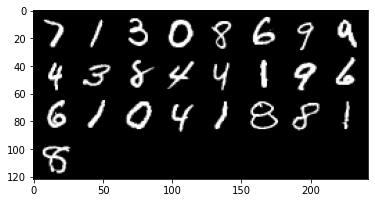

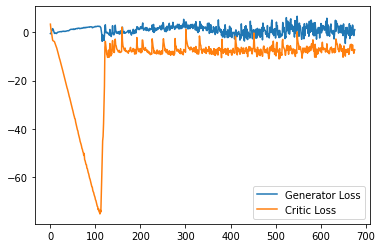

Step 13600: Generator loss: 3.0030227299034595, critic loss: -6.557194972634318


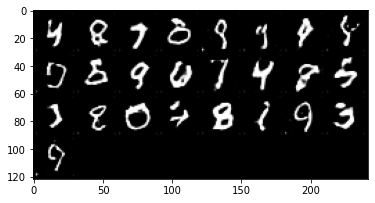

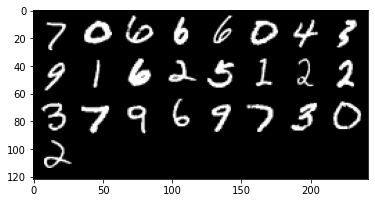

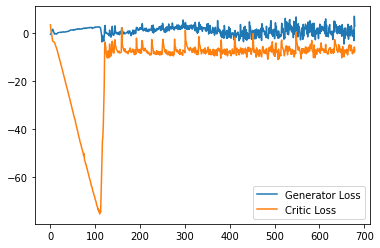

  0%|          | 0/469 [00:00<?, ?it/s]

Step 13650: Generator loss: 0.586904234290123, critic loss: -8.120327460885052


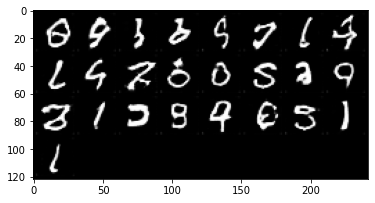

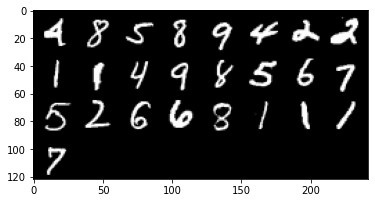

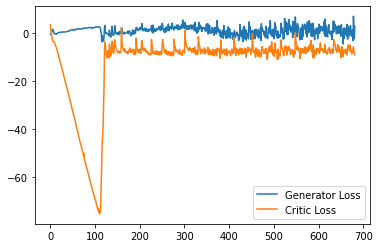

Step 13700: Generator loss: 0.8955716049671173, critic loss: -5.616350253254175


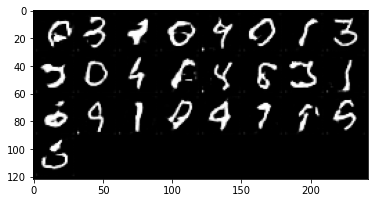

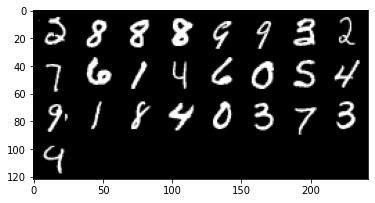

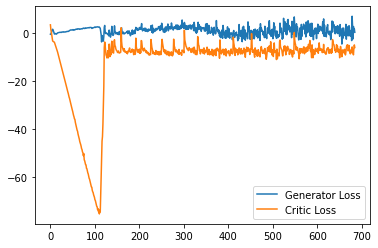

Step 13750: Generator loss: 0.35235258758068083, critic loss: -7.626497553348543


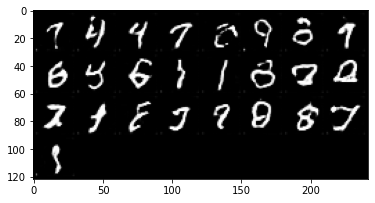

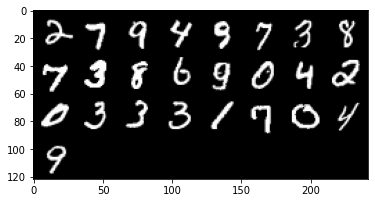

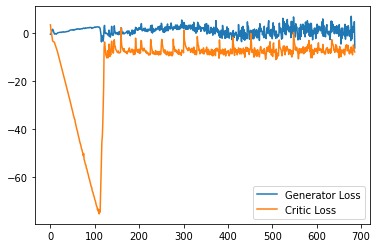

Step 13800: Generator loss: 1.7901378585398198, critic loss: -6.277644476532939


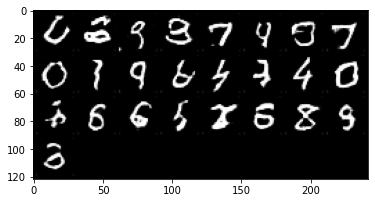

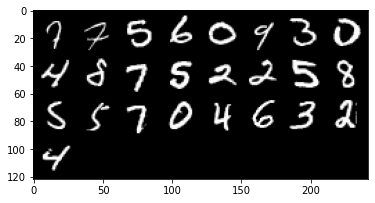

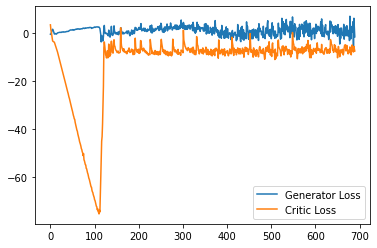

Step 13850: Generator loss: 1.9391884154081345, critic loss: -5.770154938399791


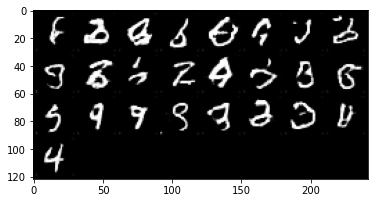

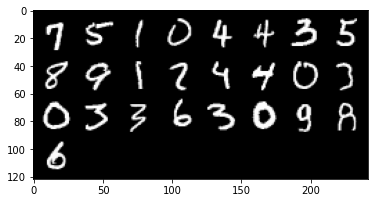

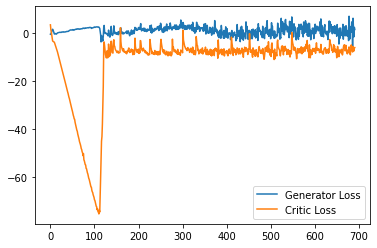

Step 13900: Generator loss: 0.4262500824034214, critic loss: -8.761553629875182


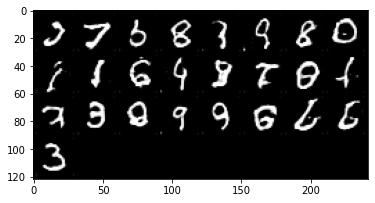

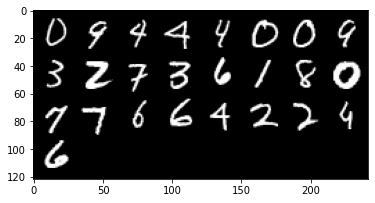

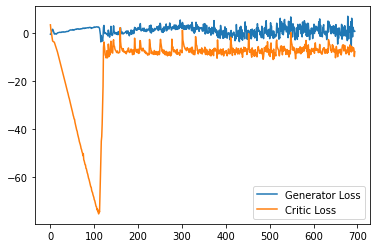

Step 13950: Generator loss: 1.6015676292777061, critic loss: -6.00227174758911


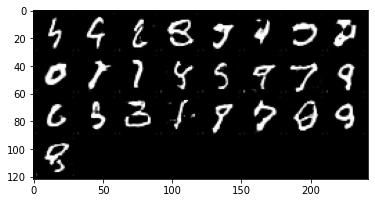

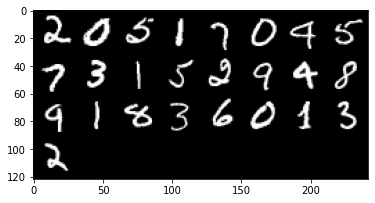

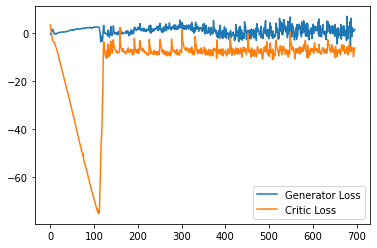

Step 14000: Generator loss: 1.7140071648359299, critic loss: -4.98303857922554


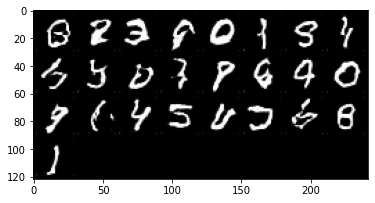

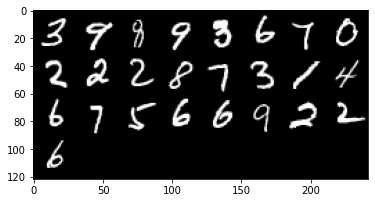

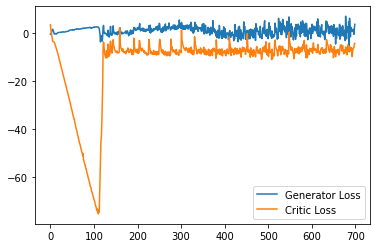

Step 14050: Generator loss: 1.8825006619095803, critic loss: -6.245115626096725


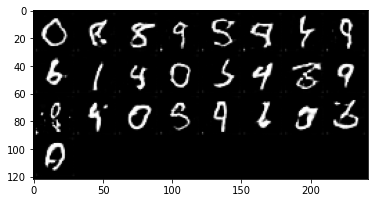

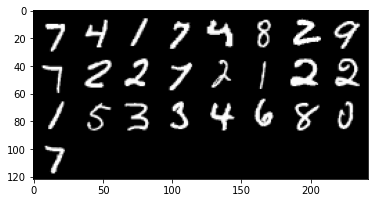

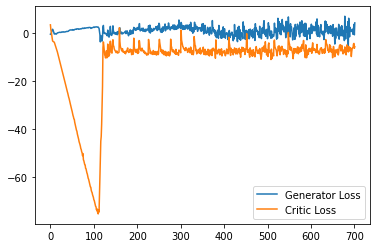

  0%|          | 0/469 [00:00<?, ?it/s]

Step 14100: Generator loss: 3.1834996473789214, critic loss: -7.607243533015251


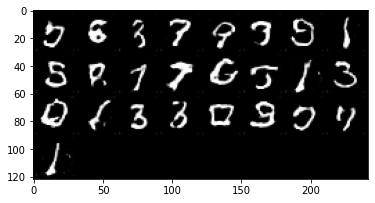

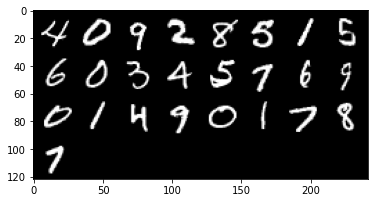

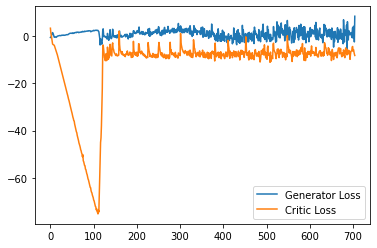

Step 14150: Generator loss: -1.2037469877302647, critic loss: -6.359829905569554


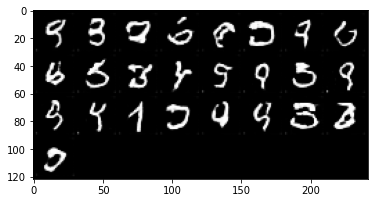

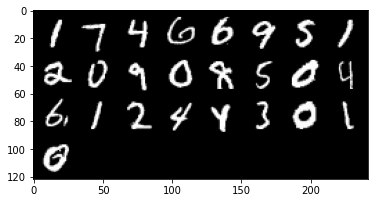

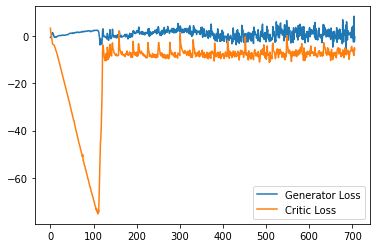

Step 14200: Generator loss: 2.959172628223896, critic loss: -6.167962175369263


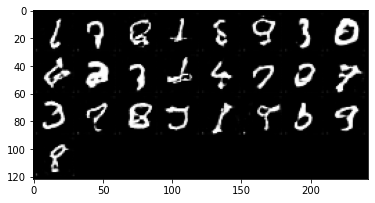

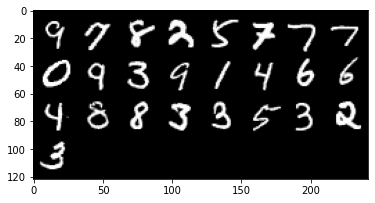

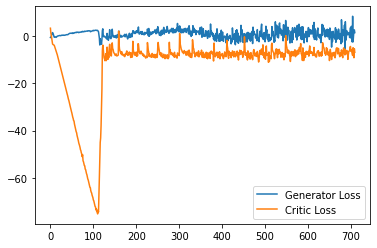

Step 14250: Generator loss: 1.1947081744670869, critic loss: -7.556811422586443


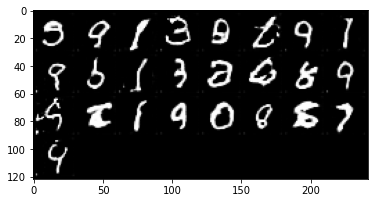

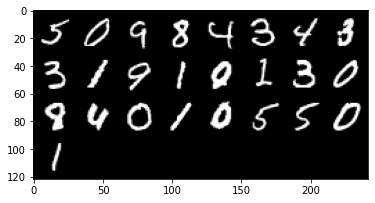

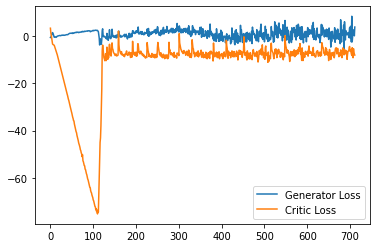

Step 14300: Generator loss: 1.826439624428749, critic loss: -7.656973553419111


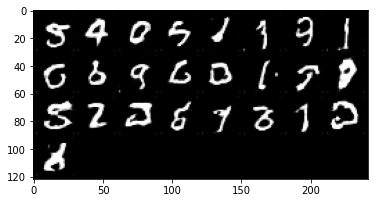

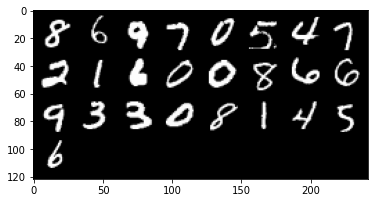

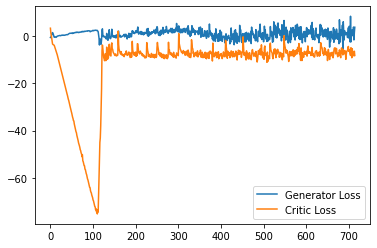

Step 14350: Generator loss: 2.6839296144247053, critic loss: -5.670818721950054


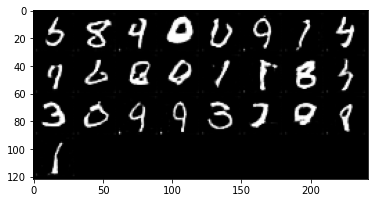

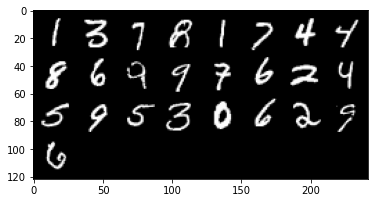

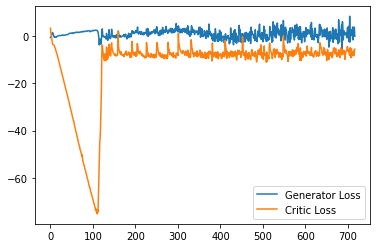

Step 14400: Generator loss: 2.118039131462574, critic loss: -6.163844245791437


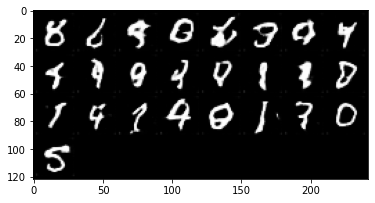

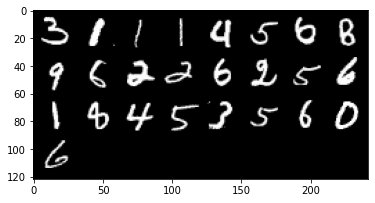

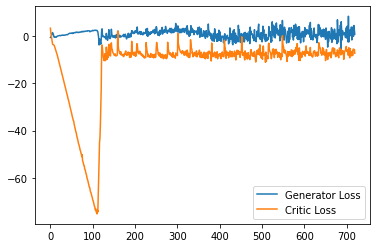

Step 14450: Generator loss: 4.412734162211418, critic loss: -6.115238817930219


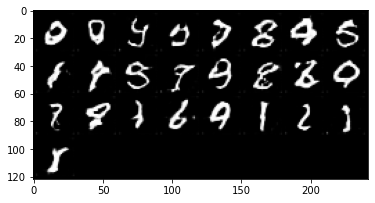

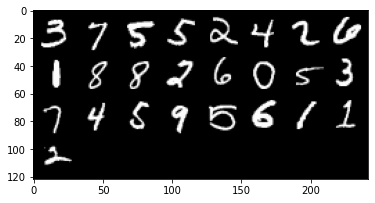

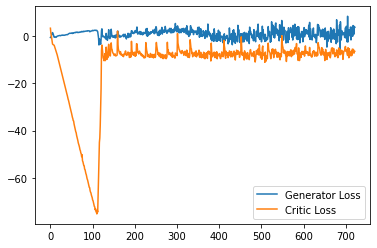

Step 14500: Generator loss: 2.666309204697609, critic loss: -6.6390312849879285


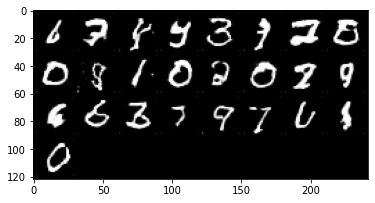

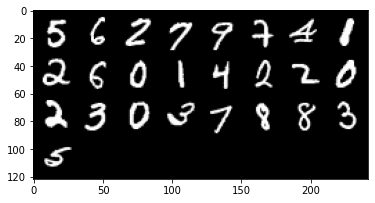

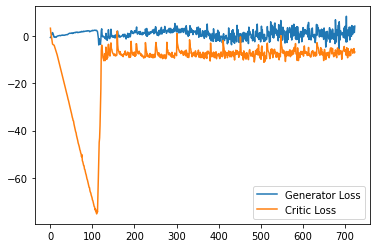

  0%|          | 0/469 [00:00<?, ?it/s]

Step 14550: Generator loss: 2.926381657421589, critic loss: -6.48084416013956


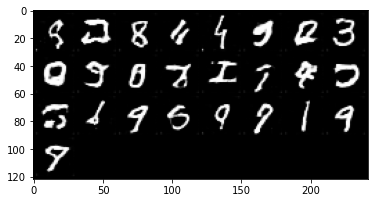

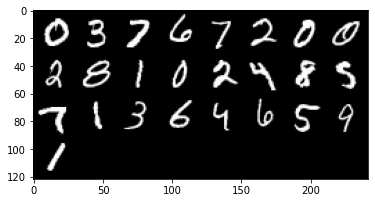

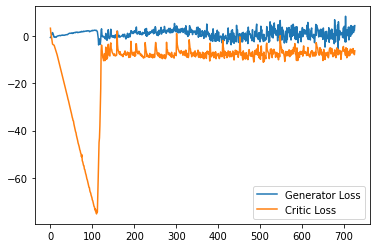

Step 14600: Generator loss: 1.280699791163206, critic loss: -7.174555451273919


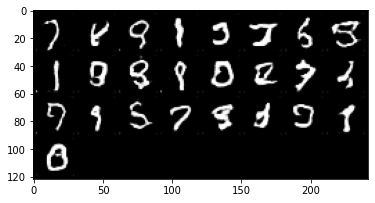

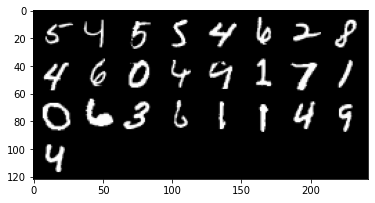

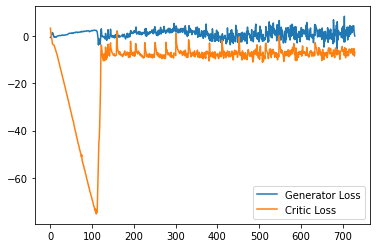

Step 14650: Generator loss: 1.711207830607891, critic loss: -7.159871099948885


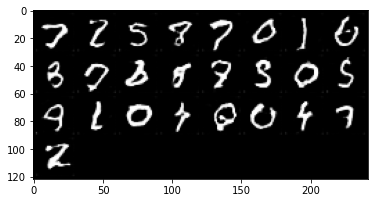

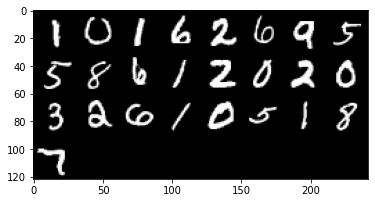

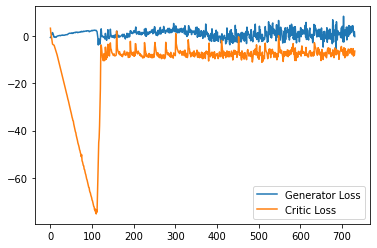

Step 14700: Generator loss: 2.3318723878264427, critic loss: -6.480224049568175


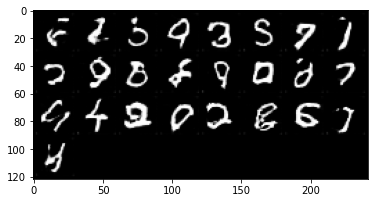

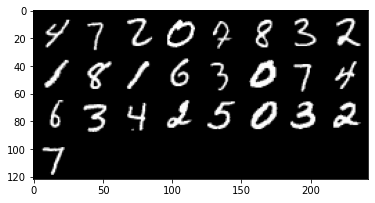

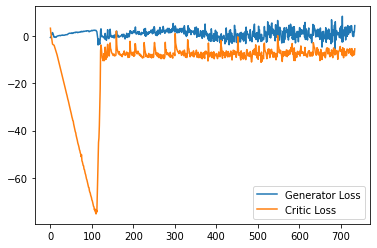

Step 14750: Generator loss: 0.24021224677562714, critic loss: -7.05920033454895


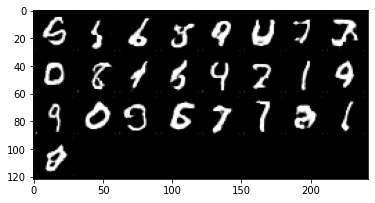

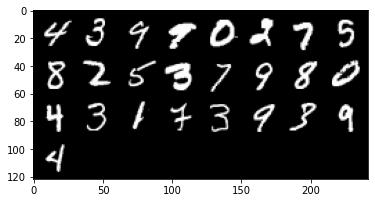

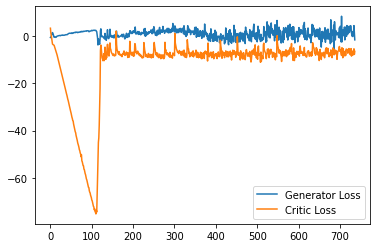

Step 14800: Generator loss: 0.34138917565345767, critic loss: -7.7802532279491405


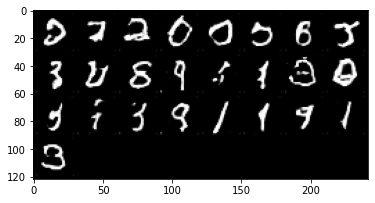

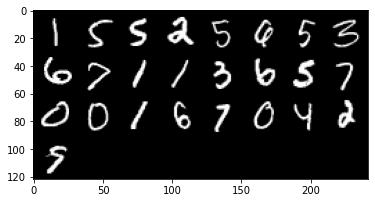

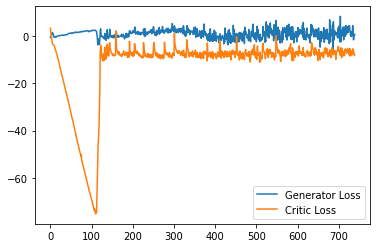

Step 14850: Generator loss: -0.12328779026865959, critic loss: -8.664405744552614


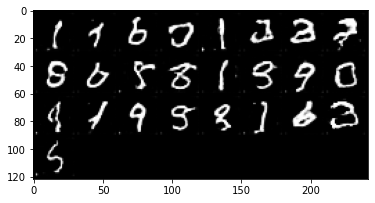

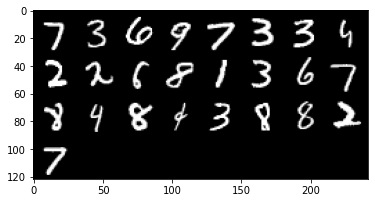

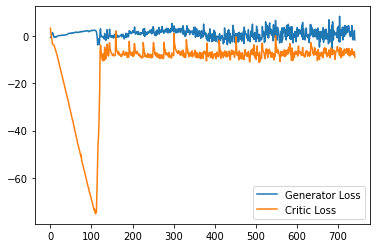

Step 14900: Generator loss: 1.9190010856091977, critic loss: -6.457541934609415


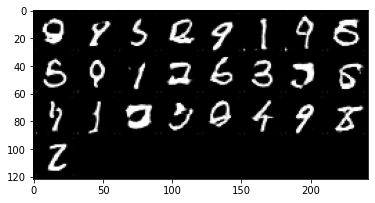

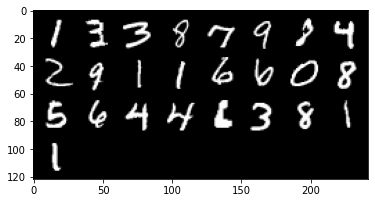

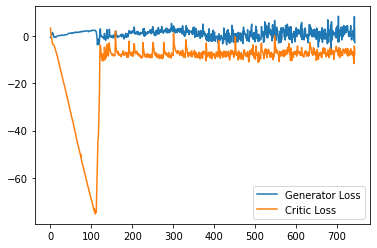

Step 14950: Generator loss: 2.954482306241989, critic loss: -1.3318851673603058


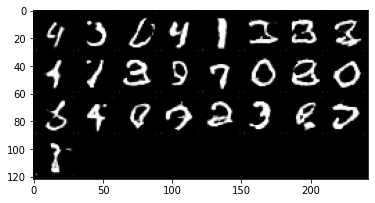

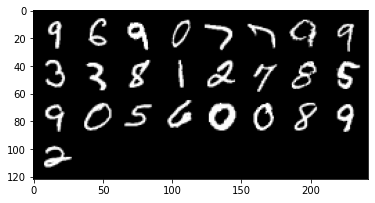

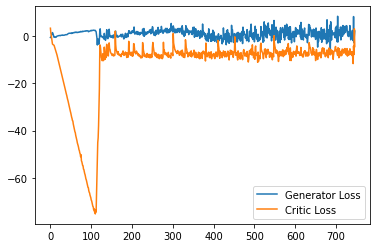

Step 15000: Generator loss: 2.5164477533102034, critic loss: -5.4365751941204055


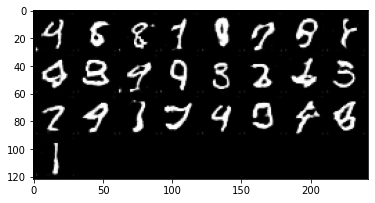

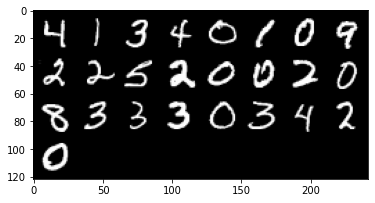

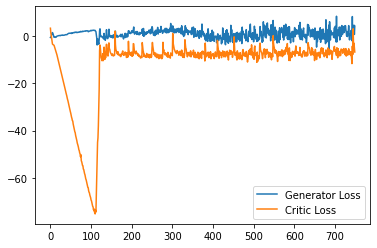

  0%|          | 0/469 [00:00<?, ?it/s]

Step 15050: Generator loss: 2.215466365814209, critic loss: -5.981486100167034


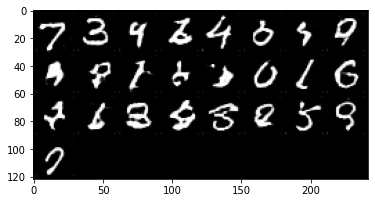

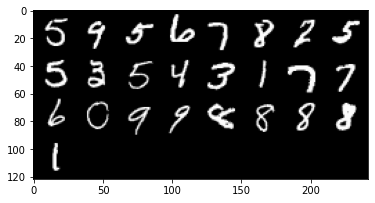

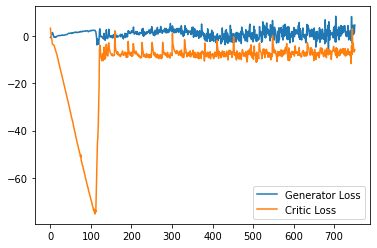

Step 15100: Generator loss: 2.387532193660736, critic loss: -5.185742318809032


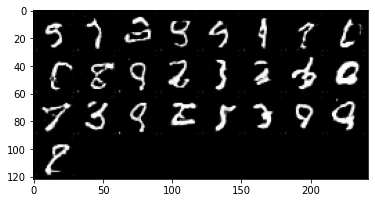

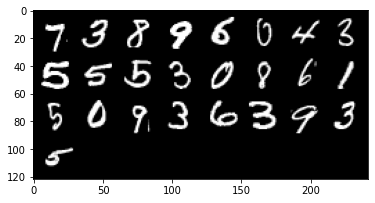

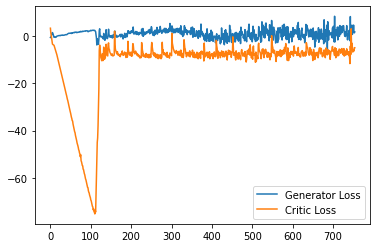

Step 15150: Generator loss: 1.546879025697708, critic loss: -6.151171635866166


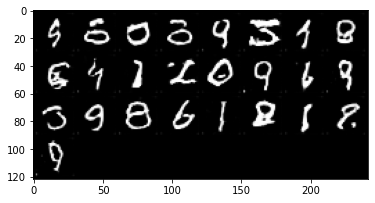

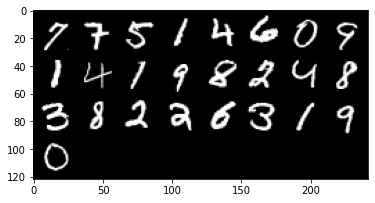

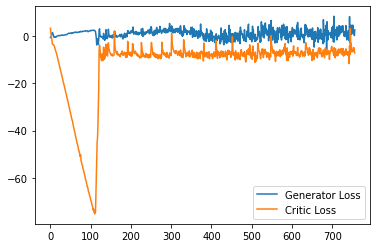

Step 15200: Generator loss: 1.6437029600143434, critic loss: -6.280884586453437


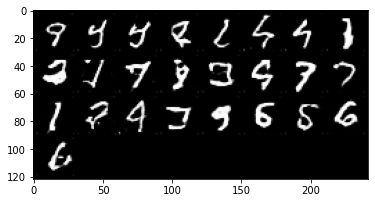

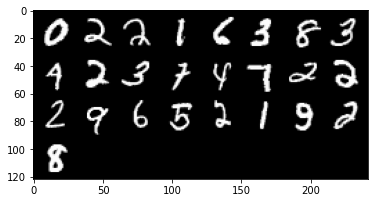

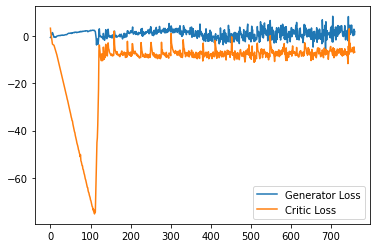

Step 15250: Generator loss: 1.5760336418822407, critic loss: -7.924190178990363


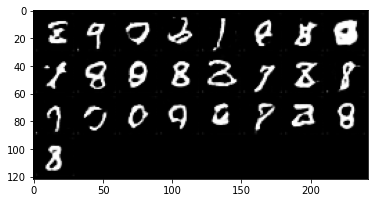

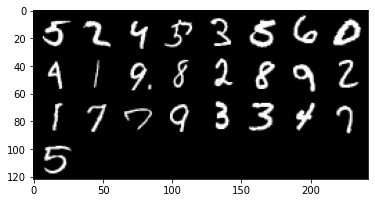

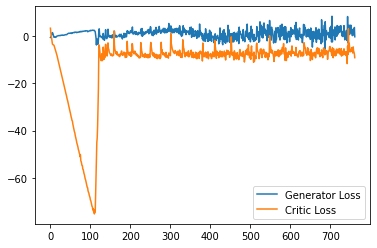

Step 15300: Generator loss: 3.8503668695688247, critic loss: -6.668169623374939


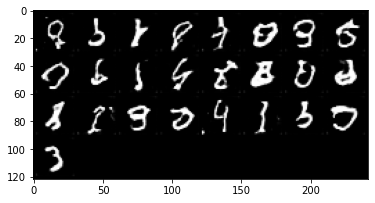

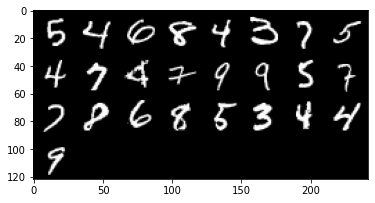

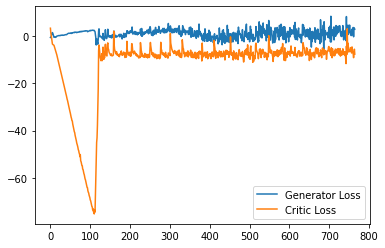

Step 15350: Generator loss: 2.7525361190736293, critic loss: -6.191084012985227


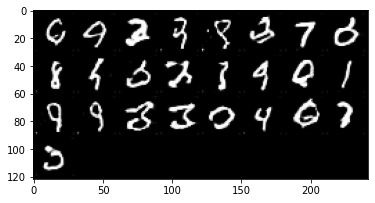

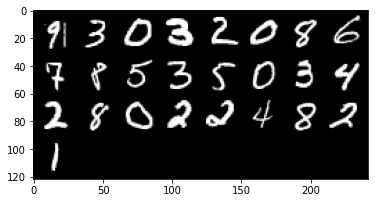

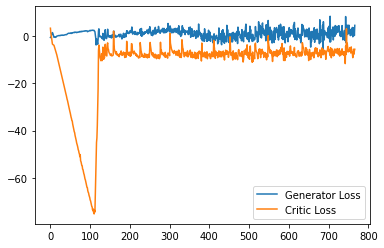

Step 15400: Generator loss: 1.0450662890076636, critic loss: -7.85759374564886


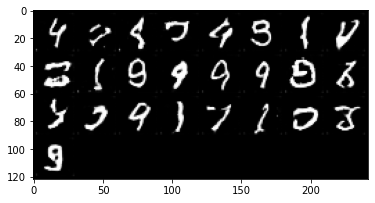

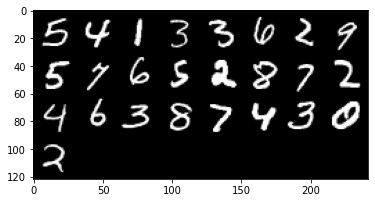

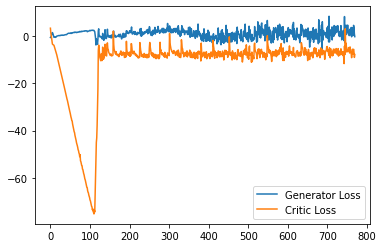

Step 15450: Generator loss: 1.0378579948842526, critic loss: -6.792600991904737


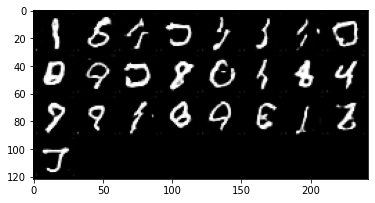

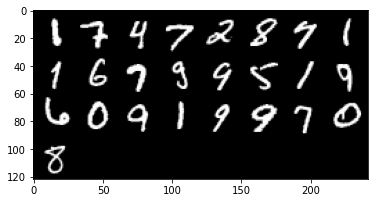

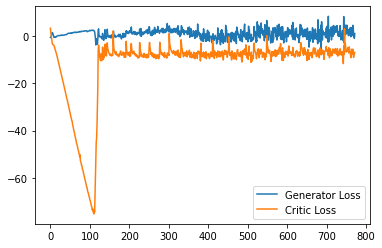

  0%|          | 0/469 [00:00<?, ?it/s]

Step 15500: Generator loss: 2.746334486603737, critic loss: -7.1193056780695905


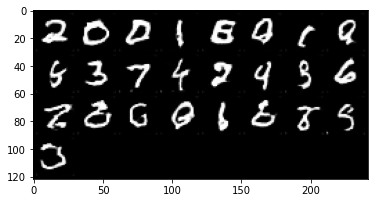

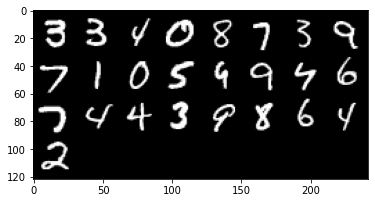

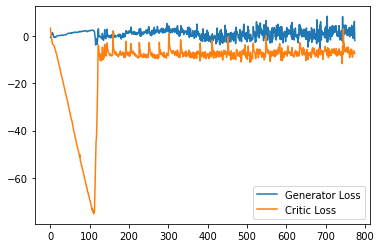

Step 15550: Generator loss: 4.0125041848421095, critic loss: -6.558855546832087


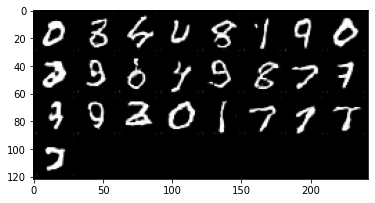

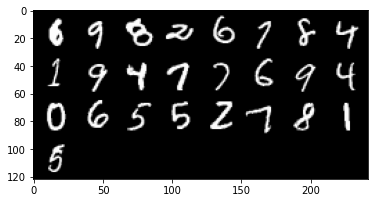

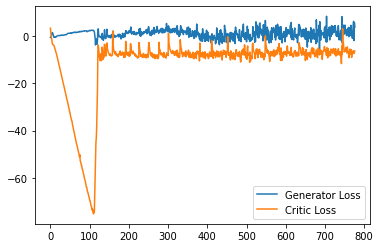

Step 15600: Generator loss: 4.2772978436946865, critic loss: -5.467429775416852


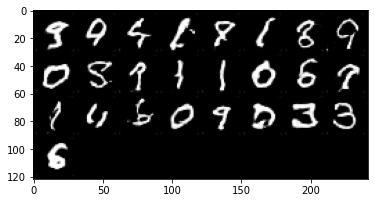

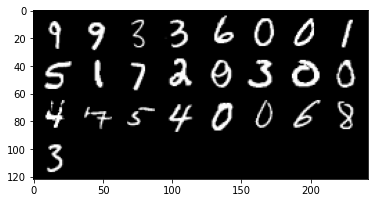

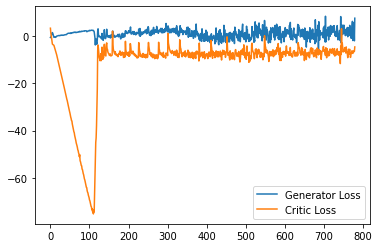

Step 15650: Generator loss: 4.797104128599167, critic loss: -6.194828782498834


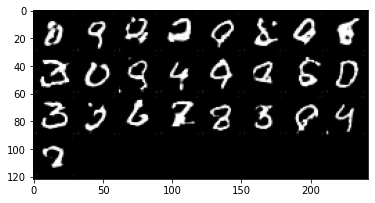

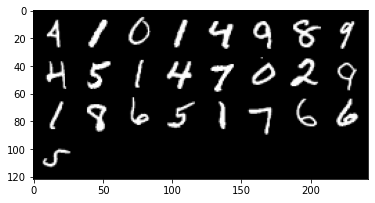

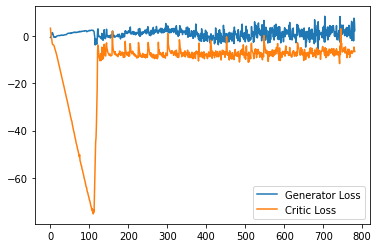

Step 15700: Generator loss: 5.8605713368952275, critic loss: -7.402012585997583


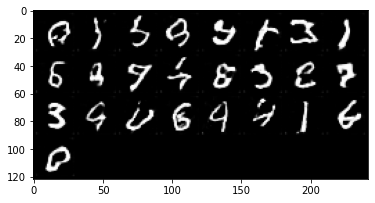

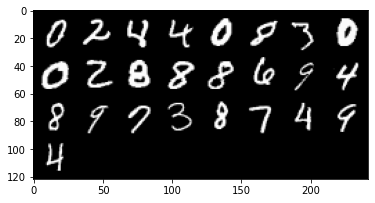

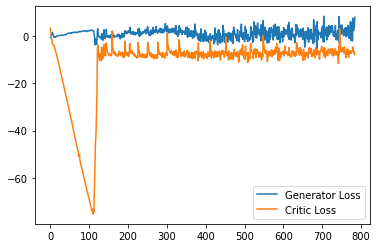

Step 15750: Generator loss: 4.60589419722557, critic loss: -5.738230451345445


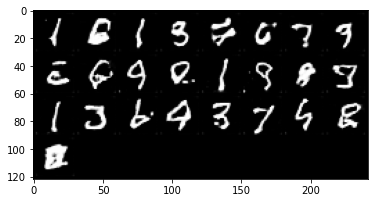

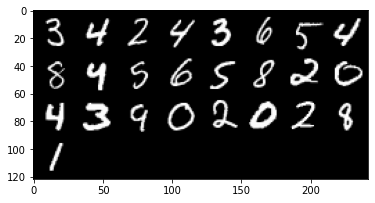

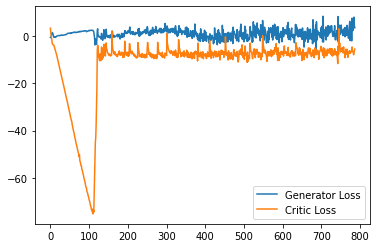

Step 15800: Generator loss: 3.8471352291107177, critic loss: -7.271580087661743


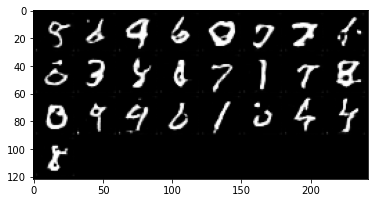

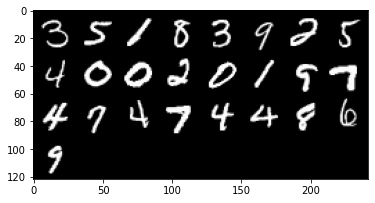

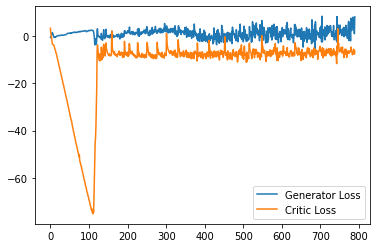

Step 15850: Generator loss: 2.439935203194618, critic loss: -5.273431990861892


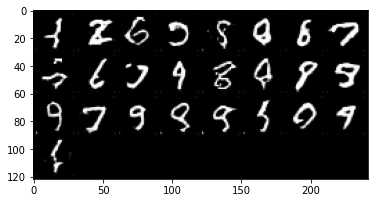

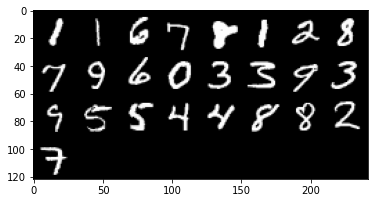

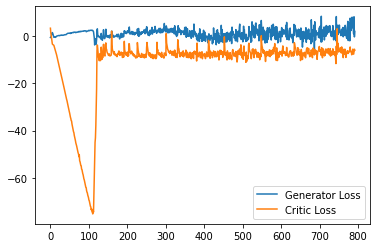

Step 15900: Generator loss: 5.218166640996933, critic loss: -6.9621420210599885


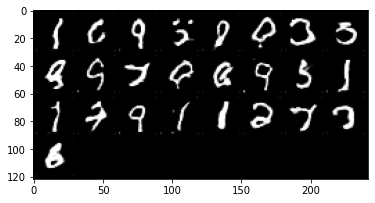

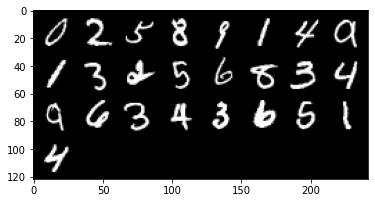

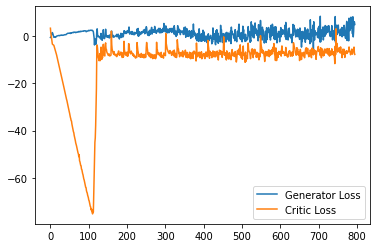

  0%|          | 0/469 [00:00<?, ?it/s]

Step 15950: Generator loss: 5.676693395674229, critic loss: -5.43256419992447


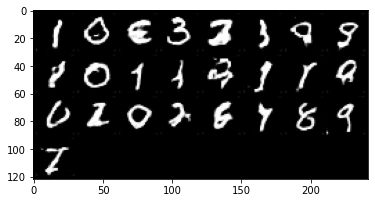

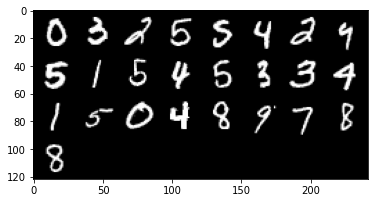

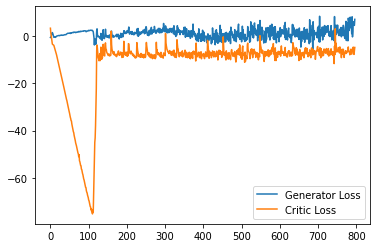

Step 16000: Generator loss: 4.901722902208567, critic loss: -5.8720845798254


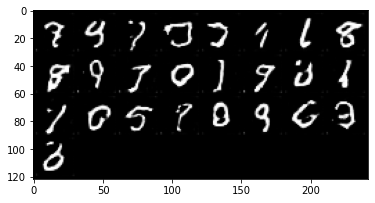

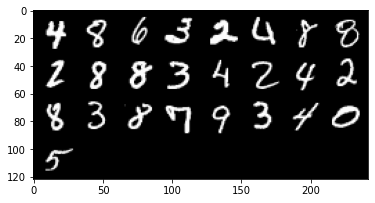

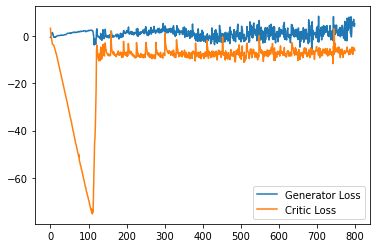

Step 16050: Generator loss: 7.348710480332374, critic loss: -5.970829996228217


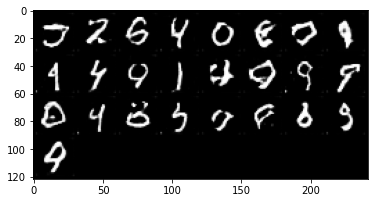

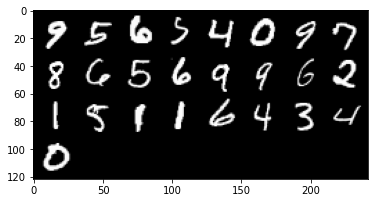

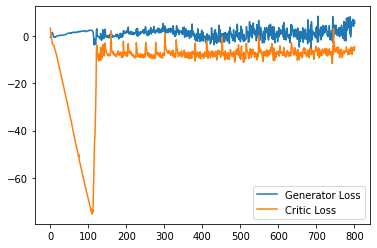

Step 16100: Generator loss: 3.6377140033245086, critic loss: -5.081507112383843


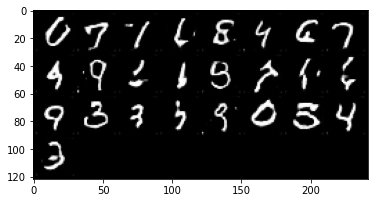

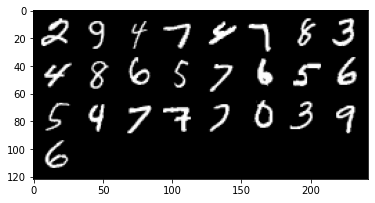

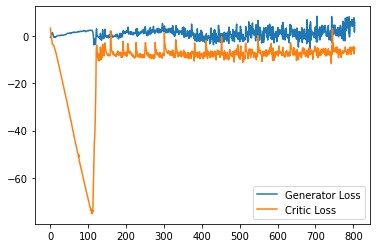

Step 16150: Generator loss: 6.841178027391433, critic loss: -4.9464931045770655


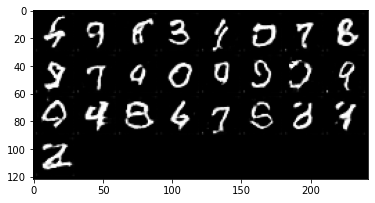

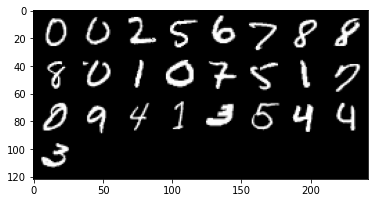

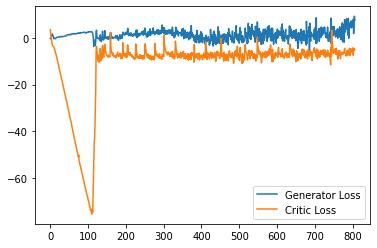

Step 16200: Generator loss: 2.428587022423744, critic loss: -5.464919986248018


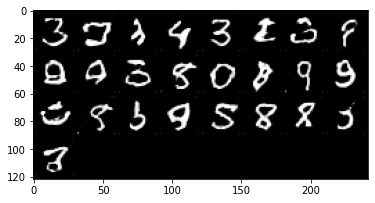

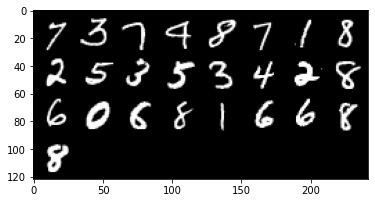

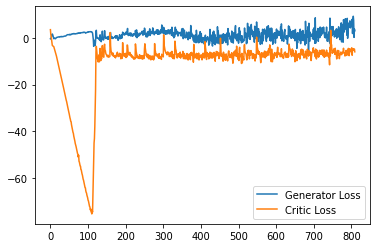

Step 16250: Generator loss: 5.492442181706428, critic loss: -5.732070508897303


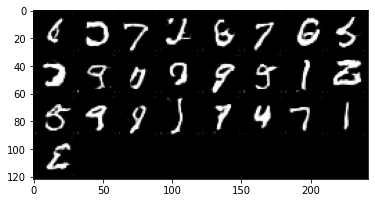

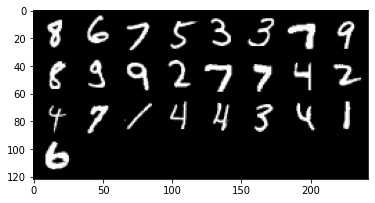

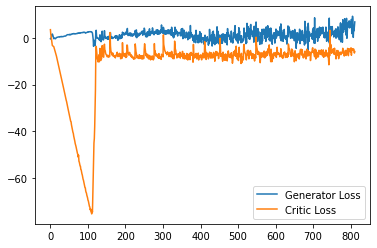

Step 16300: Generator loss: 5.772002590298652, critic loss: -5.147537156581879


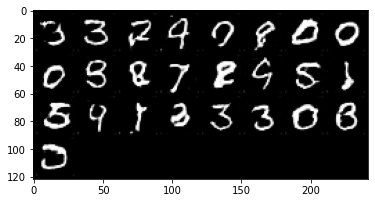

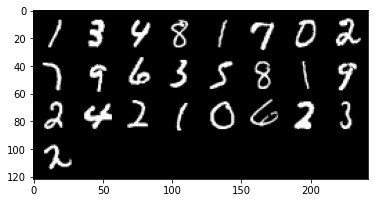

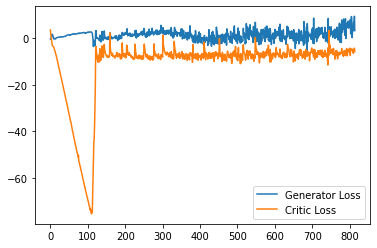

Step 16350: Generator loss: 4.448865929245949, critic loss: -7.093635893344879


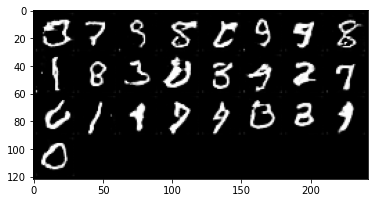

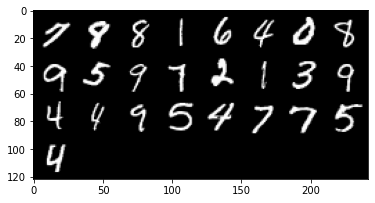

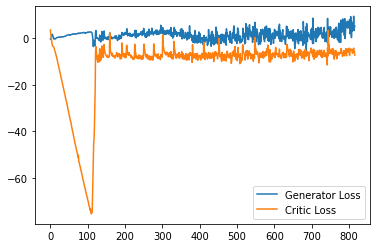

Step 16400: Generator loss: 4.3751455950737, critic loss: -6.513680117249488


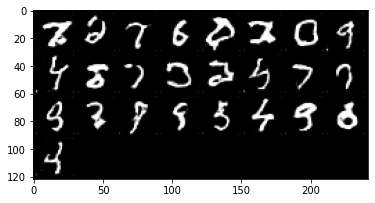

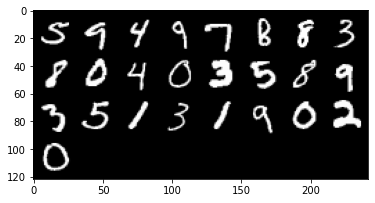

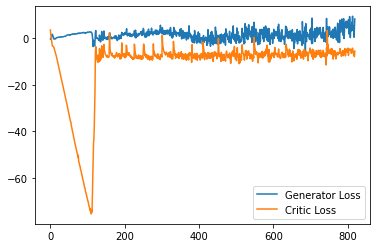

  0%|          | 0/469 [00:00<?, ?it/s]

Step 16450: Generator loss: 4.897762367725372, critic loss: -5.155597306311129


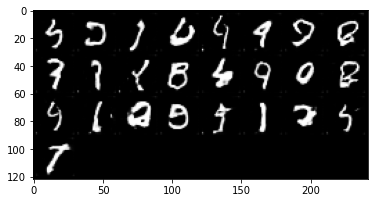

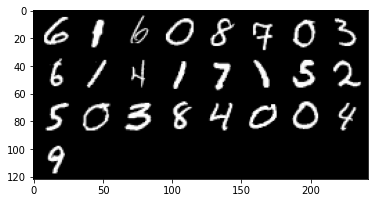

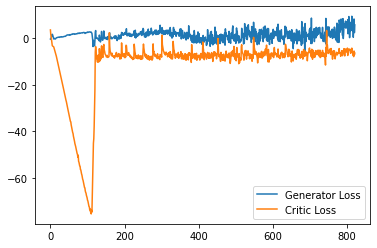

Step 16500: Generator loss: 6.9361896803975105, critic loss: -5.463369906544687


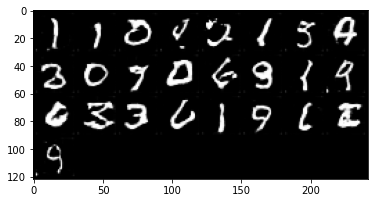

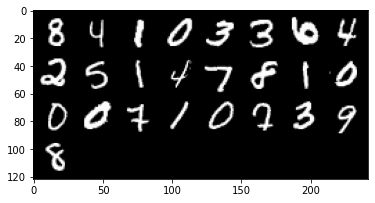

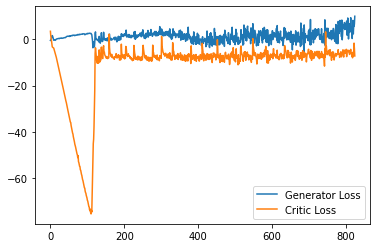

Step 16550: Generator loss: 5.385315368771553, critic loss: -4.068175903260708


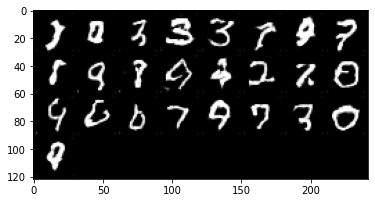

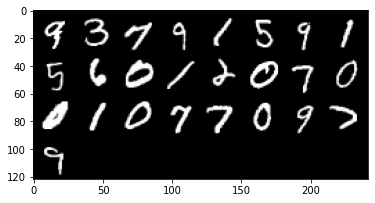

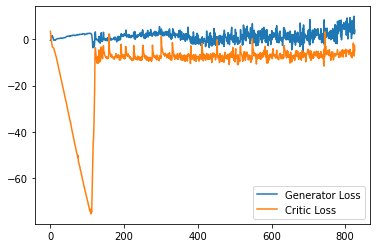

Step 16600: Generator loss: 4.001271200180054, critic loss: -5.017126355916263


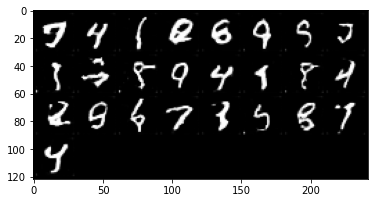

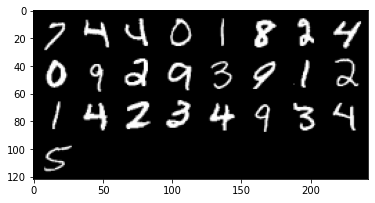

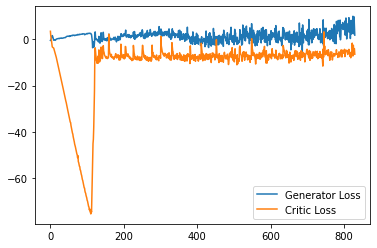

Step 16650: Generator loss: 3.7395353493094445, critic loss: -7.383278131365774


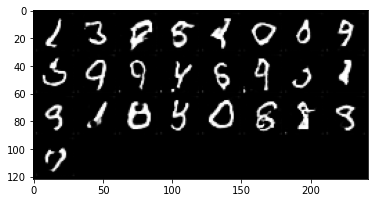

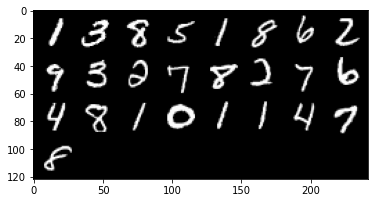

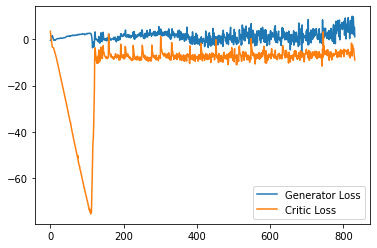

Step 16700: Generator loss: 3.513069145679474, critic loss: -5.912884112238885


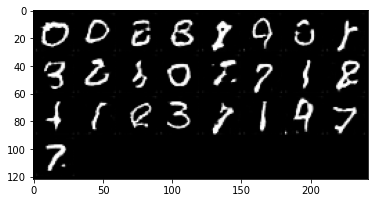

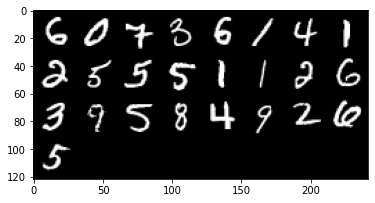

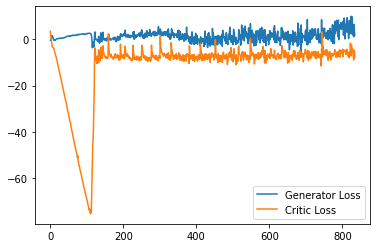

Step 16750: Generator loss: 5.058314282894134, critic loss: -7.487212331056594


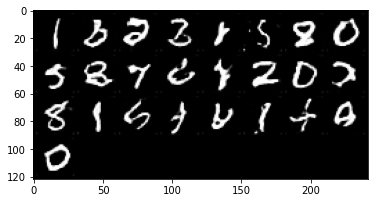

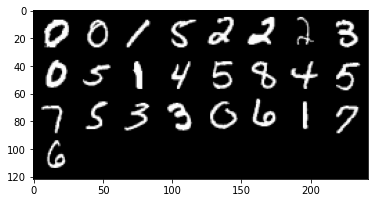

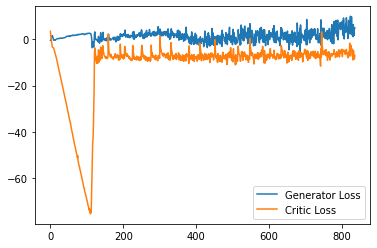

Step 16800: Generator loss: 3.175653251111507, critic loss: -7.661003506839276


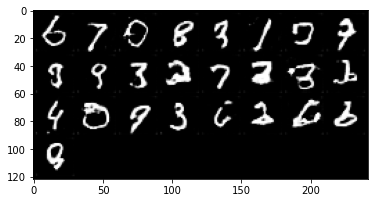

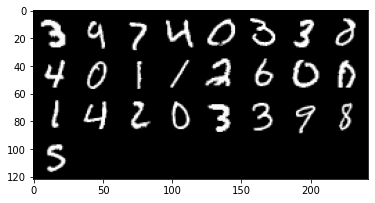

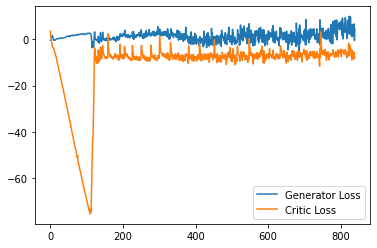

Step 16850: Generator loss: 3.229009187221527, critic loss: -7.659415630698205


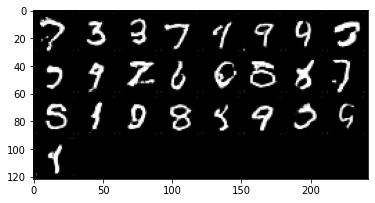

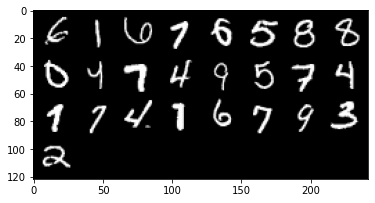

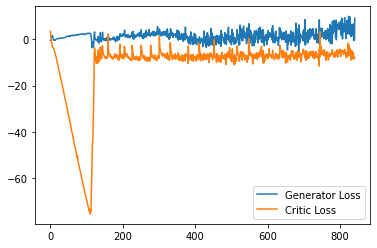

  0%|          | 0/469 [00:00<?, ?it/s]

Step 16900: Generator loss: 4.386352964639664, critic loss: -6.561310373783112


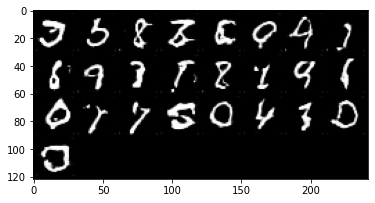

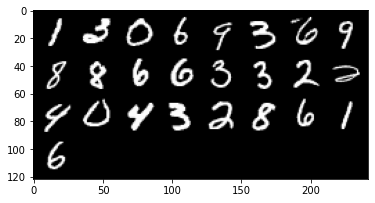

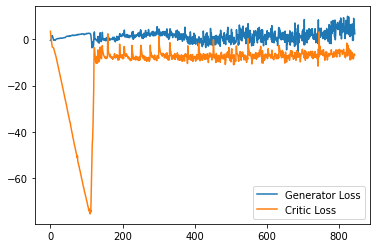

Step 16950: Generator loss: 1.7978133884072305, critic loss: -6.305489594340321


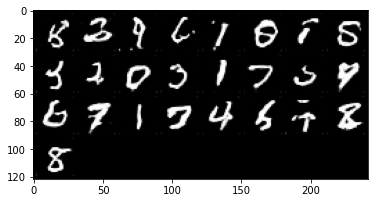

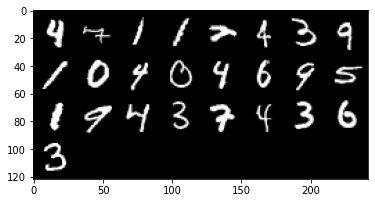

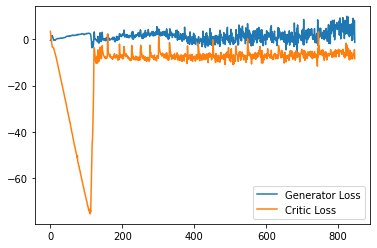

Step 17000: Generator loss: 3.3923182290792466, critic loss: -9.365747158527371


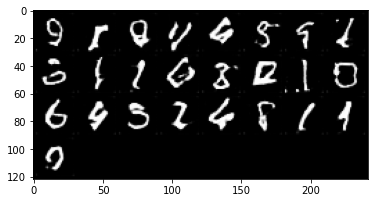

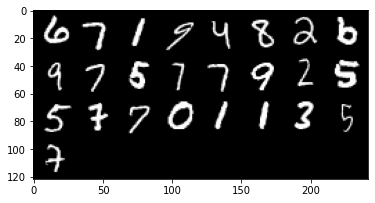

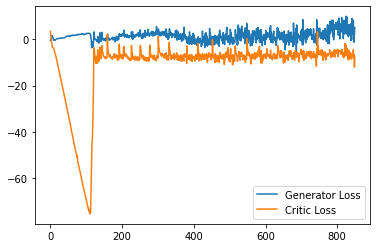

Step 17050: Generator loss: 1.1624175572395326, critic loss: -8.510002092003823


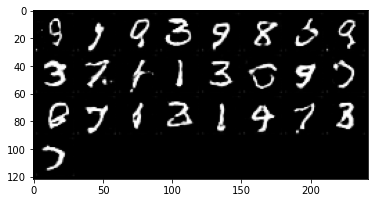

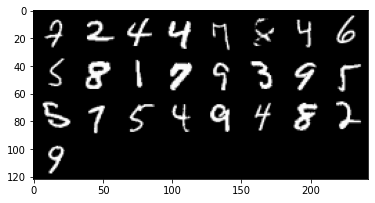

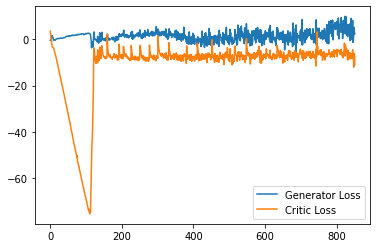

Step 17100: Generator loss: 6.206160025298596, critic loss: -6.248218535542487


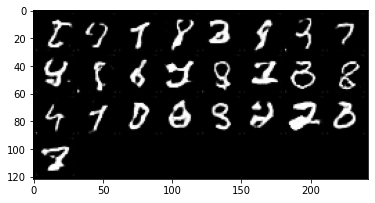

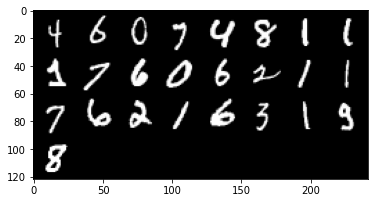

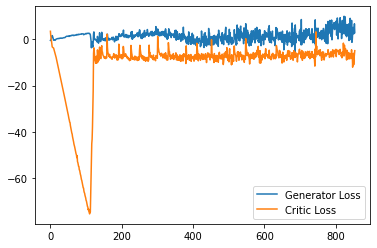

Step 17150: Generator loss: 2.518558570891619, critic loss: -6.655390145838262


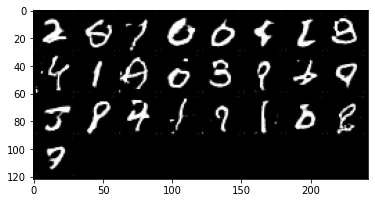

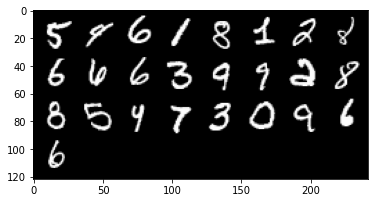

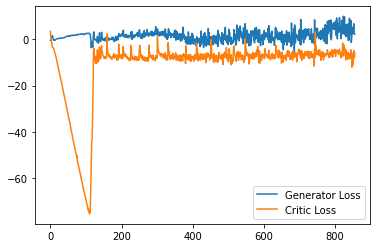

Step 17200: Generator loss: 4.317381495386362, critic loss: -6.853620688617229


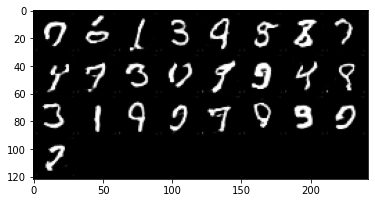

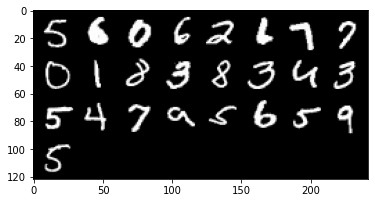

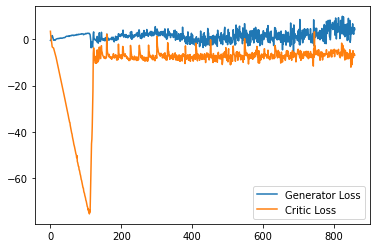

Step 17250: Generator loss: 1.9141488194465637, critic loss: -7.888311767816543


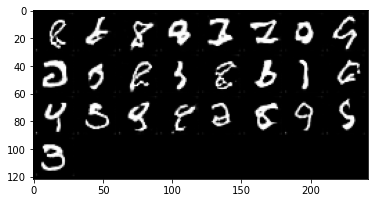

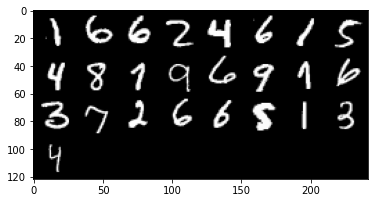

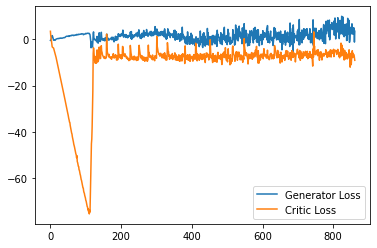

Step 17300: Generator loss: 2.3703213834762575, critic loss: -5.189901762723924


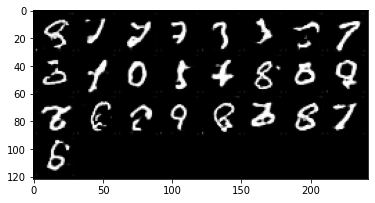

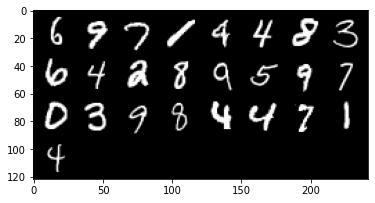

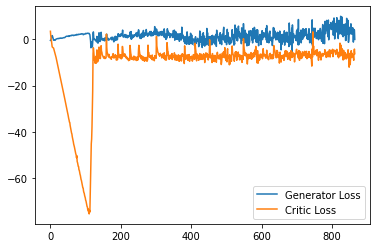

Step 17350: Generator loss: 4.138908356726169, critic loss: -5.940961715817451


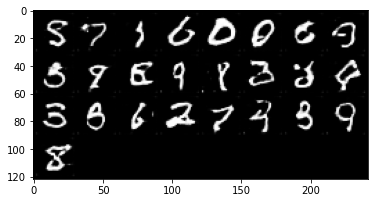

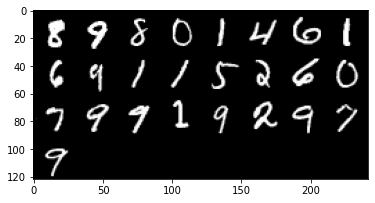

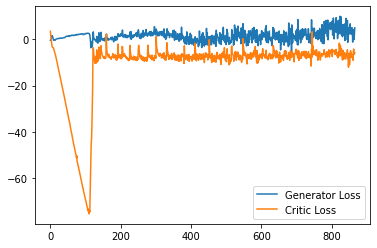

  0%|          | 0/469 [00:00<?, ?it/s]

Step 17400: Generator loss: 2.006186635196209, critic loss: -5.524764404654504


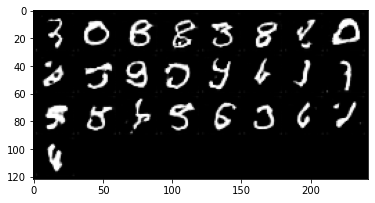

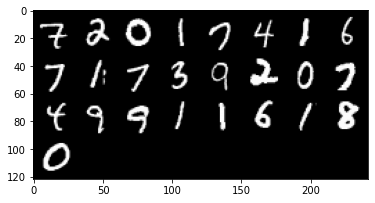

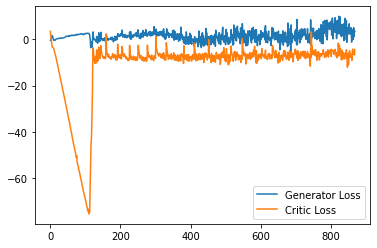

Step 17450: Generator loss: 4.836516232490539, critic loss: -6.783235499203207


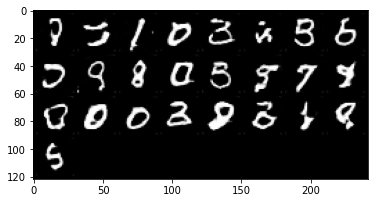

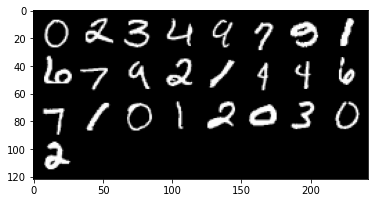

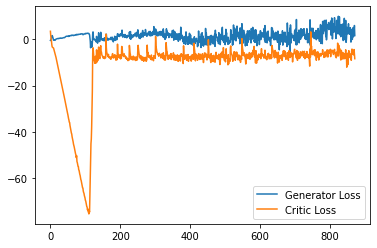

Step 17500: Generator loss: 3.478837924003601, critic loss: -5.4483118245601645


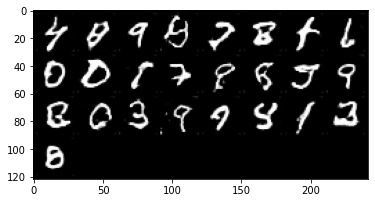

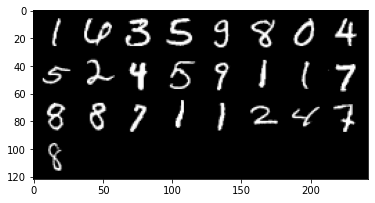

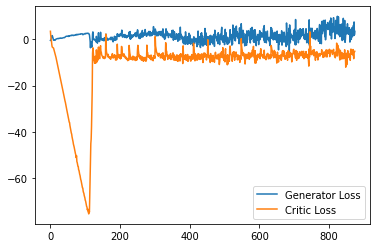

Step 17550: Generator loss: 5.4827554692327976, critic loss: -6.684940486133098


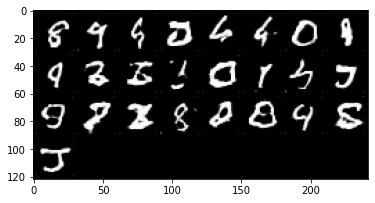

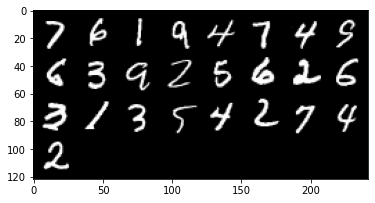

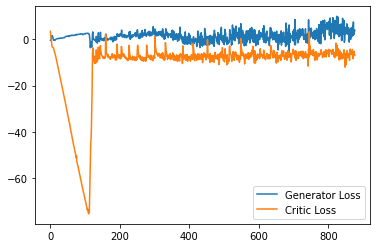

Step 17600: Generator loss: -0.4300055605173111, critic loss: -7.919386028409004


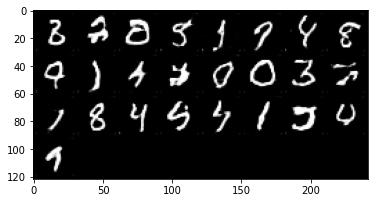

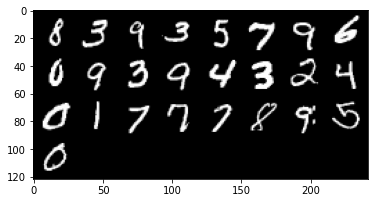

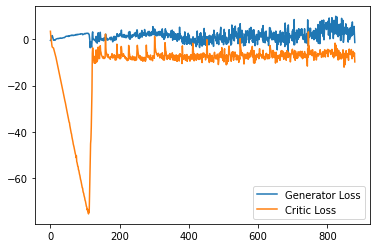

Step 17650: Generator loss: 5.774021399021149, critic loss: -8.526085678458214


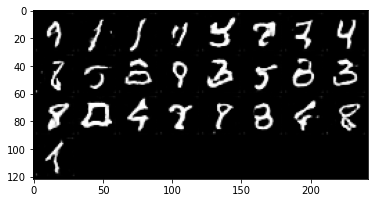

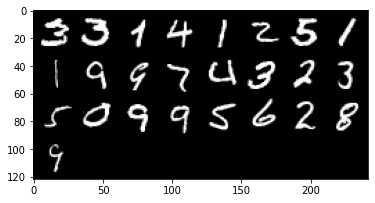

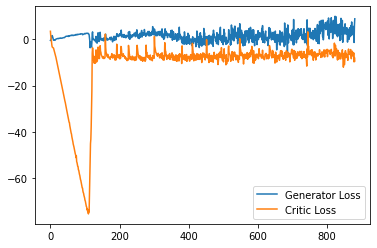

Step 17700: Generator loss: -0.7379715204238891, critic loss: -6.603810639083386


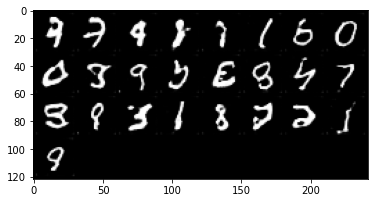

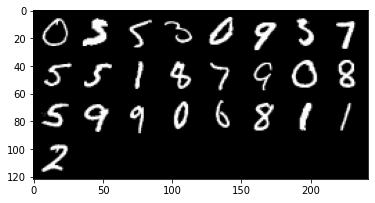

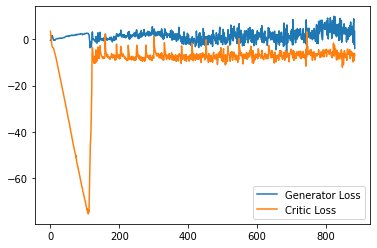

Step 17750: Generator loss: 5.909069159626961, critic loss: -6.290227751612664


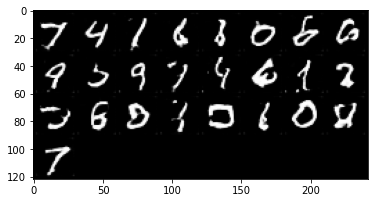

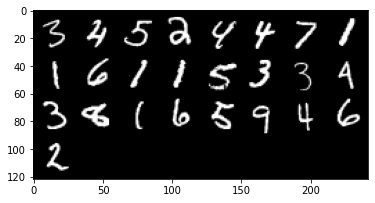

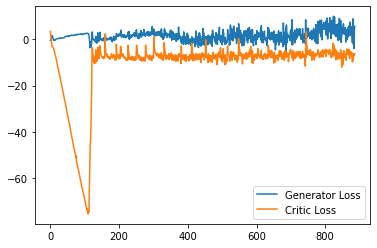

Step 17800: Generator loss: 1.7300874765962362, critic loss: -7.314572682201864


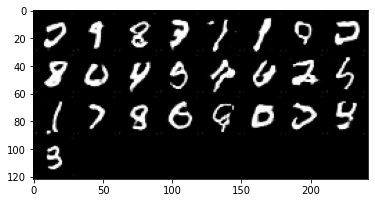

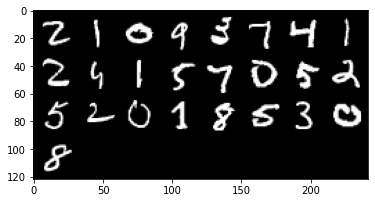

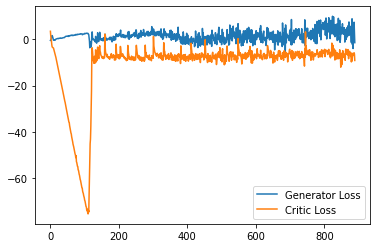

  0%|          | 0/469 [00:00<?, ?it/s]

Step 17850: Generator loss: 0.9026694639027119, critic loss: -8.111952617168424


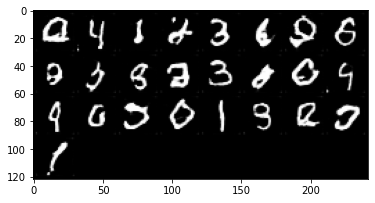

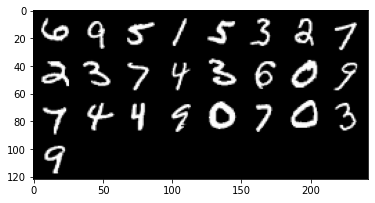

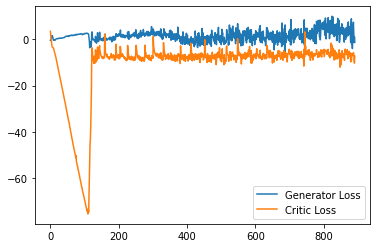

Step 17900: Generator loss: 4.661448772698641, critic loss: -6.1769643740057925


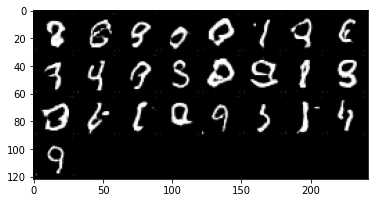

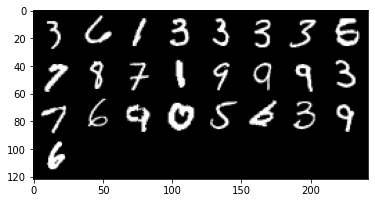

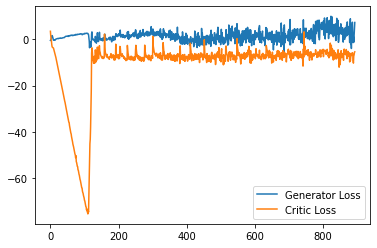

Step 17950: Generator loss: 4.103649346828461, critic loss: -5.511150909781455


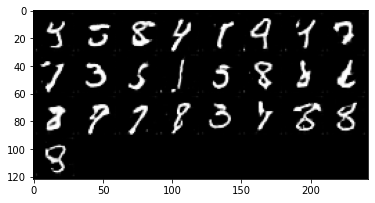

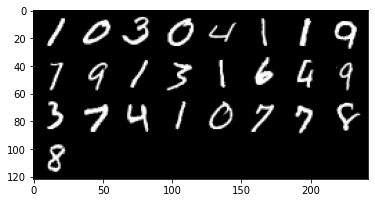

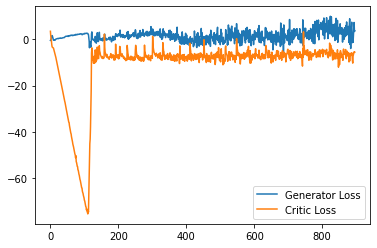

Step 18000: Generator loss: 2.6112166929990055, critic loss: -7.2607406090497975


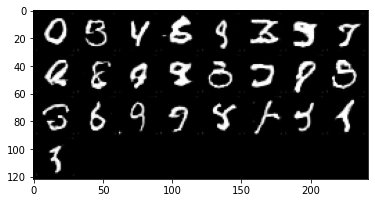

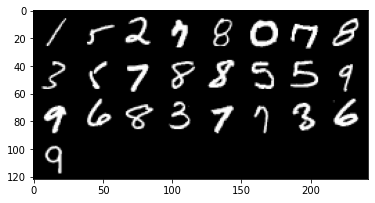

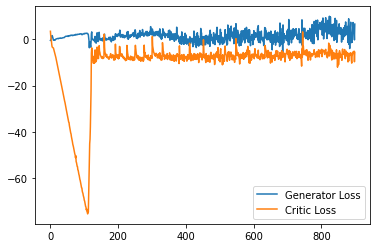

Step 18050: Generator loss: 5.323126986026764, critic loss: -8.076951062560083


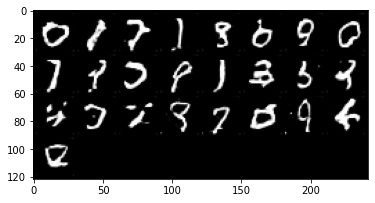

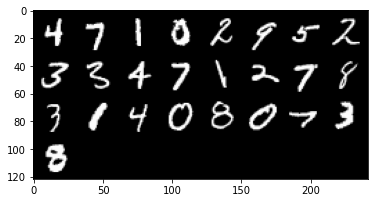

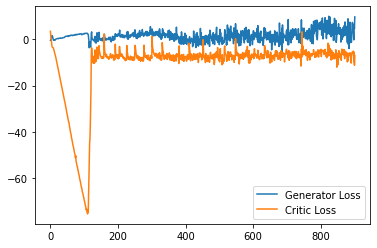

Step 18100: Generator loss: 2.638556295633316, critic loss: -6.491426981627941


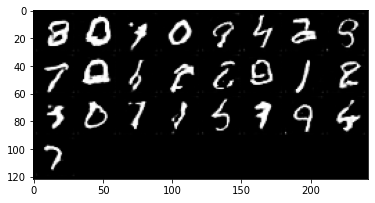

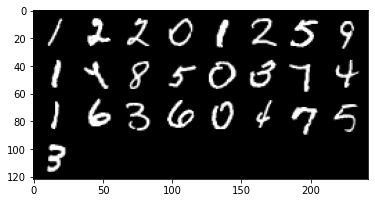

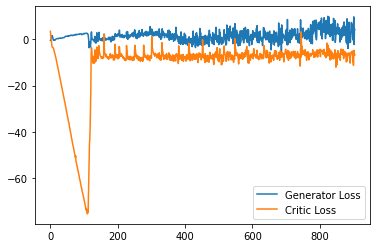

Step 18150: Generator loss: 2.2423467195034026, critic loss: -7.445128887176516


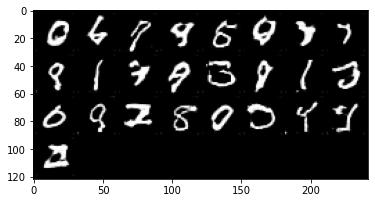

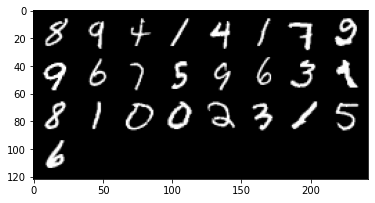

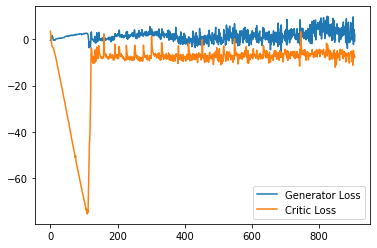

Step 18200: Generator loss: 2.2737064921855925, critic loss: -9.480327984213828


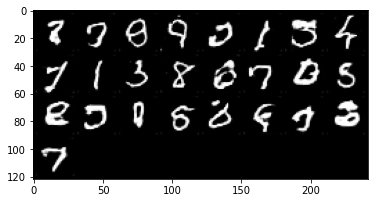

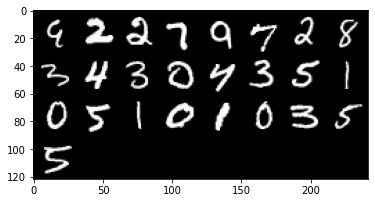

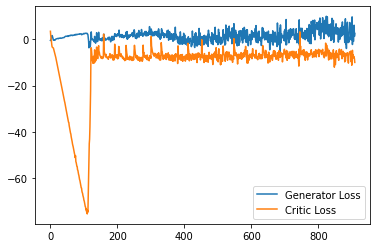

Step 18250: Generator loss: 4.19332633137703, critic loss: -5.974040702760219


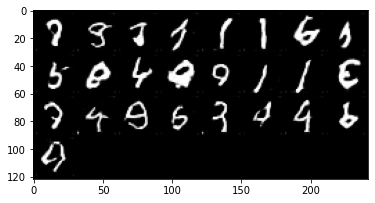

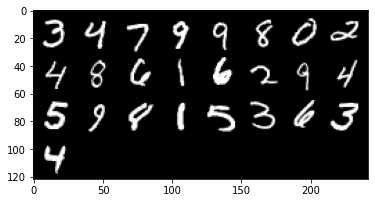

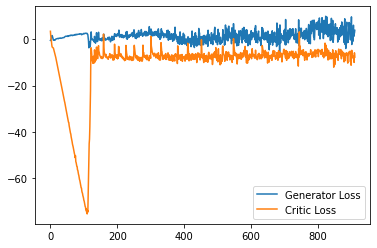

  0%|          | 0/469 [00:00<?, ?it/s]

Step 18300: Generator loss: 2.5724330127239226, critic loss: -5.933413629412651


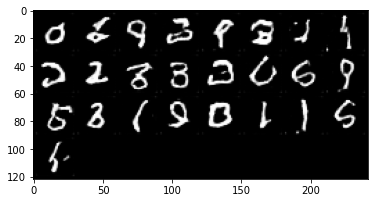

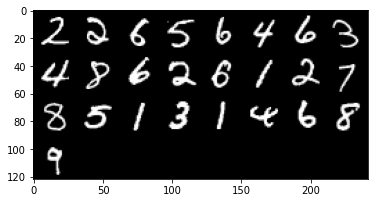

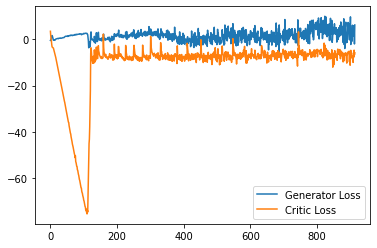

Step 18350: Generator loss: 6.210971247851848, critic loss: -5.548032361626626


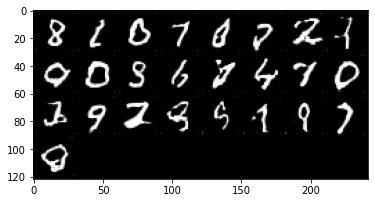

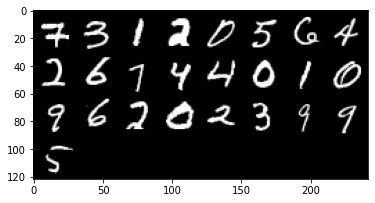

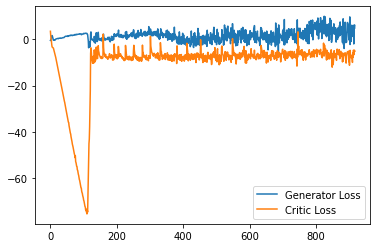

Step 18400: Generator loss: 4.641149508953094, critic loss: -5.533265972793101


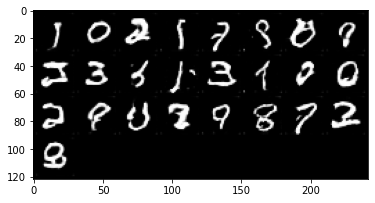

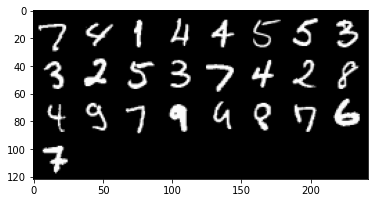

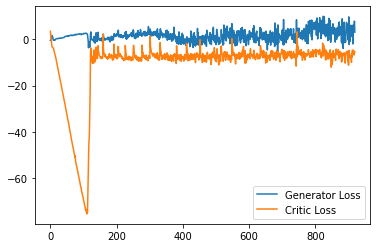

Step 18450: Generator loss: 5.787946437299252, critic loss: -6.249696594953539


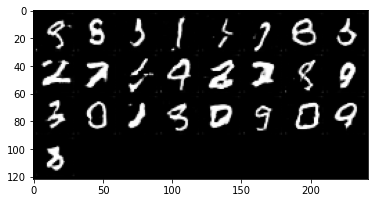

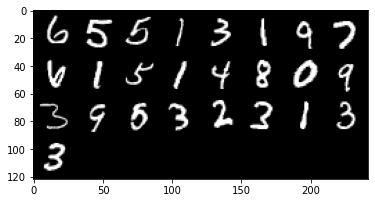

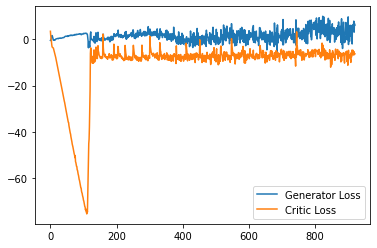

Step 18500: Generator loss: 5.0453843712806705, critic loss: -6.641030349612236


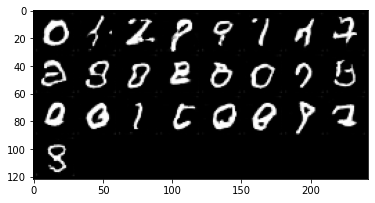

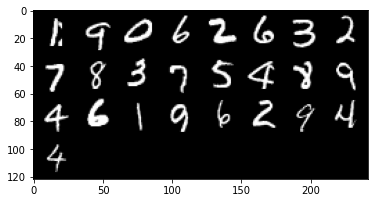

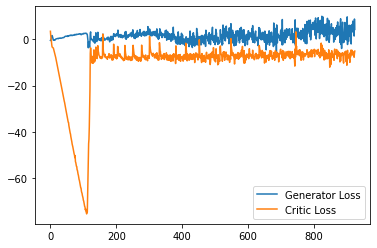

Step 18550: Generator loss: 6.25287124812603, critic loss: -4.573242618083953


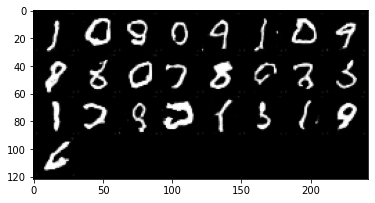

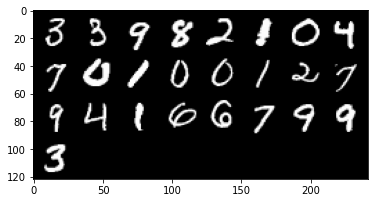

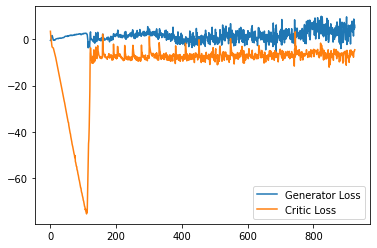

Step 18600: Generator loss: 5.148488017618656, critic loss: -5.6707901137471195


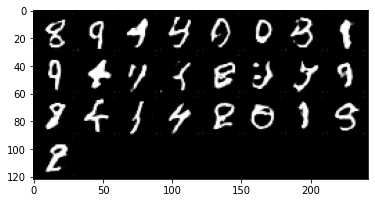

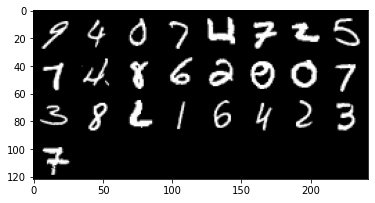

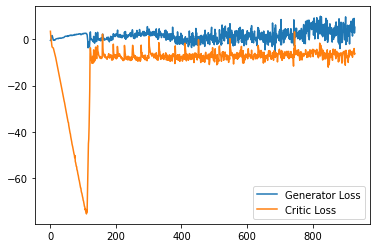

Step 18650: Generator loss: 7.9502707102894785, critic loss: -5.022609062314033


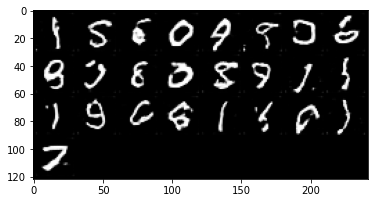

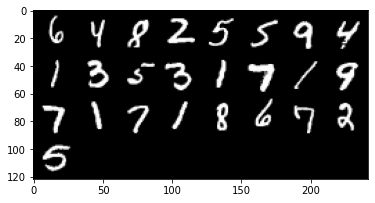

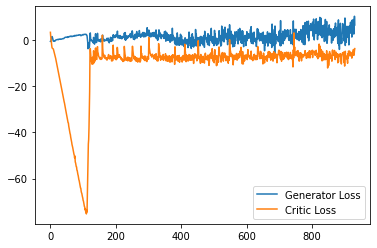

Step 18700: Generator loss: 5.035919786691665, critic loss: -5.983915679812433


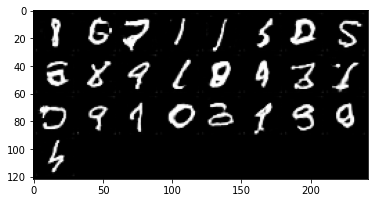

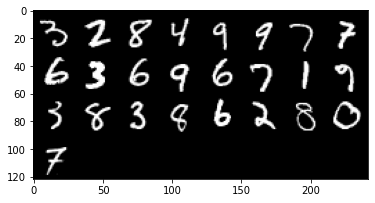

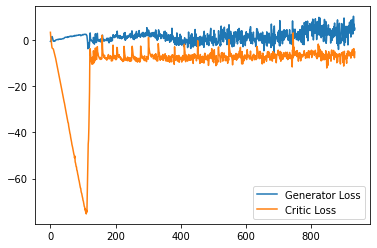

Step 18750: Generator loss: 7.700314427018165, critic loss: -5.667865640401839


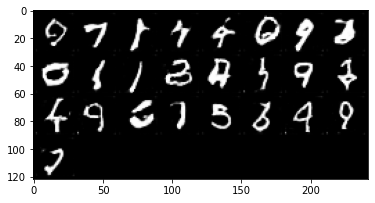

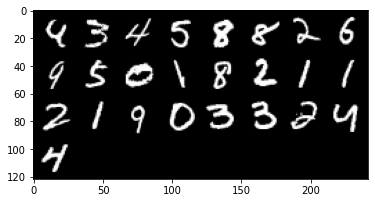

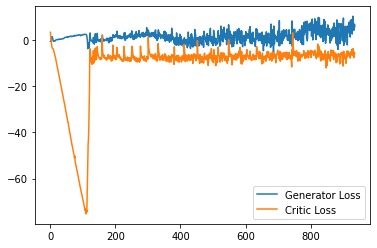

  0%|          | 0/469 [00:00<?, ?it/s]

Step 18800: Generator loss: 5.815726498961449, critic loss: -6.90892437005043


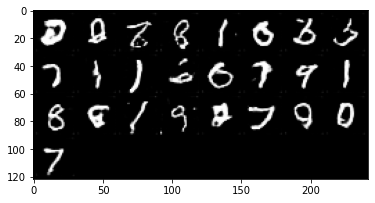

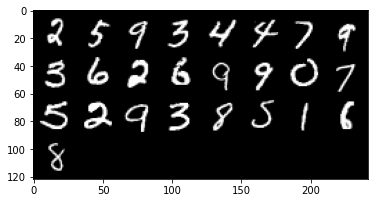

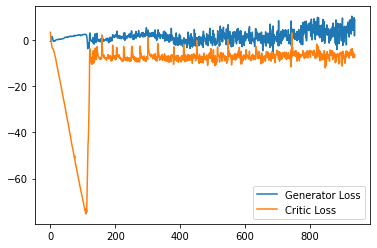

Step 18850: Generator loss: 5.586084754765034, critic loss: -5.546126318097114


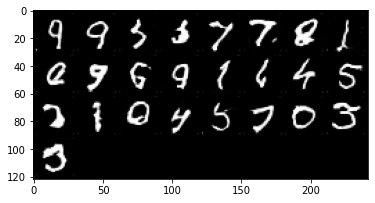

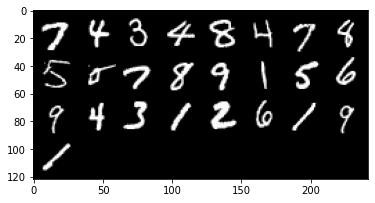

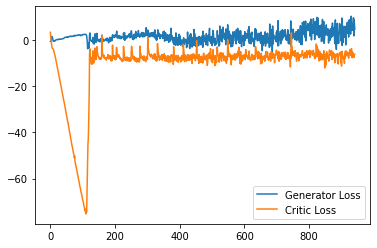

Step 18900: Generator loss: 5.4286156129837035, critic loss: -4.3245891065597535


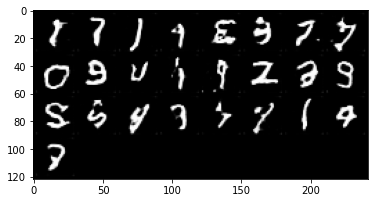

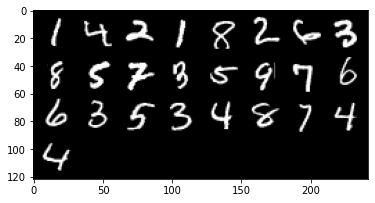

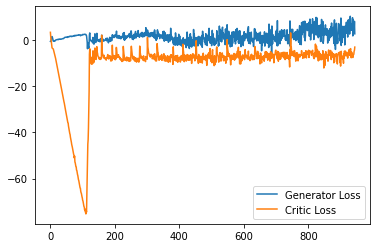

Step 18950: Generator loss: 7.709200051724911, critic loss: -3.6755728557109832


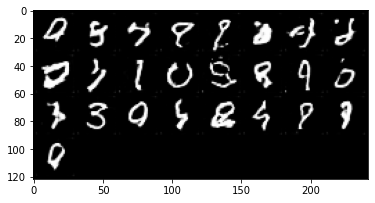

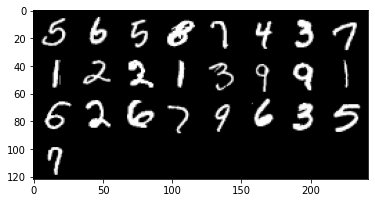

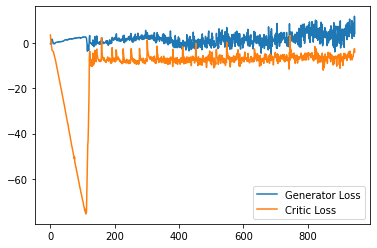

Step 19000: Generator loss: 5.548076073825359, critic loss: -6.179710461914539


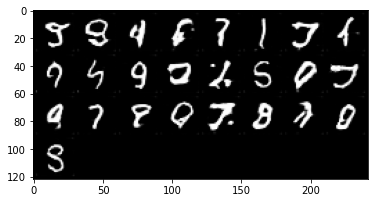

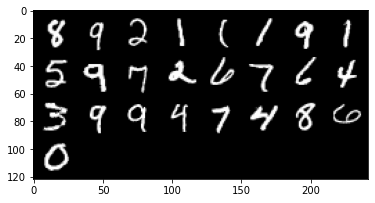

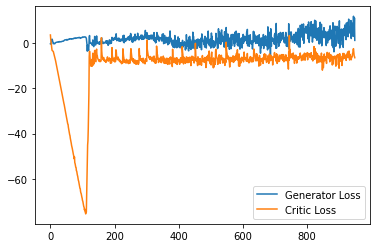

Step 19050: Generator loss: 8.032090627551078, critic loss: -7.309110160708425


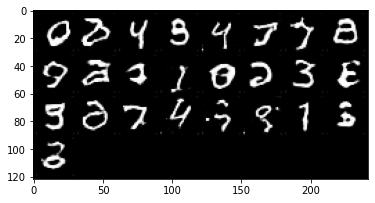

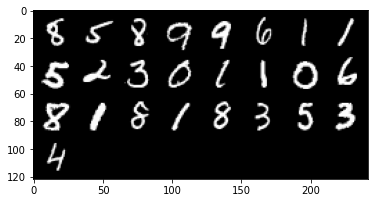

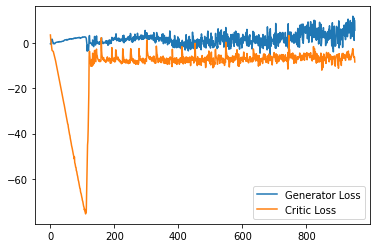

Step 19100: Generator loss: 5.020222414135933, critic loss: -6.467454753994944


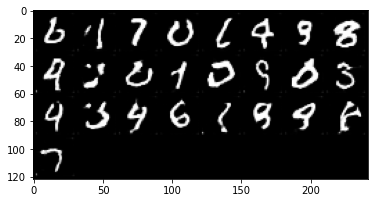

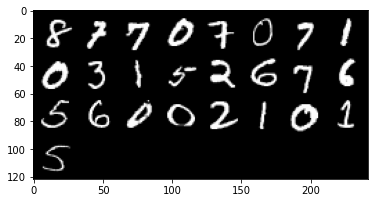

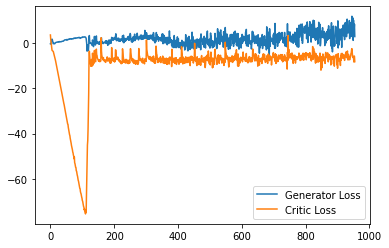

Step 19150: Generator loss: 3.9828719737380744, critic loss: -6.790090506792069


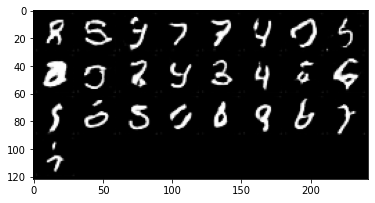

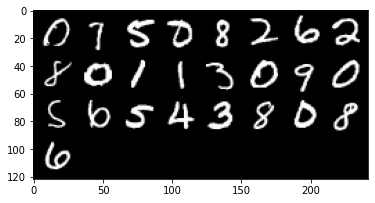

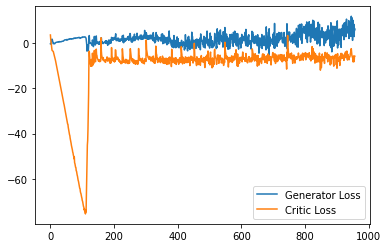

In [ ]:
import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1
